In [72]:
import numpy as np
import pandas as pd
import scipy.stats
import matplotlib.pyplot as plt
import statsmodels.api as sm
import pickle
import seaborn as sns

## d=1000, n=900 (Gaussian noise)

In [2]:
# i = 2
# k = 0
# d = 1000
# n = 900
# m_true = 0
# refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
# np.mean(abs(refit_res1['m_obs1'] - m_true))
# refit_res1

### Bias Comparisons

Scenario x0, beta0:



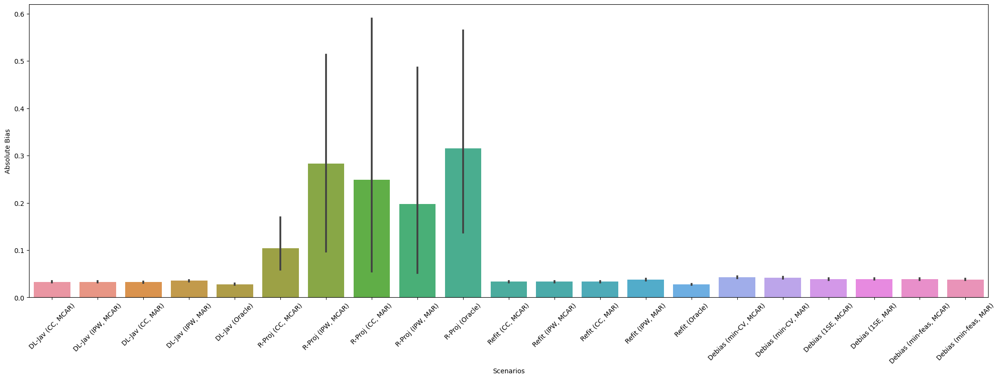

Scenario x0, beta1:



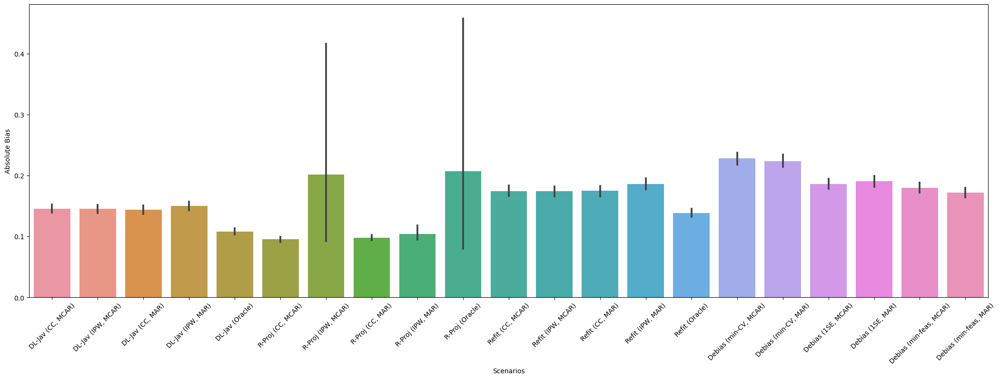

Scenario x0, beta2:



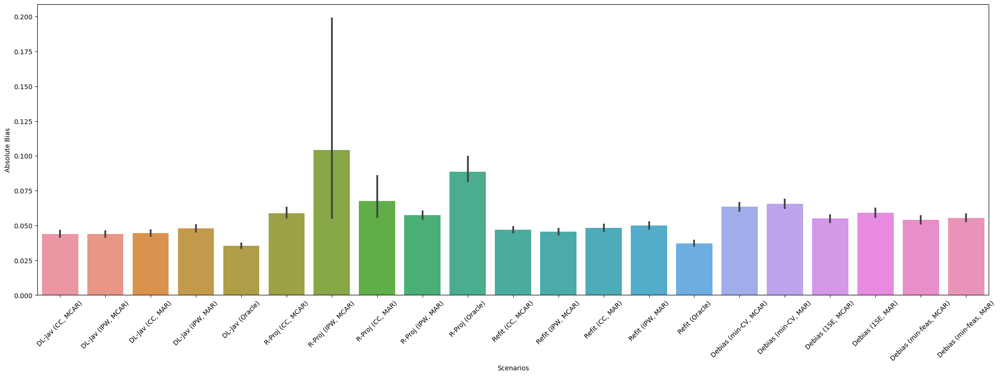

Scenario x1, beta0:



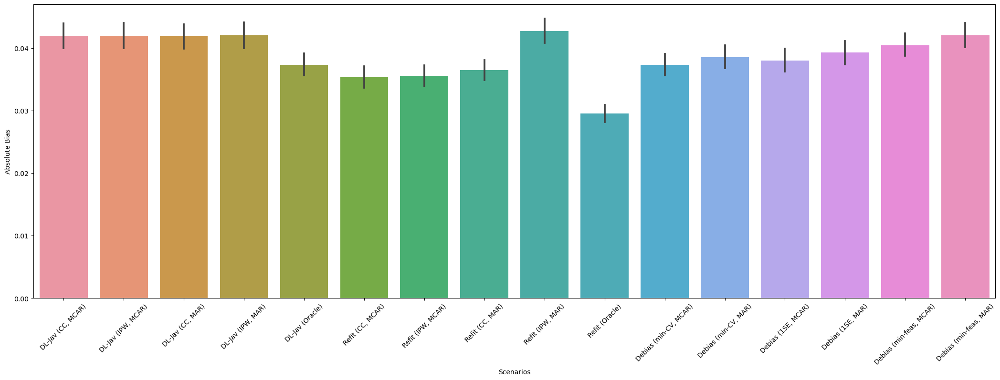

Scenario x1, beta1:



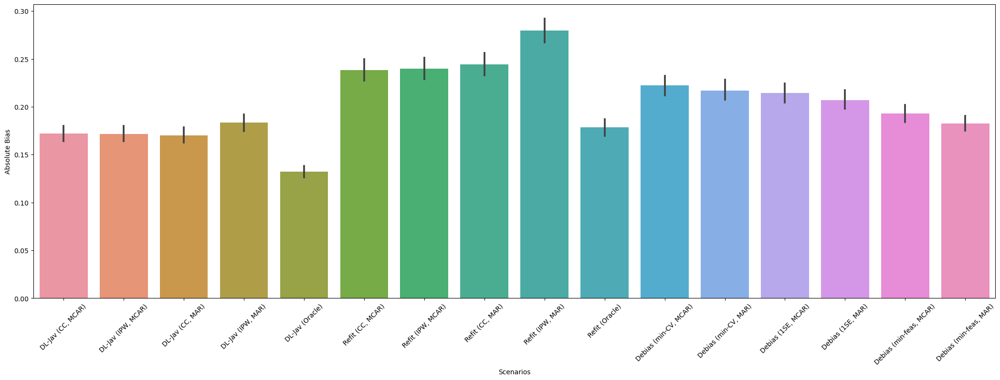

Scenario x1, beta2:



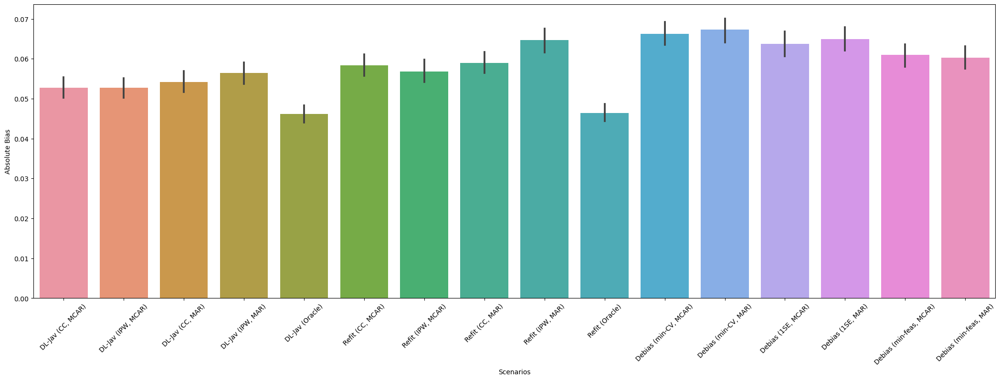

Scenario x2, beta0:



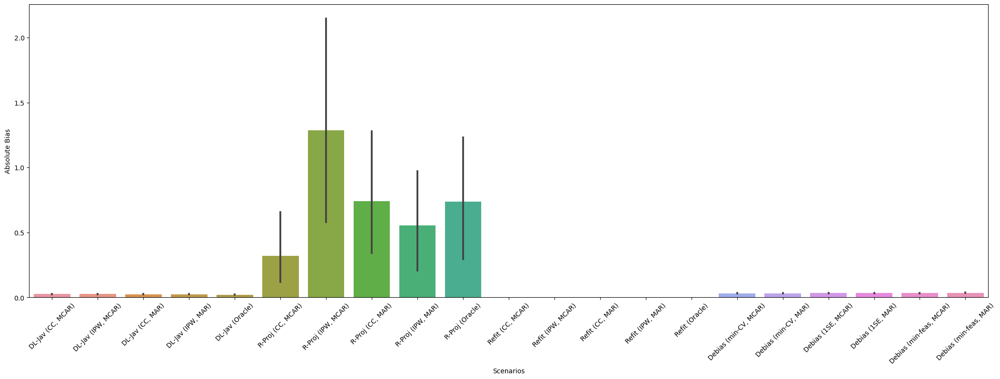

Scenario x2, beta1:



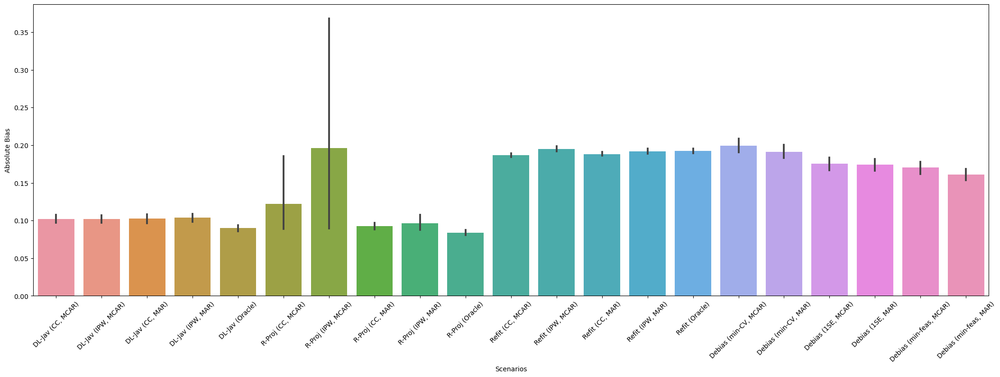

Scenario x2, beta2:



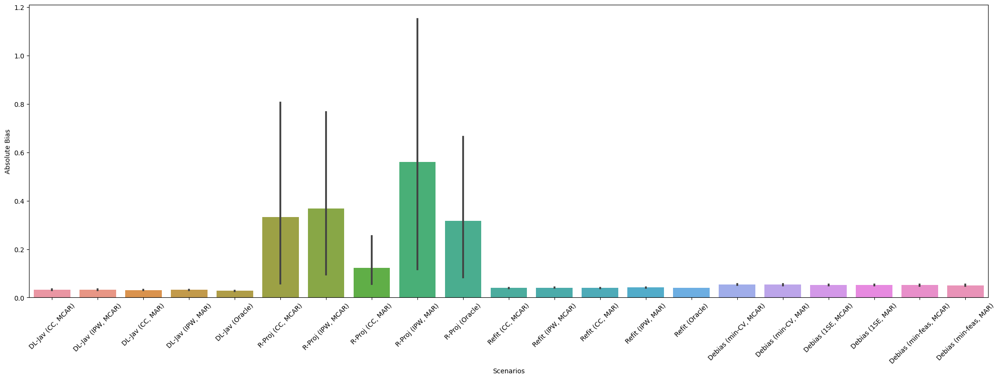

Scenario x3, beta0:



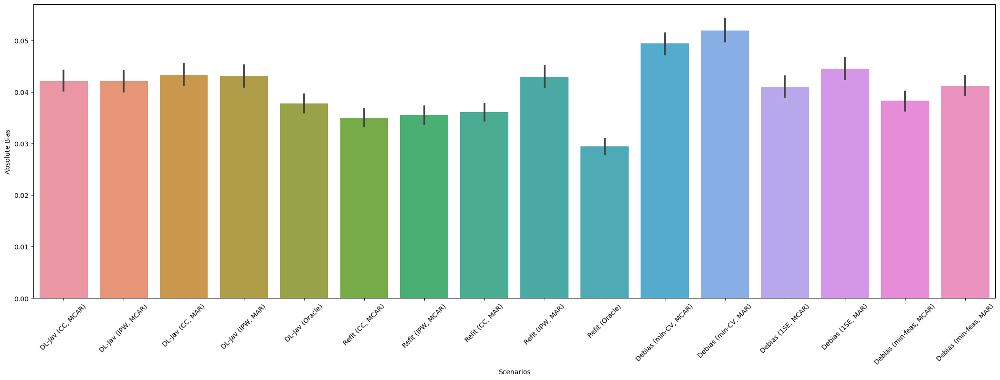

Scenario x3, beta1:



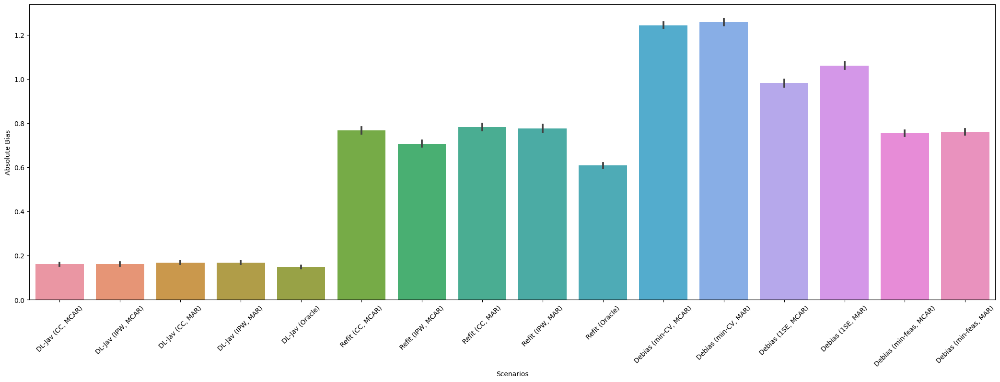

Scenario x3, beta2:



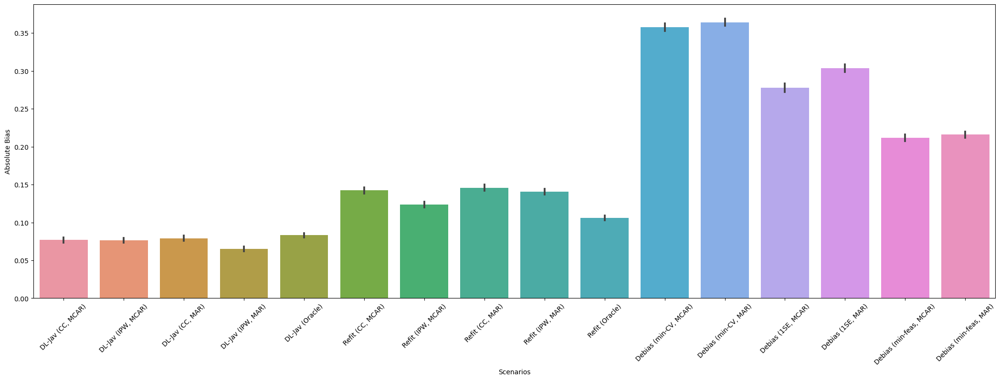

Scenario x4, beta0:



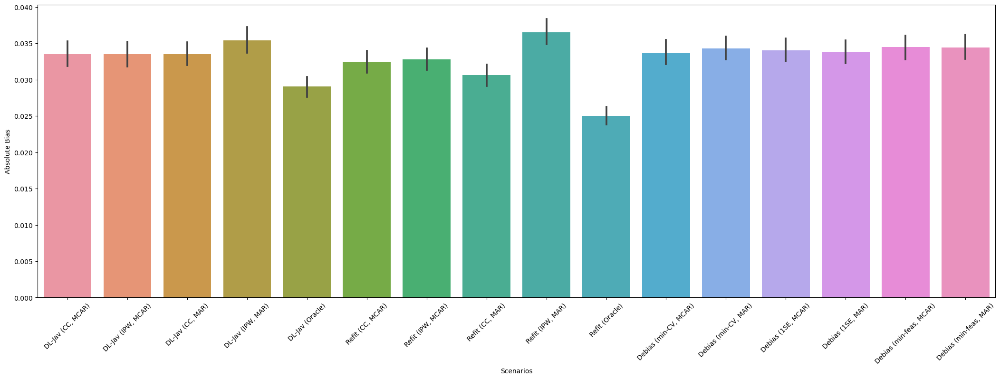

Scenario x4, beta1:



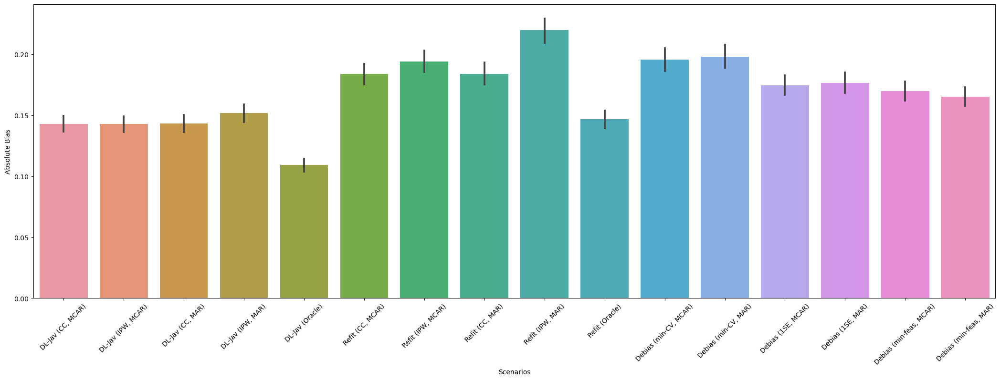

Scenario x4, beta2:



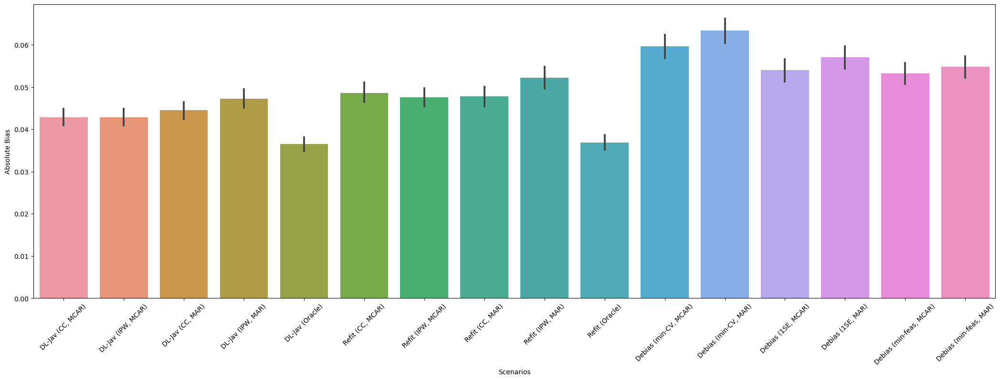

In [3]:
d = 1000
n= 900
B_repeat = 1000
for i in range(5):
    if i == 0:
        ## x0
        x = np.zeros((d,))
        x[0] = 1
    if i == 1:
        ## x1
        x = np.zeros((d,))
        x[0] = 1
        x[1] = 1/2
        x[2] = 1/4
        x[6] = 1/2
        x[7] = 1/8
    if i == 2:
        ## x2
        x = np.zeros((d,))
        x[99] = 1
    if i == 3:
        ## x3
        x = 1/np.linspace(1, d, d)
    if i == 4:
        ## x4
        x = 1/np.linspace(1, d, d)**2
    for k in range(3):
        if k == 0:
            s_beta = 5
            beta_0 = np.zeros((d,))
            beta_0[:s_beta] = np.sqrt(5)
        if k == 1:
            beta_0 = 1/np.sqrt(np.linspace(1, d, d))
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)
        if k == 2:
            beta_0 = 1/np.linspace(1, d, d)
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)

        # True regression function
        m_true = np.dot(x, beta_0)
        
        print('Scenario x'+str(i)+', beta'+str(k)+':\n')
        
        
        debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
        refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
        deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_1se.csv')
        deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_mincv.csv')
        deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_minfeas.csv')
        if (i == 0) or (i == 2):
            rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
        
        # Bias Comparisons
        ## Debiased lasso (Javanmard and Montarani, 2014)
        Bias_df = pd.DataFrame({'Absolute Bias': abs(debl_res1['m_obs1'] - m_true), 
                                'Scenarios': np.repeat('DL-Jav (CC, MCAR)', B_repeat)})
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(debl_res1['m_ipw1'] - m_true), 
                                           'Scenarios': np.repeat('DL-Jav (IPW, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(debl_res1['m_obs2'] - m_true), 
                                           'Scenarios': np.repeat('DL-Jav (CC, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(debl_res1['m_ipw2'] - m_true), 
                                           'Scenarios': np.repeat('DL-Jav (IPW, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(debl_res1['m_full'] - m_true), 
                                           'Scenarios': np.repeat('DL-Jav (Oracle)', B_repeat)})], axis=0)
        
        ## Ridge projection
        if (i == 0) or (i == 2):
            Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_obs1'] - m_true), 
                                           'Scenarios': np.repeat('R-Proj (CC, MCAR)', B_repeat)})], axis=0)
            Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_ipw1'] - m_true), 
                                           'Scenarios': np.repeat('R-Proj (IPW, MCAR)', B_repeat)})], axis=0)
            Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_obs2'] - m_true), 
                                           'Scenarios': np.repeat('R-Proj (CC, MAR)', B_repeat)})], axis=0)
            Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_ipw2'] - m_true), 
                                           'Scenarios': np.repeat('R-Proj (IPW, MAR)', B_repeat)})], axis=0)
            Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_full'] - m_true), 
                                           'Scenarios': np.repeat('R-Proj (Oracle)', B_repeat)})], axis=0)
            
        ## Lasso Refitting
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(refit_res1['m_obs1'] - m_true), 
                                           'Scenarios': np.repeat('Refit (CC, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(refit_res1['m_ipw1'] - m_true), 
                                           'Scenarios': np.repeat('Refit (IPW, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(refit_res1['m_obs2'] - m_true), 
                                           'Scenarios': np.repeat('Refit (CC, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(refit_res1['m_ipw2'] - m_true), 
                                           'Scenarios': np.repeat('Refit (IPW, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(refit_res1['m_full'] - m_true), 
                                           'Scenarios': np.repeat('Refit (Oracle)', B_repeat)})], axis=0)
        
        ## Our proposed debiasing framework
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_mincv['m_deb1'] - m_true), 
                                           'Scenarios': np.repeat('Debias (min-CV, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_mincv['m_deb2'] - m_true), 
                                           'Scenarios': np.repeat('Debias (min-CV, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_1se['m_deb1'] - m_true), 
                                           'Scenarios': np.repeat('Debias (1SE, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_1se['m_deb2'] - m_true), 
                                           'Scenarios': np.repeat('Debias (1SE, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_minfeas['m_deb1'] - m_true), 
                                           'Scenarios': np.repeat('Debias (min-feas, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_minfeas['m_deb2'] - m_true), 
                                           'Scenarios': np.repeat('Debias (min-feas, MAR)', B_repeat)})], axis=0).reset_index()
        
        plt.figure(figsize=(26, 8))
        sns.barplot(y='Absolute Bias', x='Scenarios', data=Bias_df)
        plt.xticks(rotation=45)
        plt.show()

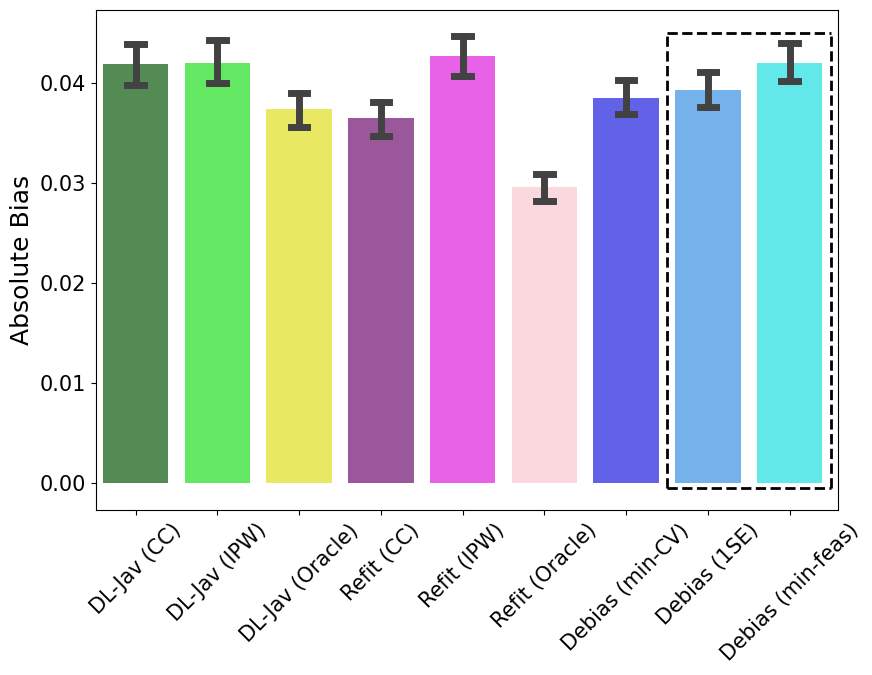

In [207]:
d = 1000
n = 900
B_repeat = 1000
i = 1
k = 0
## x1
x = np.zeros((d,))
x[0] = 1
x[1] = 1/2
x[2] = 1/4
x[6] = 1/2
x[7] = 1/8

s_beta = 5
beta_0 = np.zeros((d,))
beta_0[:s_beta] = np.sqrt(5)

# True regression function
m_true = np.dot(x, beta_0)

debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_1se.csv')
deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_mincv.csv')
deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_minfeas.csv')
if (i == 0) or (i == 2):
    rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')

# Bias Comparisons
## Debiased lasso (Javanmard and Montarani, 2014) MAR
Bias_df = pd.DataFrame({'Absolute Bias': abs(debl_res1['m_obs2'] - m_true), 
                        'Scenarios': np.repeat('DL-Jav (CC)', B_repeat)})
Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(debl_res1['m_ipw2'] - m_true), 
                                   'Scenarios': np.repeat('DL-Jav (IPW)', B_repeat)})], axis=0)
Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(debl_res1['m_full'] - m_true), 
                                   'Scenarios': np.repeat('DL-Jav (Oracle)', B_repeat)})], axis=0)

## Ridge projection MAR
if (i == 0) or (i == 2):
    Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_obs2'] - m_true), 
                                   'Scenarios': np.repeat('R-Proj (CC)', B_repeat)})], axis=0)
    Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_ipw2'] - m_true), 
                                   'Scenarios': np.repeat('R-Proj (IPW)', B_repeat)})], axis=0)
    Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_full'] - m_true), 
                                   'Scenarios': np.repeat('R-Proj (Oracle)', B_repeat)})], axis=0)
    
## Lasso Refitting MAR
Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(refit_res1['m_obs2'] - m_true), 
                                   'Scenarios': np.repeat('Refit (CC)', B_repeat)})], axis=0)
Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(refit_res1['m_ipw2'] - m_true), 
                                   'Scenarios': np.repeat('Refit (IPW)', B_repeat)})], axis=0)
Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(refit_res1['m_full'] - m_true), 
                                   'Scenarios': np.repeat('Refit (Oracle)', B_repeat)})], axis=0)

## Our proposed debiasing framework MAR
Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(deb_est_mincv['m_deb2'] - m_true), 
                                   'Scenarios': np.repeat('Debias (min-CV)', B_repeat)})], axis=0)
Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(deb_est_1se['m_deb2'] - m_true), 
                                   'Scenarios': np.repeat('Debias (1SE)', B_repeat)})], axis=0)
Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(deb_est_minfeas['m_deb2'] - m_true), 
                                   'Scenarios': np.repeat('Debias (min-feas)', B_repeat)})], axis=0).reset_index()


colors = ['darkgreen', 'lime', 'yellow', 'purple', 'magenta', 'pink', 'blue', 'dodgerblue', 'cyan']
# 'oldlace', 'orange', 'darkorange'
col_pal = dict(zip(list(Bias_df['Scenarios'].unique()), colors))


plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(9, 7))
sns.barplot(y='Absolute Bias', x='Scenarios', data=Bias_df, palette=col_pal, alpha=0.7,
            capsize=.2, linewidth=8, errwidth=5)
plt.xlabel('')
plt.xticks(rotation=45)
plt.ylabel('Absolute Bias', size=18)
# plt.yticks(size=18)

refy2 = [-0.0005, 0.045]
refx2 = [6.5, 8.5]
plt.hlines(refy2, xmin=refx2[0], xmax=refx2[1], color='black', linestyles='--', linewidth=2)
plt.vlines(refx2, ymin=refy2[0], ymax=refy2[1], color='black', linestyles='--', linewidth=2)
plt.margins(x=0.01)
plt.tight_layout()
plt.savefig('./Figures/cirsym_abs_bias_x'+str(i)+'_beta'+str(k)+'.pdf', bbox_inches='tight')

### Coverage Probability

Scenario x0, beta0:



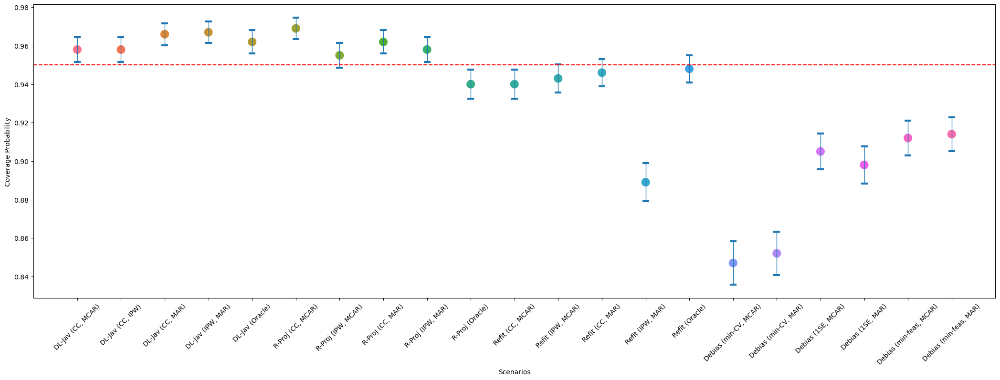

Scenario x0, beta1:



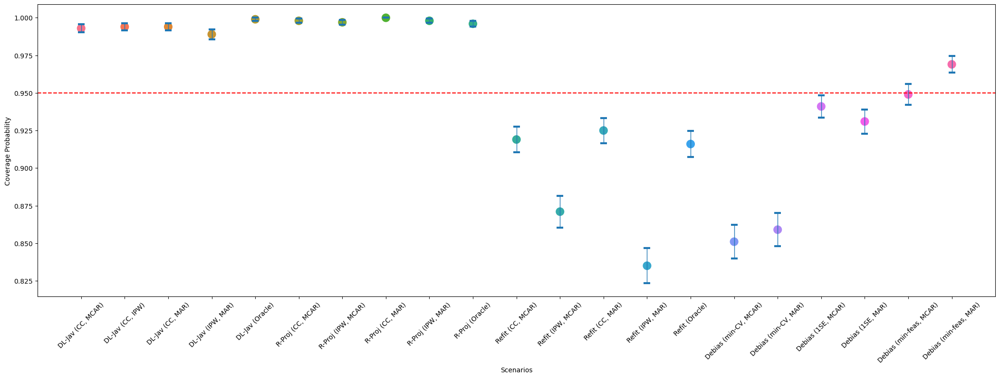

Scenario x0, beta2:



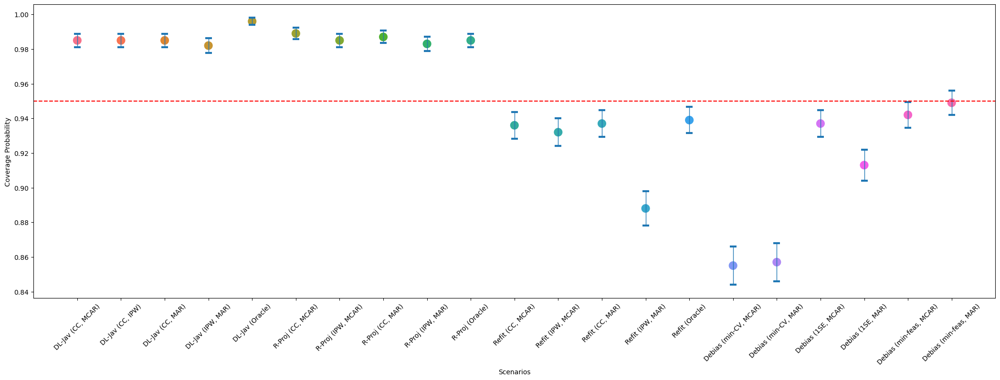

Scenario x1, beta0:



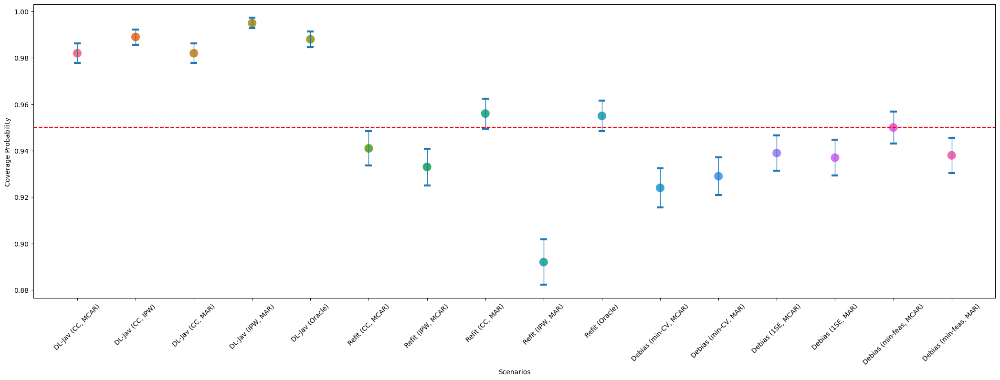

Scenario x1, beta1:



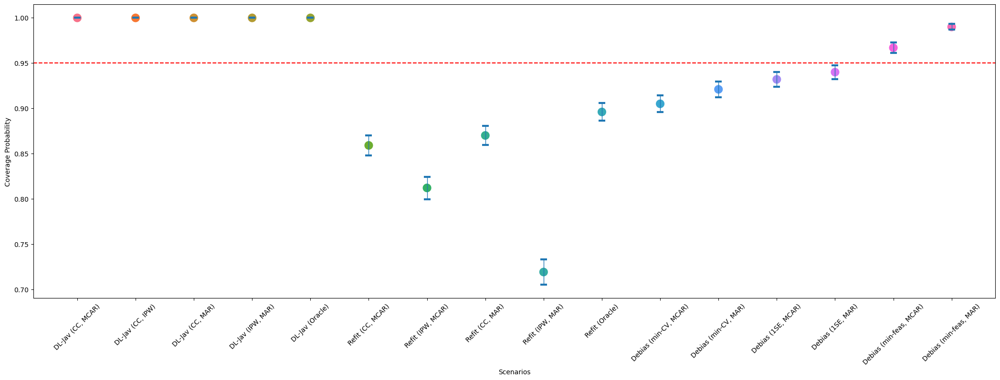

Scenario x1, beta2:



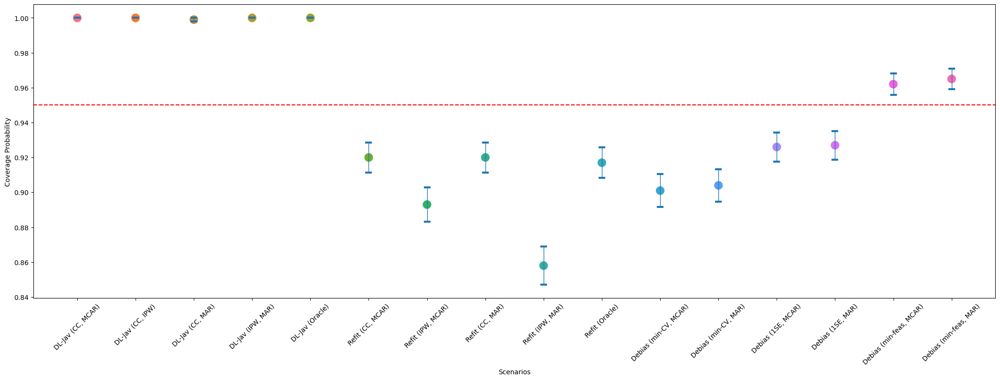

Scenario x2, beta0:



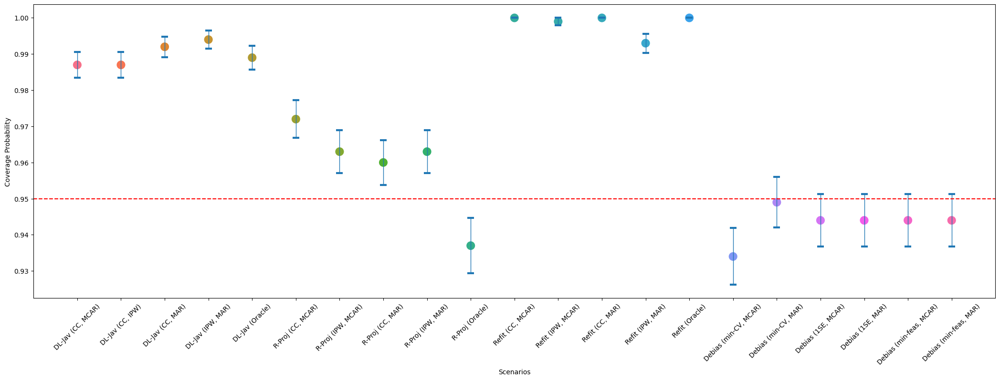

Scenario x2, beta1:



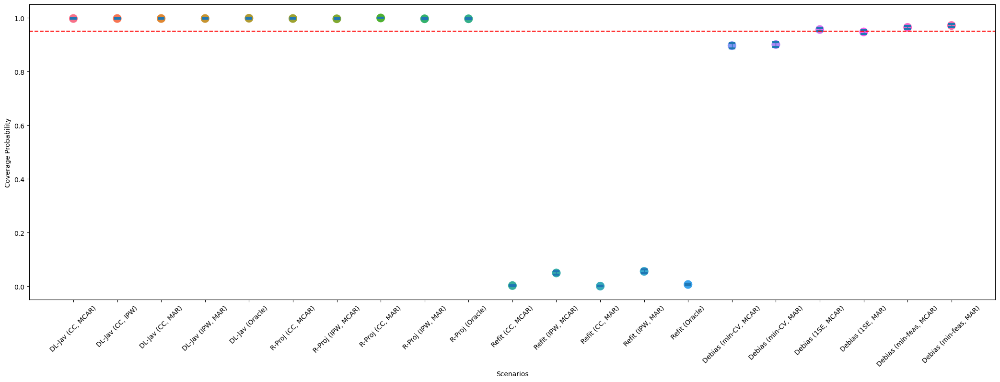

Scenario x2, beta2:



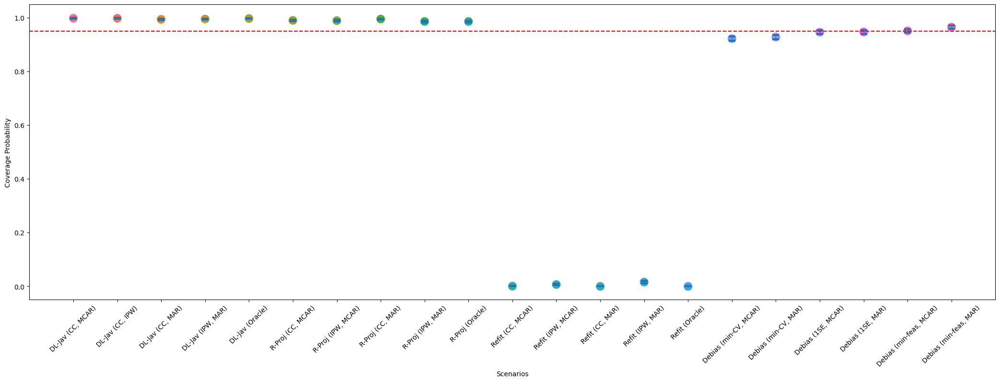

Scenario x3, beta0:



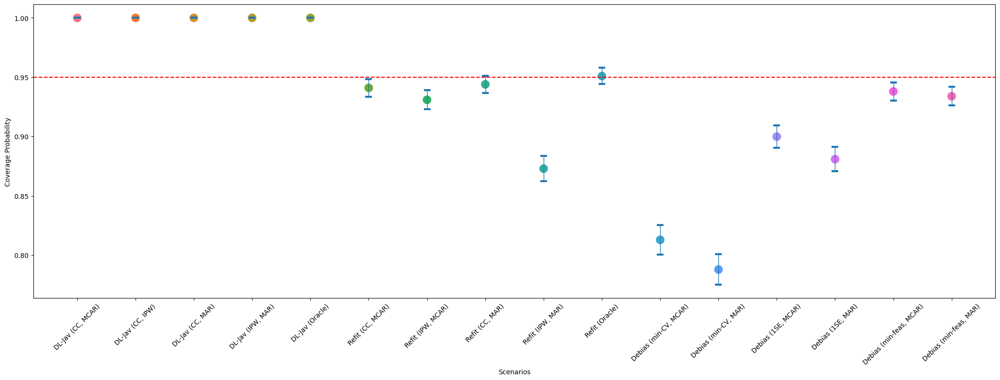

Scenario x3, beta1:



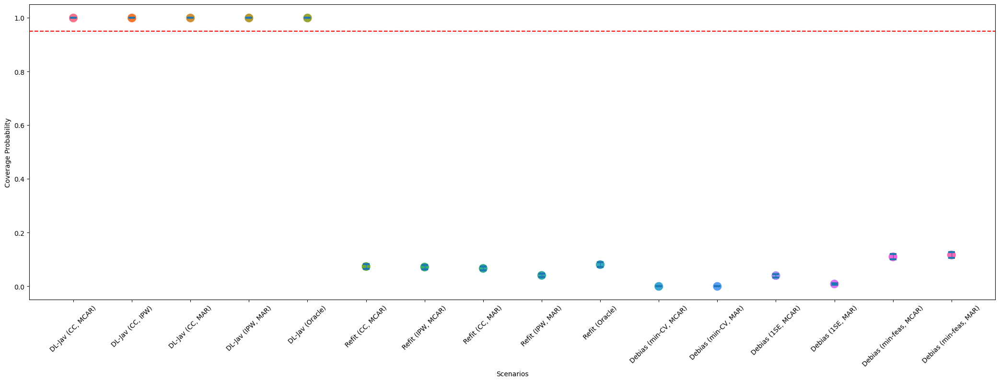

Scenario x3, beta2:



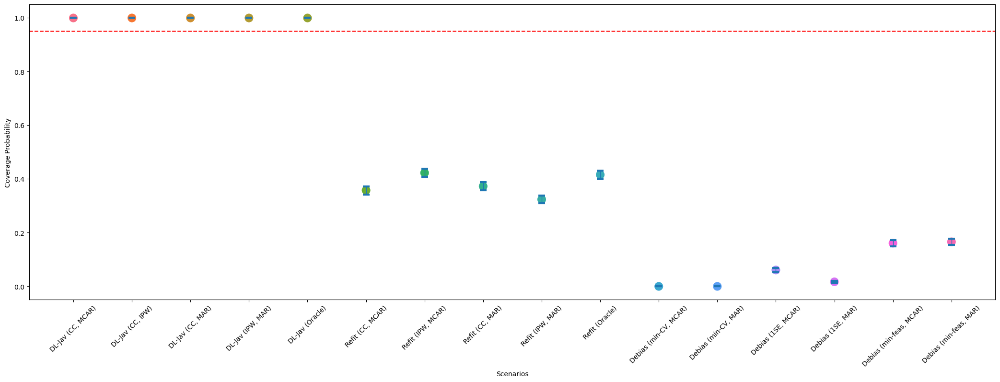

Scenario x4, beta0:



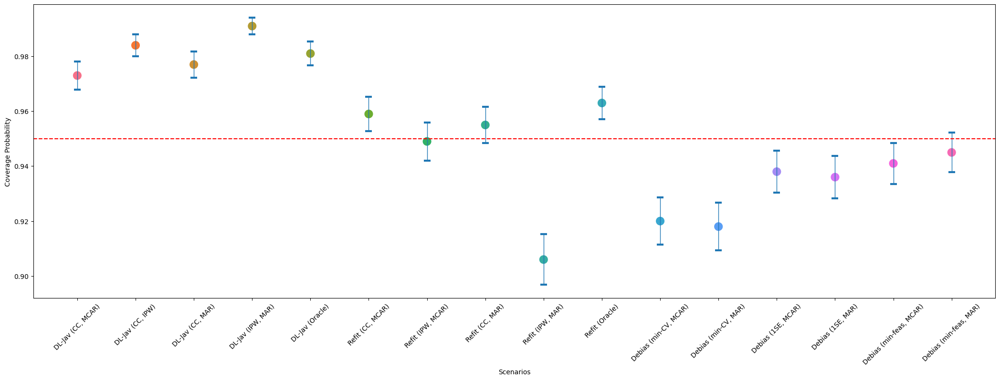

Scenario x4, beta1:



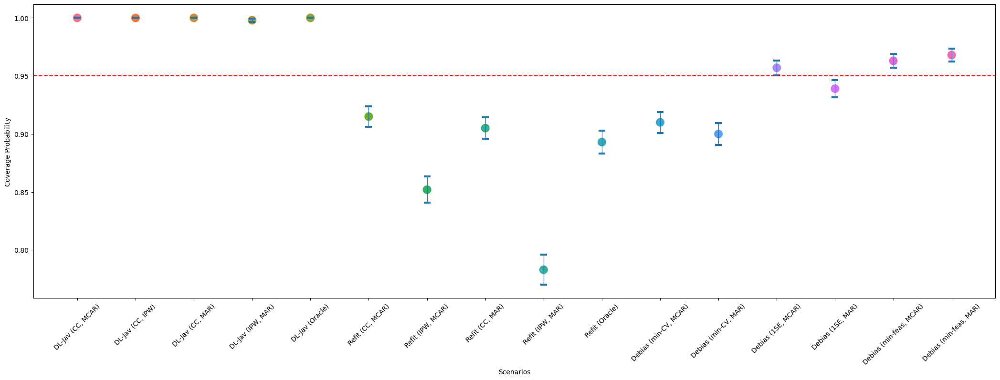

Scenario x4, beta2:



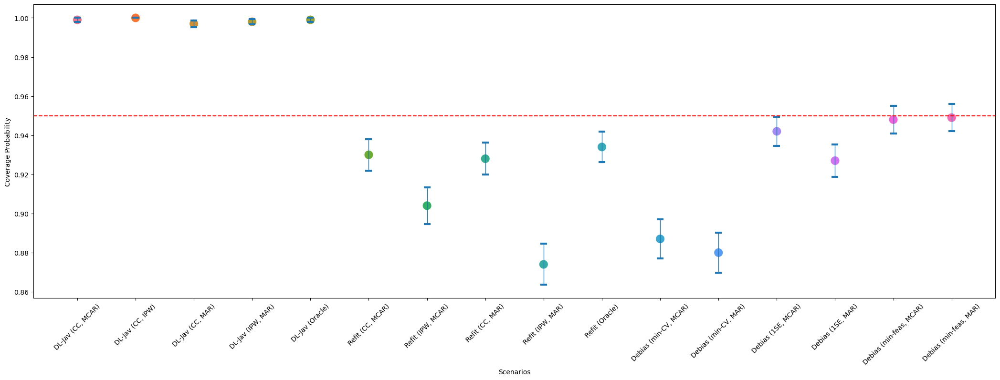

In [4]:
d = 1000
n= 900
B_repeat = 1000
for i in range(5):
    if i == 0:
        ## x0
        x = np.zeros((d,))
        x[0] = 1
    if i == 1:
        ## x1
        x = np.zeros((d,))
        x[0] = 1
        x[1] = 1/2
        x[2] = 1/4
        x[6] = 1/2
        x[7] = 1/8
    if i == 2:
        ## x2
        x = np.zeros((d,))
        x[99] = 1
    if i == 3:
        ## x3
        x = 1/np.linspace(1, d, d)
    if i == 4:
        ## x4
        x = 1/np.linspace(1, d, d)**2
    for k in range(3):
        if k == 0:
            s_beta = 5
            beta_0 = np.zeros((d,))
            beta_0[:s_beta] = np.sqrt(5)
        if k == 1:
            beta_0 = 1/np.sqrt(np.linspace(1, d, d))
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)
        if k == 2:
            beta_0 = 1/np.linspace(1, d, d)
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)

        # True regression function
        m_true = np.dot(x, beta_0)
        
        print('Scenario x'+str(i)+', beta'+str(k)+':\n')
        
        
        debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
        refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
        deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_1se.csv')
        deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_mincv.csv')
        deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_minfeas.csv')
        if (i == 0) or (i == 2):
            rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
        
        
        # Coverage Probability
        ## Debiased lasso (Javanmard and Montarani, 2014)
        cov_prob = (debl_res1['m_obs1'] + debl_res1['ci_len_obs1']/2 >= m_true) & \
        (debl_res1['m_obs1'] - debl_res1['ci_len_obs1']/2 <= m_true)
        Cov_prob1 = pd.DataFrame({'Scenarios': ['DL-Jav (CC, MCAR)'], 
                                  'Coverage Probability': [np.mean(cov_prob)], 
                                  'Std': [np.std(cov_prob)], 
                                  'StdErr': [np.std(cov_prob)/np.sqrt(1000)]})
        
        cov_prob = (debl_res1['m_ipw1'] + debl_res1['ci_len_ipw1']/2 >= m_true) & \
        (debl_res1['m_ipw1'] - debl_res1['ci_len_ipw1']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['DL-Jav (CC, IPW)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (debl_res1['m_obs2'] + debl_res1['ci_len_obs2']/2 >= m_true) & \
        (debl_res1['m_obs2'] - debl_res1['ci_len_obs2']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['DL-Jav (CC, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (debl_res1['m_ipw2'] + debl_res1['ci_len_ipw2']/2 >= m_true) & \
        (debl_res1['m_ipw2'] - debl_res1['ci_len_ipw2']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['DL-Jav (IPW, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (debl_res1['m_full'] + debl_res1['ci_len_full']/2 >= m_true) & \
        (debl_res1['m_full'] - debl_res1['ci_len_full']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['DL-Jav (Oracle)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        ## Ridge projection
        if (i == 0) or (i == 2):
            cov_prob = (rproj_res1['m_obs1'] + rproj_res1['ci_len_obs1']/2 >= m_true) & \
            (rproj_res1['m_obs1'] - rproj_res1['ci_len_obs1']/2 <= m_true)
            Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (CC, MCAR)', np.mean(cov_prob), 
                                                   np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
            
            cov_prob = (rproj_res1['m_ipw1'] + rproj_res1['ci_len_ipw1']/2 >= m_true) & \
            (rproj_res1['m_ipw1'] - rproj_res1['ci_len_ipw1']/2 <= m_true)
            Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (IPW, MCAR)', np.mean(cov_prob), 
                                                   np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
            
            cov_prob = (rproj_res1['m_obs2'] + rproj_res1['ci_len_obs2']/2 >= m_true) & \
            (rproj_res1['m_obs2'] - rproj_res1['ci_len_obs2']/2 <= m_true)
            Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (CC, MAR)', np.mean(cov_prob), 
                                                   np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
            
            cov_prob = (rproj_res1['m_ipw2'] + rproj_res1['ci_len_ipw2']/2 >= m_true) & \
            (rproj_res1['m_ipw2'] - rproj_res1['ci_len_ipw2']/2 <= m_true)
            Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (IPW, MAR)', np.mean(cov_prob), 
                                                   np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
            
            cov_prob = (rproj_res1['m_full'] + rproj_res1['ci_len_full']/2 >= m_true) & \
            (rproj_res1['m_full'] - rproj_res1['ci_len_full']/2 <= m_true)
            Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (Oracle)', np.mean(cov_prob), 
                                                   np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        ## Lasso refitting
        cov_prob = (refit_res1['m_obs1'] + refit_res1['ci_len_obs1']/2 >= m_true) & \
        (refit_res1['m_obs1'] - refit_res1['ci_len_obs1']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (CC, MCAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (refit_res1['m_ipw1'] + refit_res1['ci_len_ipw1']/2 >= m_true) & \
        (refit_res1['m_ipw1'] - refit_res1['ci_len_ipw1']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (IPW, MCAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (refit_res1['m_obs2'] + refit_res1['ci_len_obs2']/2 >= m_true) & \
        (refit_res1['m_obs2'] - refit_res1['ci_len_obs2']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (CC, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (refit_res1['m_ipw2'] + refit_res1['ci_len_ipw2']/2 >= m_true) & \
        (refit_res1['m_ipw2'] - refit_res1['ci_len_ipw2']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (IPW, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (refit_res1['m_full'] + refit_res1['ci_len_full']/2 >= m_true) & \
        (refit_res1['m_full'] - refit_res1['ci_len_full']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (Oracle)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        # Proposed framework   
        cov_prob = (deb_est_mincv['m_deb1'] + deb_est_mincv['asym_se1']*deb_est_mincv['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_mincv['m_deb1'] - deb_est_mincv['asym_se1']*deb_est_mincv['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (min-CV, MCAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (deb_est_mincv['m_deb2'] + deb_est_mincv['asym_se2']*deb_est_mincv['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_mincv['m_deb2'] - deb_est_mincv['asym_se2']*deb_est_mincv['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (min-CV, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (deb_est_1se['m_deb1'] + deb_est_1se['asym_se1']*deb_est_1se['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_1se['m_deb1'] - deb_est_1se['asym_se1']*deb_est_1se['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (1SE, MCAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (deb_est_1se['m_deb2'] + deb_est_1se['asym_se2']*deb_est_1se['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_1se['m_deb2'] - deb_est_1se['asym_se2']*deb_est_1se['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (1SE, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (deb_est_minfeas['m_deb1'] + deb_est_minfeas['asym_se1']*deb_est_minfeas['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_minfeas['m_deb1'] - deb_est_minfeas['asym_se1']*deb_est_minfeas['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (min-feas, MCAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (deb_est_minfeas['m_deb2'] + deb_est_minfeas['asym_se2']*deb_est_minfeas['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_minfeas['m_deb2'] - deb_est_minfeas['asym_se2']*deb_est_minfeas['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (min-feas, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        plt.figure(figsize=(26,8))
        sns.scatterplot(x='Scenarios', y='Coverage Probability', data=Cov_prob1, hue='Scenarios', 
                        s=200, legend=False)
        # sns.pointplot(x='Scenarios', y='Coverage Probability', errorbar='sd', data=Cov_prob1, hue='Scenarios')
        # plt.scatter(Cov_prob1['Scenarios'], Cov_prob1['Coverage Probability'])
        plt.errorbar(Cov_prob1['Scenarios'], Cov_prob1['Coverage Probability'], 
                     yerr=Cov_prob1['StdErr'], ls='none', capsize=5, elinewidth=1, capthick=3)
        plt.axhline(y=0.95, color='red', linestyle='dashed')
        plt.xticks(rotation=45)
        plt.show()

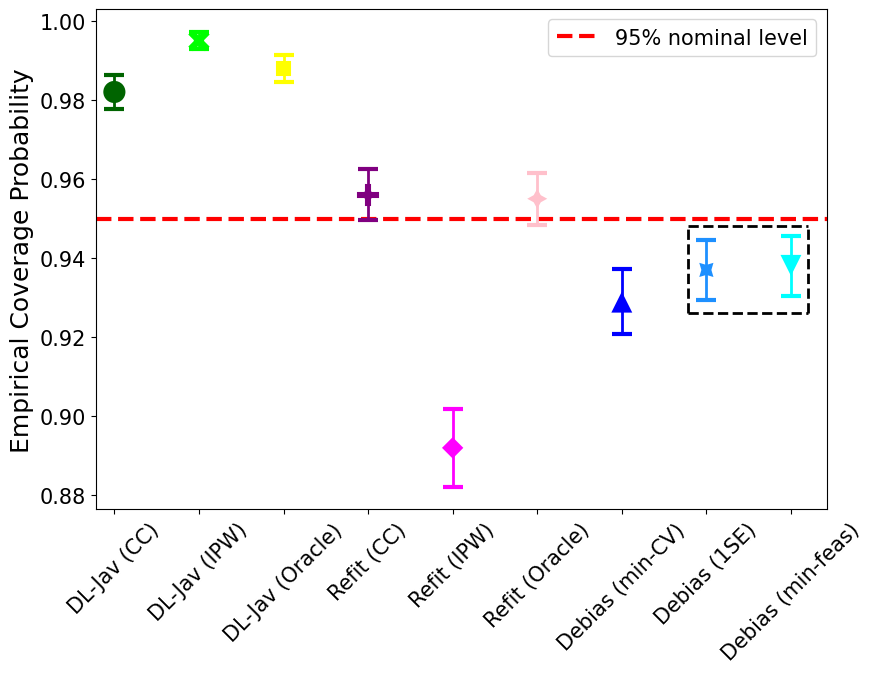

In [214]:
d = 1000
n = 900
B_repeat = 1000
i = 1
k = 0
## x1
x = np.zeros((d,))
x[0] = 1
x[1] = 1/2
x[2] = 1/4
x[6] = 1/2
x[7] = 1/8

s_beta = 5
beta_0 = np.zeros((d,))
beta_0[:s_beta] = np.sqrt(5)

# True regression function
m_true = np.dot(x, beta_0)

debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_1se.csv')
deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_mincv.csv')
deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_minfeas.csv')
if (i == 0) or (i == 2):
    rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
    
# Coverage Probability
## Debiased lasso (Javanmard and Montarani, 2014) MAR
cov_prob = (debl_res1['m_obs2'] + debl_res1['ci_len_obs2']/2 >= m_true) & \
(debl_res1['m_obs2'] - debl_res1['ci_len_obs2']/2 <= m_true)
Cov_prob1 = pd.DataFrame({'Scenarios': ['DL-Jav (CC)'], 
                          'Coverage Probability': [np.mean(cov_prob)], 
                          'Std': [np.std(cov_prob)], 
                          'StdErr': [np.std(cov_prob)/np.sqrt(1000)]})

cov_prob = (debl_res1['m_ipw2'] + debl_res1['ci_len_ipw2']/2 >= m_true) & \
(debl_res1['m_ipw2'] - debl_res1['ci_len_ipw2']/2 <= m_true)
Cov_prob1.loc[len(Cov_prob1.index)] = ['DL-Jav (IPW)', np.mean(cov_prob), 
                                       np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]

cov_prob = (debl_res1['m_full'] + debl_res1['ci_len_full']/2 >= m_true) & \
(debl_res1['m_full'] - debl_res1['ci_len_full']/2 <= m_true)
Cov_prob1.loc[len(Cov_prob1.index)] = ['DL-Jav (Oracle)', np.mean(cov_prob), 
                                       np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]

## Ridge projection MAR
if (i == 0) or (i == 2):
    cov_prob = (rproj_res1['m_obs2'] + rproj_res1['ci_len_obs2']/2 >= m_true) & \
    (rproj_res1['m_obs2'] - rproj_res1['ci_len_obs2']/2 <= m_true)
    Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (CC)', np.mean(cov_prob), 
                                           np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
    
    cov_prob = (rproj_res1['m_ipw2'] + rproj_res1['ci_len_ipw2']/2 >= m_true) & \
    (rproj_res1['m_ipw2'] - rproj_res1['ci_len_ipw2']/2 <= m_true)
    Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (IPW)', np.mean(cov_prob), 
                                           np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
    
    cov_prob = (rproj_res1['m_full'] + rproj_res1['ci_len_full']/2 >= m_true) & \
    (rproj_res1['m_full'] - rproj_res1['ci_len_full']/2 <= m_true)
    Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (Oracle)', np.mean(cov_prob), 
                                           np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]

## Lasso refitting MAR
cov_prob = (refit_res1['m_obs2'] + refit_res1['ci_len_obs2']/2 >= m_true) & \
(refit_res1['m_obs2'] - refit_res1['ci_len_obs2']/2 <= m_true)
Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (CC)', np.mean(cov_prob), 
                                       np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]

cov_prob = (refit_res1['m_ipw2'] + refit_res1['ci_len_ipw2']/2 >= m_true) & \
(refit_res1['m_ipw2'] - refit_res1['ci_len_ipw2']/2 <= m_true)
Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (IPW)', np.mean(cov_prob), 
                                       np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]

cov_prob = (refit_res1['m_full'] + refit_res1['ci_len_full']/2 >= m_true) & \
(refit_res1['m_full'] - refit_res1['ci_len_full']/2 <= m_true)
Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (Oracle)', np.mean(cov_prob), 
                                       np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]

# Proposed framework  MAR 
cov_prob = (deb_est_mincv['m_deb2'] + deb_est_mincv['asym_se2']*deb_est_mincv['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
(deb_est_mincv['m_deb2'] - deb_est_mincv['asym_se2']*deb_est_mincv['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (min-CV)', np.mean(cov_prob), 
                                       np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]

cov_prob = (deb_est_1se['m_deb2'] + deb_est_1se['asym_se2']*deb_est_1se['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
(deb_est_1se['m_deb2'] - deb_est_1se['asym_se2']*deb_est_1se['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (1SE)', np.mean(cov_prob), 
                                       np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]

cov_prob = (deb_est_minfeas['m_deb2'] + deb_est_minfeas['asym_se2']*deb_est_minfeas['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
(deb_est_minfeas['m_deb2'] - deb_est_minfeas['asym_se2']*deb_est_minfeas['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (min-feas)', np.mean(cov_prob), 
                                       np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]


colors = ['darkgreen', 'lime', 'yellow', 'purple', 'magenta', 'pink', 'blue', 'dodgerblue', 'cyan']
# 'oldlace', 'orange', 'darkorange'
col_pal = dict(zip(list(Bias_df['Scenarios'].unique()), colors))

plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(9,7))
# lines={'linestyle': 'None'}
# plt.rc('lines', **lines)
sns.scatterplot(x='Scenarios', y='Coverage Probability', data=Cov_prob1, hue='Scenarios', style='Scenarios',
                s=300, legend=False, palette=col_pal)
# sns.pointplot(x='Scenarios', y='Coverage Probability', errorbar='sd', data=Cov_prob1, hue='Scenarios')
# plt.errorbar(Cov_prob1['Scenarios'], Cov_prob1['Coverage Probability'], 
#                   yerr=Cov_prob1['StdErr'], fmt='b', capthick=2, linewidth=2, ecolor=colors)
plt.axhline(y=0.95, color='red', linestyle='dashed', label='95% nominal level', linewidth=3)
for pos, y, err, color in zip(Cov_prob1['Scenarios'], Cov_prob1['Coverage Probability'], Cov_prob1['StdErr'], colors):
    plt.errorbar(pos, y, err, lw=2, ls='none', capsize=7, capthick=3, color=color)
plt.xticks(rotation=45)
plt.xlabel('')
plt.ylabel('Empirical Coverage Probability', size=18)
plt.legend()

refy2 = [0.926, 0.948]
refx2 = [6.78, 8.2]
plt.hlines(refy2, xmin=refx2[0], xmax=refx2[1], color='black', linestyles='--', linewidth=2)
plt.vlines(refx2, ymin=refy2[0], ymax=refy2[1], color='black', linestyles='--', linewidth=2)

plt.margins(x=0.027)
plt.tight_layout()
plt.savefig('./Figures/cirsym_coverage_x'+str(i)+'_beta'+str(k)+'.pdf', bbox_inches='tight')

### Lengths of the Confidence Intervals

Scenario x0, beta0:



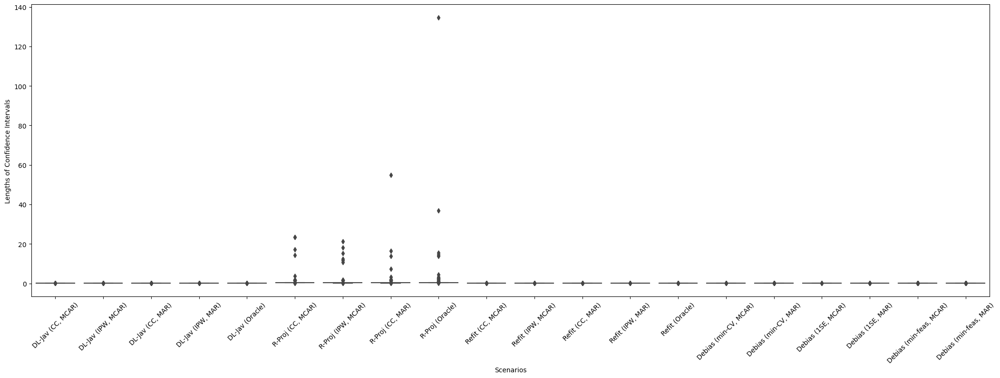

Scenario x0, beta1:



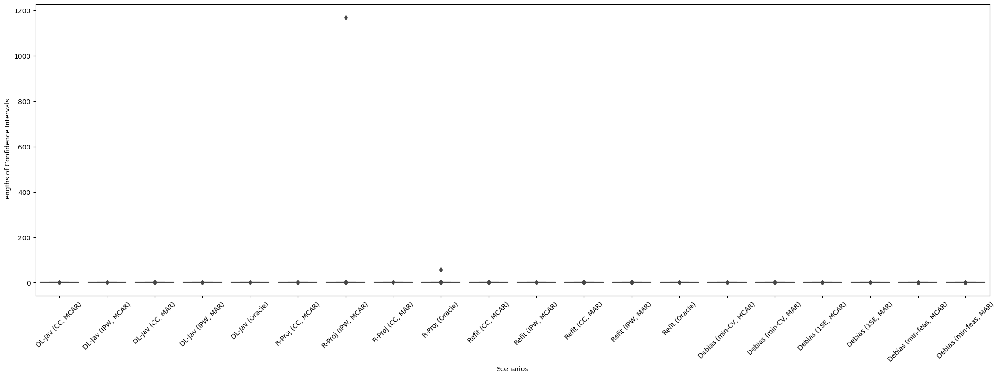

Scenario x0, beta2:



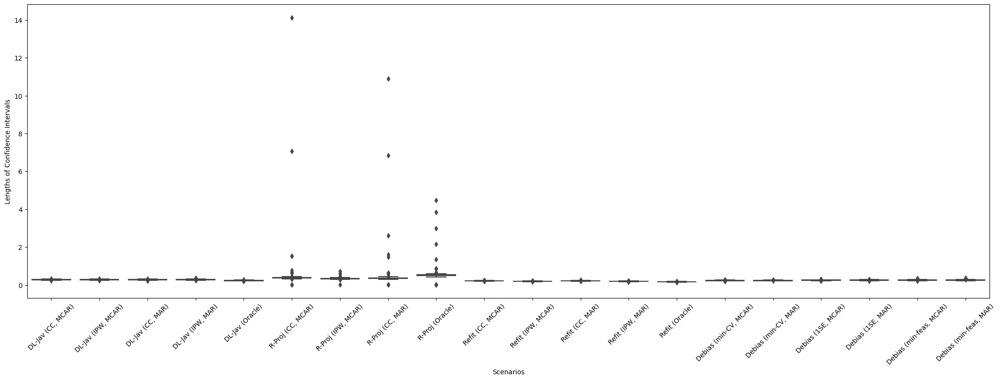

Scenario x1, beta0:



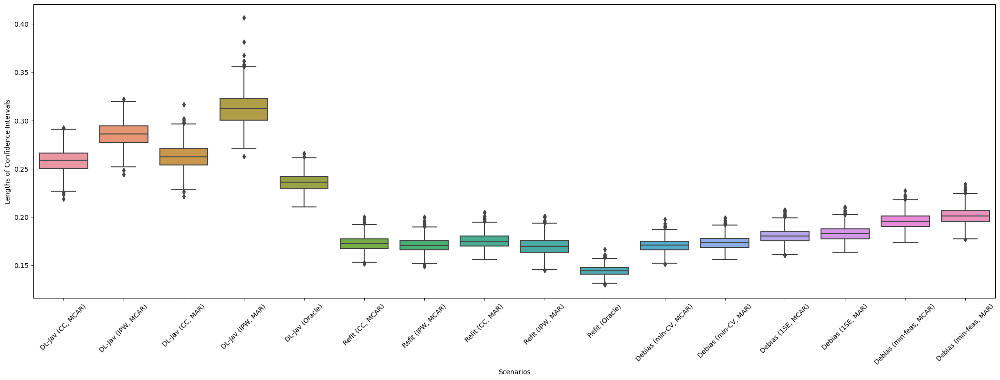

Scenario x1, beta1:



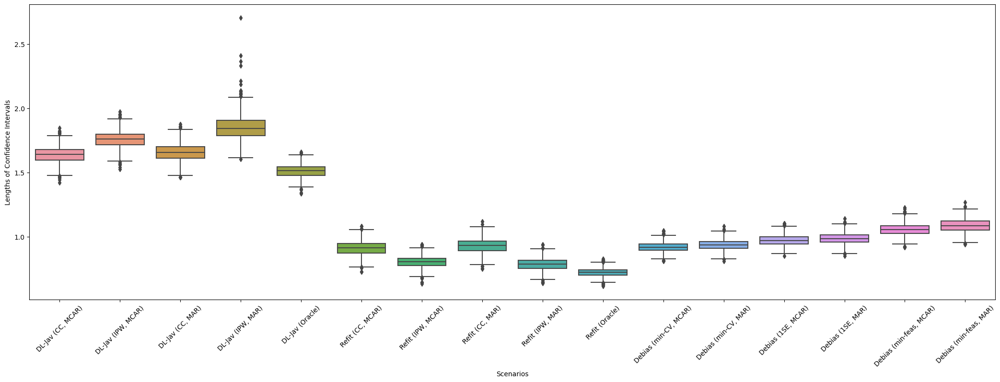

Scenario x1, beta2:



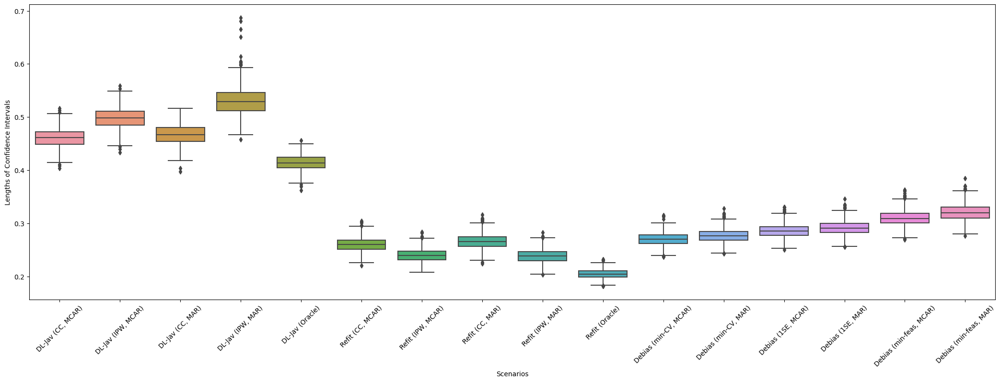

Scenario x2, beta0:



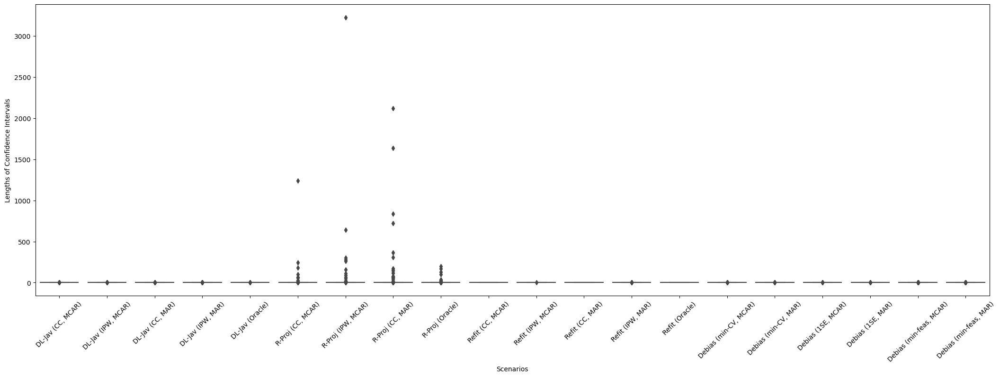

Scenario x2, beta1:



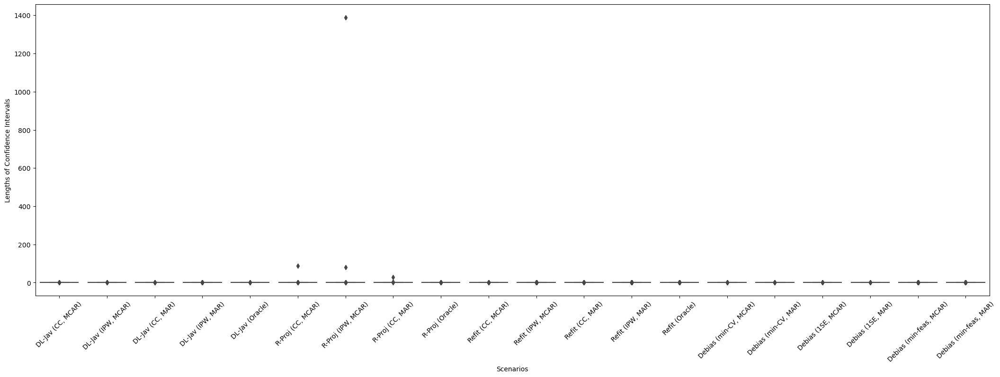

Scenario x2, beta2:



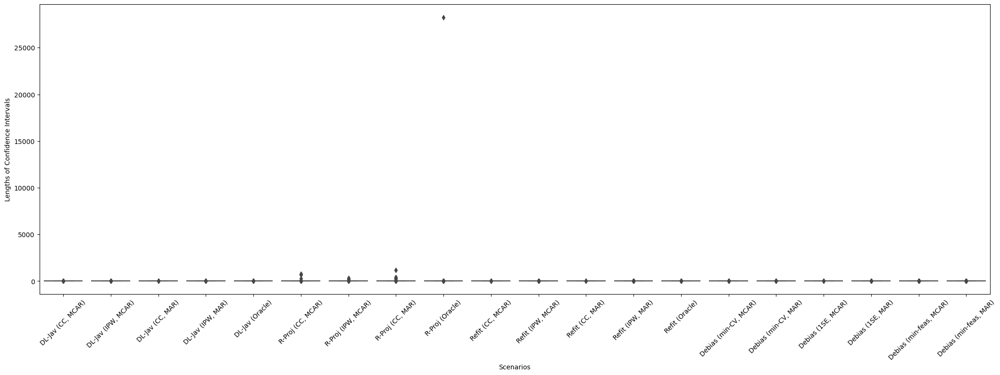

Scenario x3, beta0:



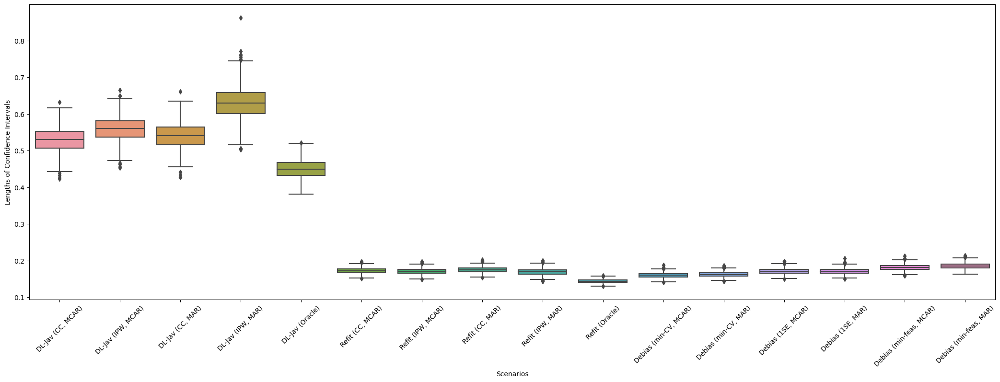

Scenario x3, beta1:



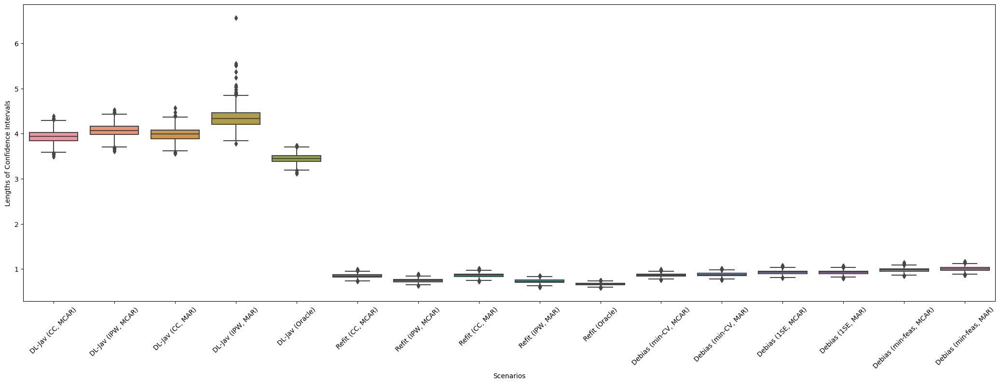

Scenario x3, beta2:



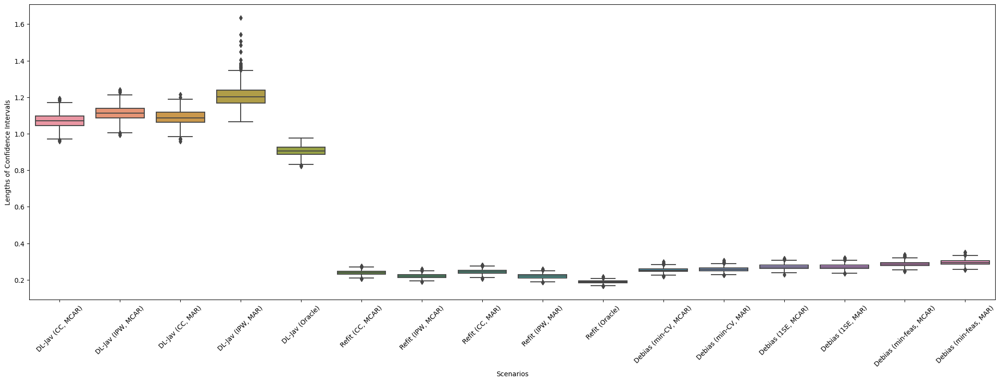

Scenario x4, beta0:



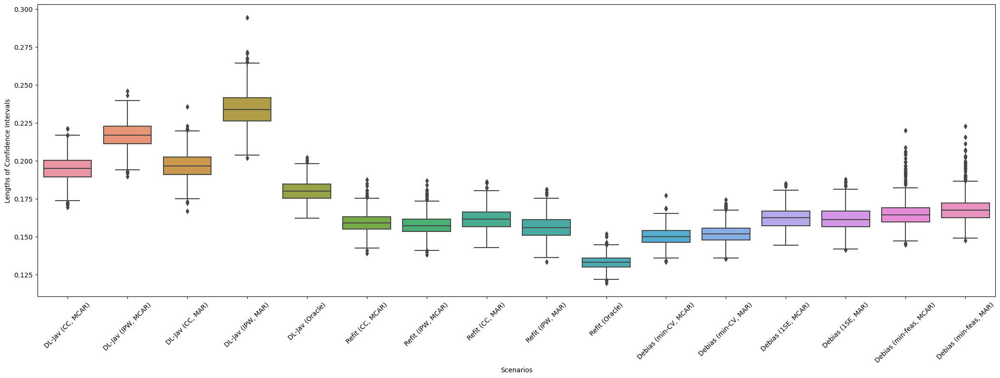

Scenario x4, beta1:



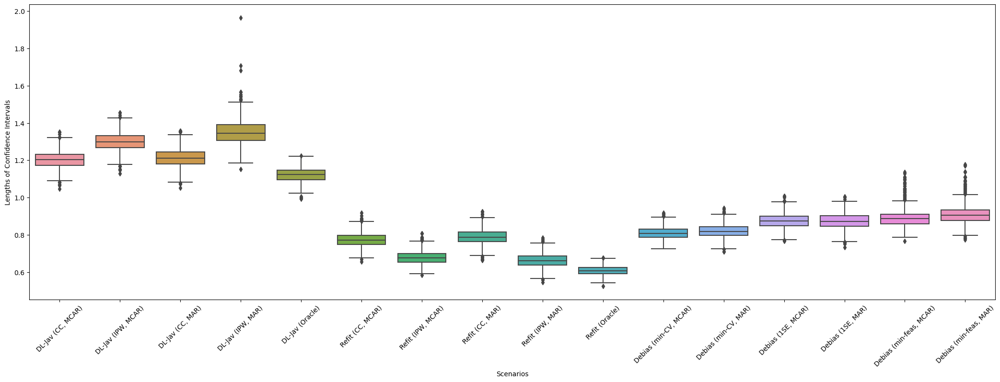

Scenario x4, beta2:



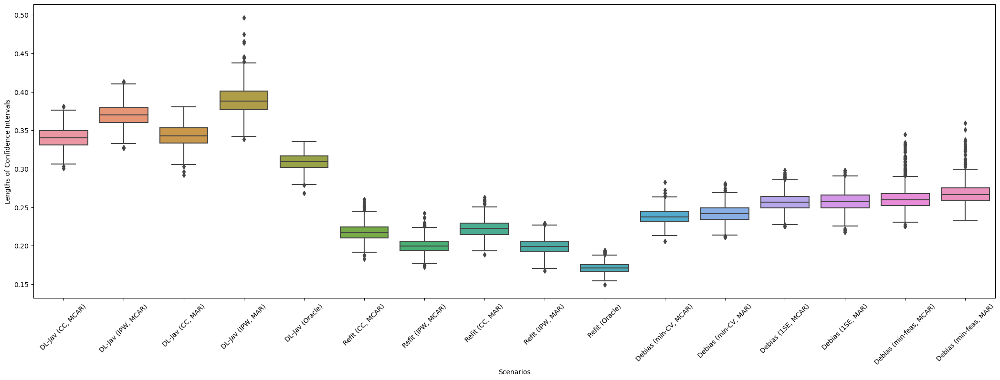

In [5]:
d = 1000
n= 900
B_repeat = 1000
for i in range(5):
    if i == 0:
        ## x0
        x = np.zeros((d,))
        x[0] = 1
    if i == 1:
        ## x1
        x = np.zeros((d,))
        x[0] = 1
        x[1] = 1/2
        x[2] = 1/4
        x[6] = 1/2
        x[7] = 1/8
    if i == 2:
        ## x2
        x = np.zeros((d,))
        x[99] = 1
    if i == 3:
        ## x3
        x = 1/np.linspace(1, d, d)
    if i == 4:
        ## x4
        x = 1/np.linspace(1, d, d)**2
    for k in range(3):
        if k == 0:
            s_beta = 5
            beta_0 = np.zeros((d,))
            beta_0[:s_beta] = np.sqrt(5)
        if k == 1:
            beta_0 = 1/np.sqrt(np.linspace(1, d, d))
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)
        if k == 2:
            beta_0 = 1/np.linspace(1, d, d)
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)

        # True regression function
        m_true = np.dot(x, beta_0)
        
        print('Scenario x'+str(i)+', beta'+str(k)+':\n')
        
        
        debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
        refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
        deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_1se.csv')
        deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_mincv.csv')
        deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_minfeas.csv')
        if (i == 0) or (i == 2):
            rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
        
        # Lengths of confidence intervals
        ## Debiased lasso (Javanmard and Montarani, 2014)
        CIlen_df = pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_obs1'], 
                                'Scenarios': np.repeat('DL-Jav (CC, MCAR)', B_repeat)})
        CIlen_df = pd.concat([CIlen_df, 
                             pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_ipw1'], 
                                           'Scenarios': np.repeat('DL-Jav (IPW, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                             pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_obs2'], 
                                           'Scenarios': np.repeat('DL-Jav (CC, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                             pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_ipw2'], 
                                           'Scenarios': np.repeat('DL-Jav (IPW, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                             pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_full'], 
                                           'Scenarios': np.repeat('DL-Jav (Oracle)', B_repeat)})], axis=0)
        
        ## Ridge projection
        if (i == 0) or (i == 2):
            CIlen_df = pd.concat([CIlen_df, 
                                  pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_obs1'], 
                                               'Scenarios': np.repeat('R-Proj (CC, MCAR)', B_repeat)})], axis=0)
            CIlen_df = pd.concat([CIlen_df, 
                                  pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_ipw1'], 
                                               'Scenarios': np.repeat('R-Proj (IPW, MCAR)', B_repeat)})], axis=0)
            CIlen_df = pd.concat([CIlen_df, 
                                  pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_obs2'], 
                                               'Scenarios': np.repeat('R-Proj (CC, MAR)', B_repeat)})], axis=0)
            CIlen_df = pd.concat([CIlen_df, 
                                  pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_ipw2'], 
                                               'Scenarios': np.repeat('R-Proj (CC, MAR)', B_repeat)})], axis=0)
            CIlen_df = pd.concat([CIlen_df, 
                                  pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_full'], 
                                               'Scenarios': np.repeat('R-Proj (Oracle)', B_repeat)})], axis=0)
        
        ## Lasso refitting
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_obs1'], 
                                            'Scenarios': np.repeat('Refit (CC, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_ipw1'], 
                                            'Scenarios': np.repeat('Refit (IPW, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_obs2'], 
                                            'Scenarios': np.repeat('Refit (CC, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_ipw2'], 
                                            'Scenarios': np.repeat('Refit (IPW, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_full'], 
                                            'Scenarios': np.repeat('Refit (Oracle)', B_repeat)})], axis=0)
        
        ## Proposed debiasing framework
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_mincv['asym_se1']*deb_est_mincv['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (min-CV, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_mincv['asym_se2']*deb_est_mincv['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (min-CV, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_1se['asym_se1']*deb_est_1se['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (1SE, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_1se['asym_se2']*deb_est_1se['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (1SE, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_minfeas['asym_se1']*deb_est_minfeas['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (min-feas, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_minfeas['asym_se2']*deb_est_minfeas['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (min-feas, MAR)', B_repeat)})], axis=0)
        
        plt.figure(figsize=(26, 8))
        sns.boxplot(y='Lengths of Confidence Intervals', x='Scenarios', data=CIlen_df)
        plt.xticks(rotation=45)
        plt.show()

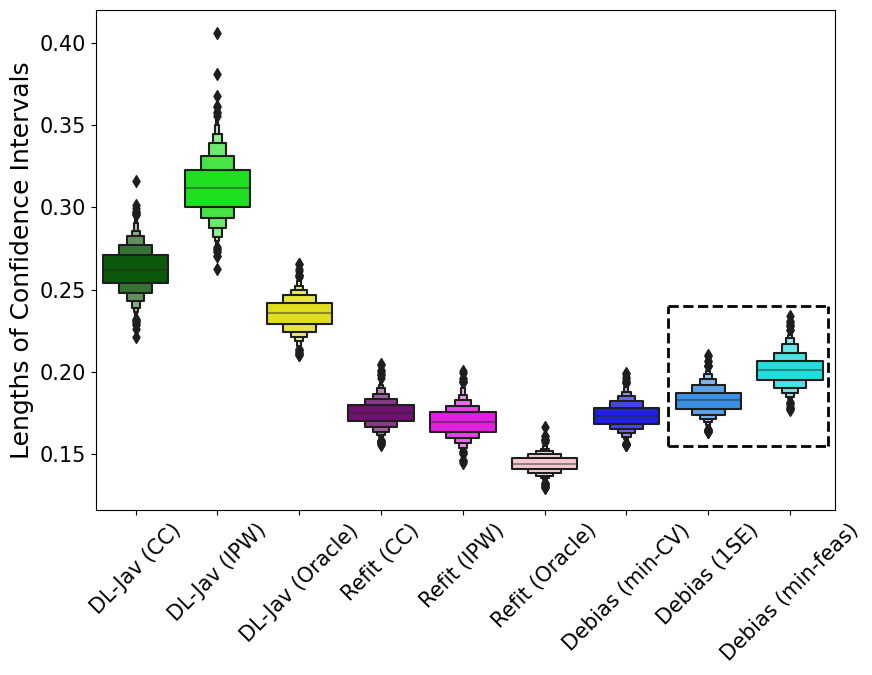

In [217]:
d = 1000
n = 900
B_repeat = 1000
i = 1
k = 0
## x1
x = np.zeros((d,))
x[0] = 1
x[1] = 1/2
x[2] = 1/4
x[6] = 1/2
x[7] = 1/8

s_beta = 5
beta_0 = np.zeros((d,))
beta_0[:s_beta] = np.sqrt(5)

# True regression function
m_true = np.dot(x, beta_0)

debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_1se.csv')
deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_mincv.csv')
deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_minfeas.csv')
if (i == 0) or (i == 2):
    rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
    
# Lengths of confidence intervals
## Debiased lasso (Javanmard and Montarani, 2014) MAR
CIlen_df = pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_obs2'], 
                        'Scenarios': np.repeat('DL-Jav (CC)', B_repeat)})
CIlen_df = pd.concat([CIlen_df, 
                     pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_ipw2'], 
                                   'Scenarios': np.repeat('DL-Jav (IPW)', B_repeat)})], axis=0)
CIlen_df = pd.concat([CIlen_df, 
                     pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_full'], 
                                   'Scenarios': np.repeat('DL-Jav (Oracle)', B_repeat)})], axis=0)

## Ridge projection MAR
if (i == 0) or (i == 2):
    CIlen_df = pd.concat([CIlen_df, 
                          pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_obs2'], 
                                       'Scenarios': np.repeat('R-Proj (CC)', B_repeat)})], axis=0)
    CIlen_df = pd.concat([CIlen_df, 
                          pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_ipw2'], 
                                       'Scenarios': np.repeat('R-Proj (CC)', B_repeat)})], axis=0)
    CIlen_df = pd.concat([CIlen_df, 
                          pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_full'], 
                                       'Scenarios': np.repeat('R-Proj (Oracle)', B_repeat)})], axis=0)

## Lasso refitting MAR
CIlen_df = pd.concat([CIlen_df, 
                      pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_obs2'], 
                                    'Scenarios': np.repeat('Refit (CC)', B_repeat)})], axis=0)
CIlen_df = pd.concat([CIlen_df, 
                      pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_ipw2'], 
                                    'Scenarios': np.repeat('Refit (IPW)', B_repeat)})], axis=0)
CIlen_df = pd.concat([CIlen_df, 
                      pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_full'], 
                                    'Scenarios': np.repeat('Refit (Oracle)', B_repeat)})], axis=0)

## Proposed debiasing framework MAR
CIlen_df = pd.concat([CIlen_df, 
                      pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_mincv['asym_se2']*deb_est_mincv['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2), 
                                    'Scenarios': np.repeat('Debias (min-CV)', B_repeat)})], axis=0)
CIlen_df = pd.concat([CIlen_df, 
                      pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_1se['asym_se2']*deb_est_1se['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2), 
                                    'Scenarios': np.repeat('Debias (1SE)', B_repeat)})], axis=0)
CIlen_df = pd.concat([CIlen_df, 
                      pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_minfeas['asym_se2']*deb_est_minfeas['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2), 
                                    'Scenarios': np.repeat('Debias (min-feas)', B_repeat)})], axis=0)


colors = ['darkgreen', 'lime', 'yellow', 'purple', 'magenta', 'pink', 'blue', 'dodgerblue', 'cyan']
# 'oldlace', 'orange', 'darkorange'
col_pal = dict(zip(list(Bias_df['Scenarios'].unique()), colors))


plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(9, 7))
sns.boxenplot(y='Lengths of Confidence Intervals', x='Scenarios', data=CIlen_df, palette=col_pal)
plt.xticks(rotation=45)
plt.xlabel('')
plt.ylabel('Lengths of Confidence Intervals', size=18)

refy2 = [0.155, 0.24]
refx2 = [6.51, 8.46]
plt.hlines(refy2, xmin=refx2[0], xmax=refx2[1], color='black', linestyles='--', linewidth=2)
plt.vlines(refx2, ymin=refy2[0], ymax=refy2[1], color='black', linestyles='--', linewidth=2)
plt.margins(x=0.01)
plt.tight_layout()
plt.savefig('./Figures/cirsym_CI_len_x'+str(i)+'_beta'+str(k)+'.pdf', bbox_inches='tight')

### Asymptotic Normality of Our Debiased Estimator

Scenario x0, beta0:



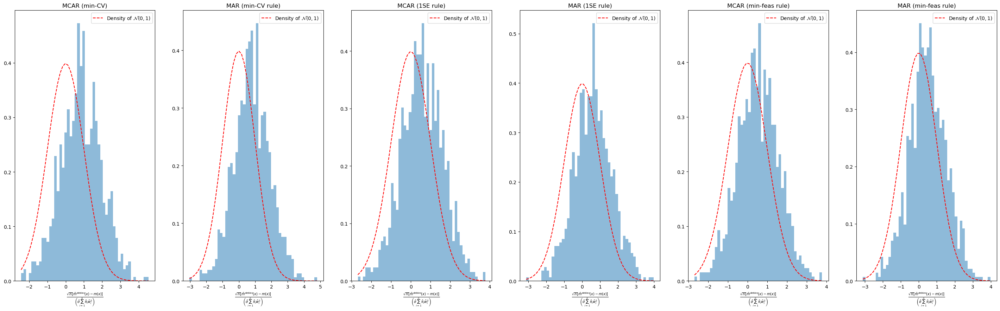

Scenario x0, beta1:



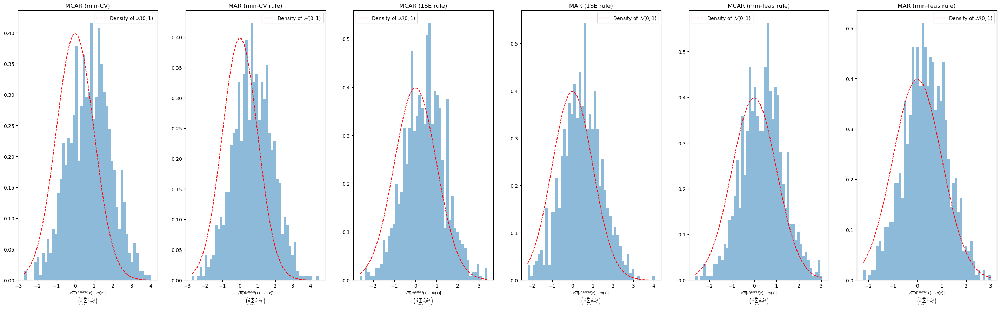

Scenario x0, beta2:



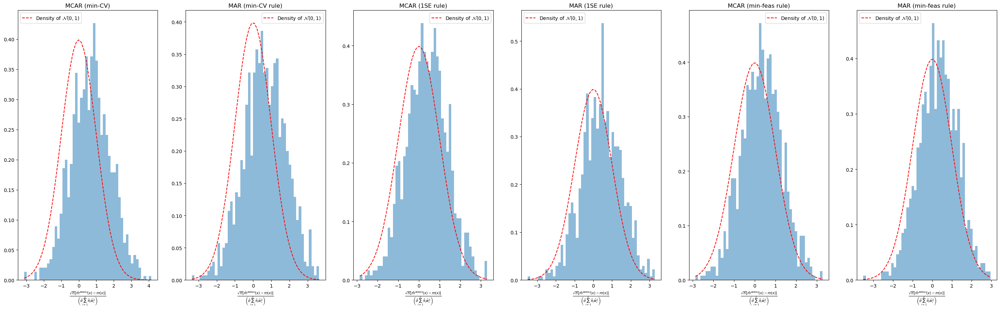

Scenario x1, beta0:



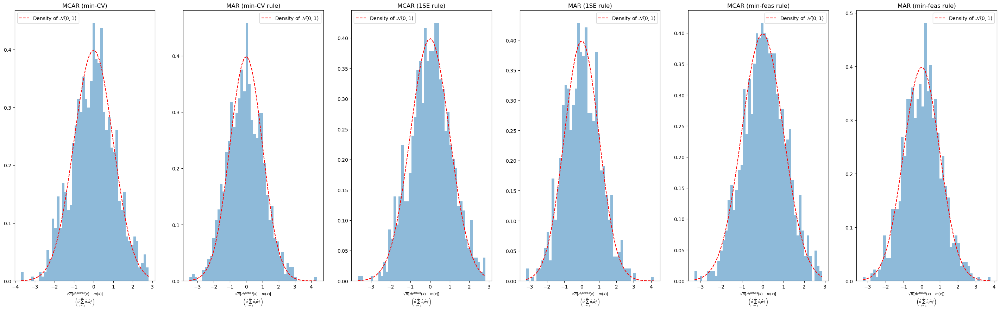

Scenario x1, beta1:



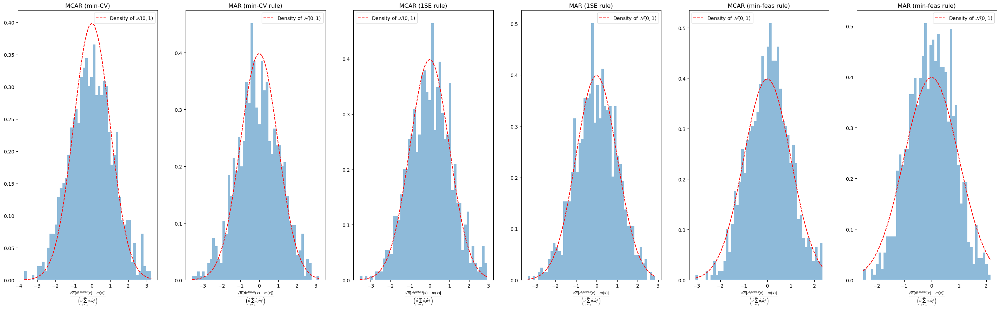

Scenario x1, beta2:



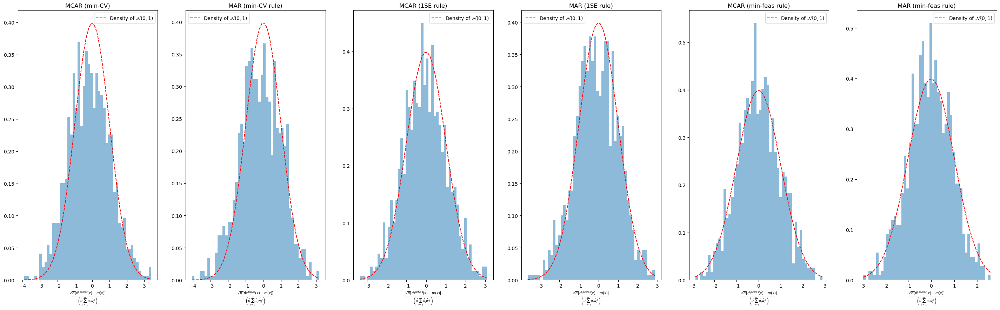

Scenario x2, beta0:



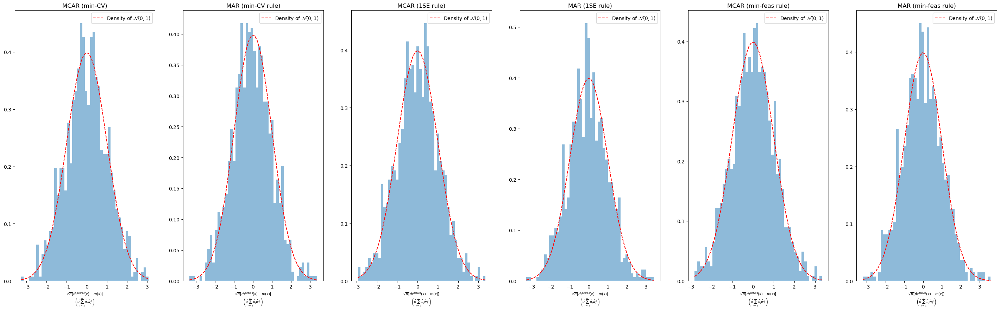

Scenario x2, beta1:



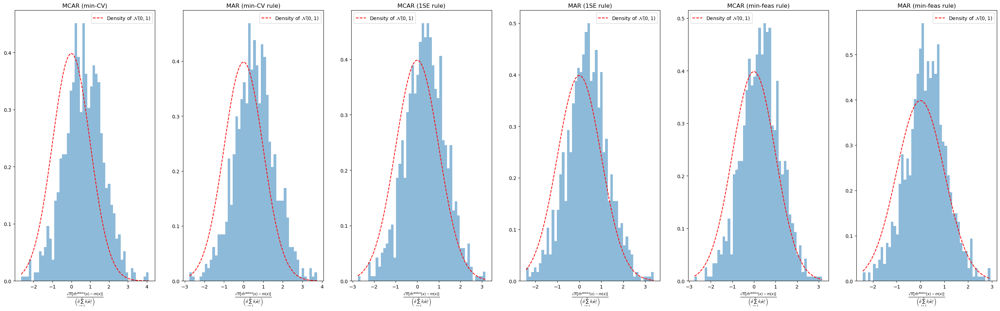

Scenario x2, beta2:



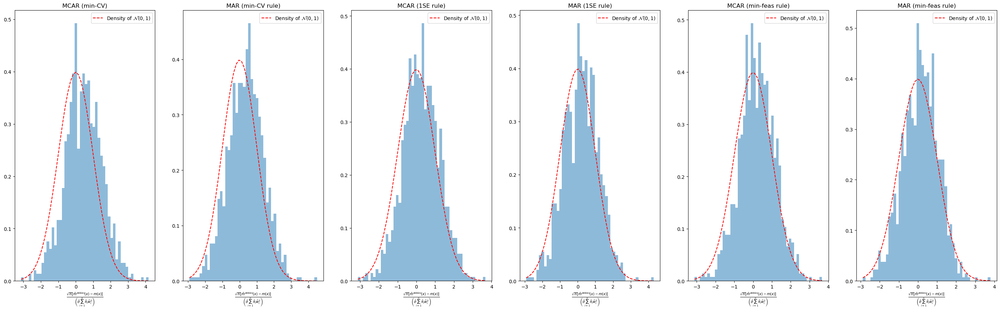

Scenario x3, beta0:



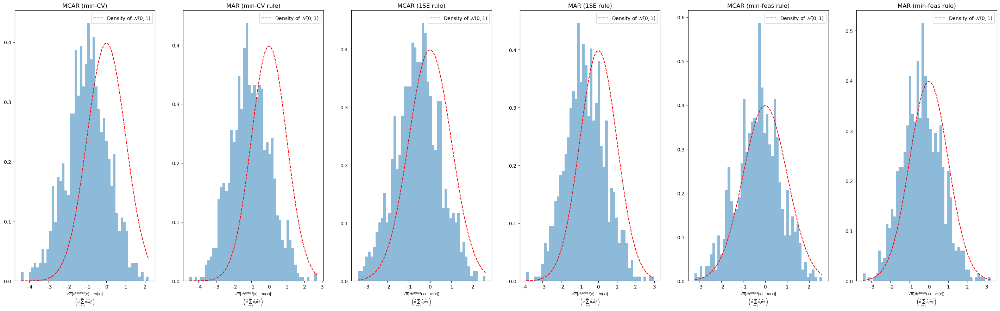

Scenario x3, beta1:



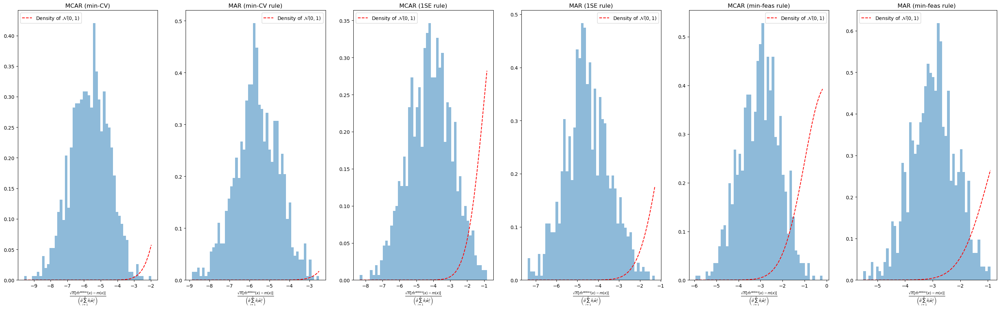

Scenario x3, beta2:



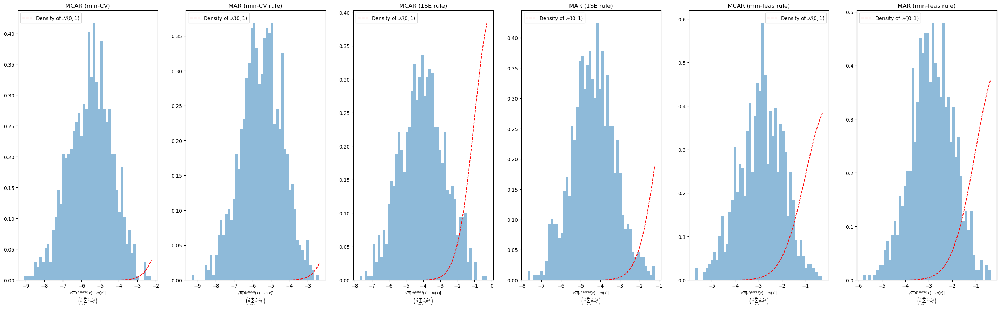

Scenario x4, beta0:



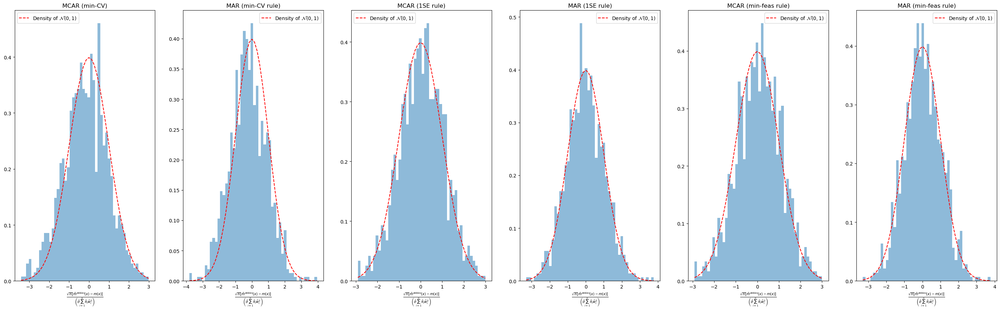

Scenario x4, beta1:



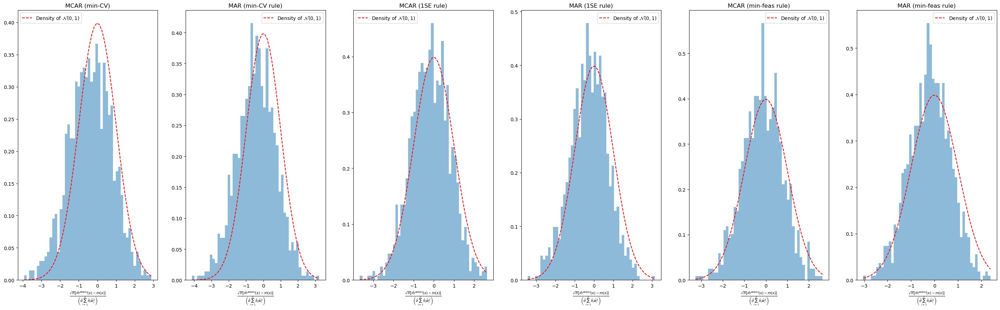

Scenario x4, beta2:



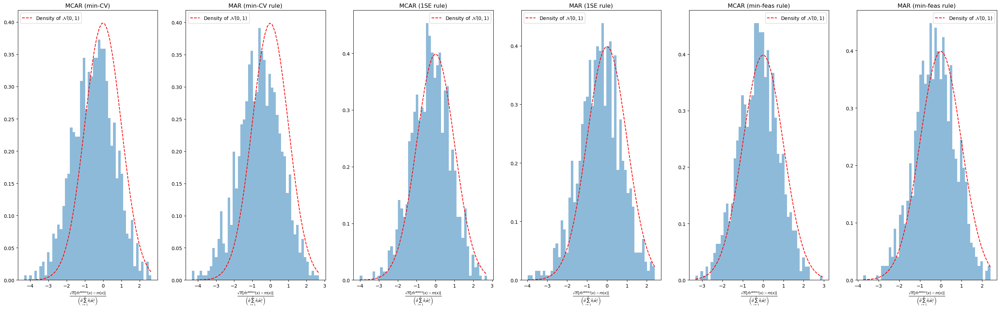

In [6]:
d = 1000
n= 900
for i in range(5):
    if i == 0:
        ## x0
        x = np.zeros((d,))
        x[0] = 1
    if i == 1:
        ## x1
        x = np.zeros((d,))
        x[0] = 1
        x[1] = 1/2
        x[2] = 1/4
        x[6] = 1/2
        x[7] = 1/8
    if i == 2:
        ## x2
        x = np.zeros((d,))
        x[99] = 1
    if i == 3:
        ## x3
        x = 1/np.linspace(1, d, d)
    if i == 4:
        ## x4
        x = 1/np.linspace(1, d, d)**2
    for k in range(3):
        if k == 0:
            s_beta = 5
            beta_0 = np.zeros((d,))
            beta_0[:s_beta] = np.sqrt(5)
        if k == 1:
            beta_0 = 1/np.sqrt(np.linspace(1, d, d))
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)
        if k == 2:
            beta_0 = 1/np.linspace(1, d, d)
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)

        # True regression function
        m_true = np.dot(x, beta_0)
        
        deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_1se.csv')
        deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_mincv.csv')
        deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_minfeas.csv')
        
        print('Scenario x'+str(i)+', beta'+str(k)+':\n')
        
        plt.figure(figsize=(36,10))
        plt.subplot(161)
        plt.hist((deb_est_mincv['m_deb1'] - m_true)/(deb_est_mincv['asym_se1'] * deb_est_mincv['sigma_hat1']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_mincv['m_deb1'] - m_true)/(deb_est_mincv['asym_se1'] * deb_est_mincv['sigma_hat1'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MCAR (min-CV)')
        
        plt.subplot(162)
        plt.hist((deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MAR (min-CV rule)')
        
        plt.subplot(163)
        plt.hist((deb_est_1se['m_deb1'] - m_true)/(deb_est_1se['asym_se1'] * deb_est_1se['sigma_hat1']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_1se['m_deb1'] - m_true)/(deb_est_1se['asym_se1'] * deb_est_1se['sigma_hat1'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MCAR (1SE rule)')
        
        plt.subplot(164)
        plt.hist((deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MAR (1SE rule)')
        
        plt.subplot(165)
        plt.hist((deb_est_minfeas['m_deb1'] - m_true)/(deb_est_minfeas['asym_se1'] * deb_est_minfeas['sigma_hat1']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_minfeas['m_deb1'] - m_true)/(deb_est_minfeas['asym_se1'] * deb_est_minfeas['sigma_hat1'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MCAR (min-feas rule)')
        
        plt.subplot(166)
        plt.hist((deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MAR (min-feas rule)')
        plt.show()

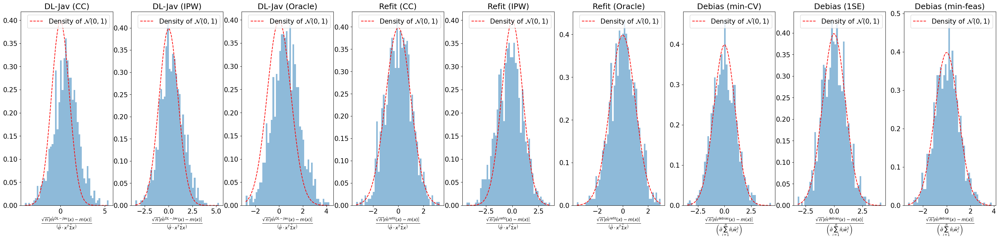

In [10]:
d = 1000
n = 900
B_repeat = 1000
i = 1
k = 0
## x1
x = np.zeros((d,))
x[0] = 1
x[1] = 1/2
x[2] = 1/4
x[6] = 1/2
x[7] = 1/8

s_beta = 5
beta_0 = np.zeros((d,))
beta_0[:s_beta] = np.sqrt(5)

# True regression function
m_true = np.dot(x, beta_0)

debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_1se.csv')
deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_mincv.csv')
deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_minfeas.csv')
if (i == 0) or (i == 2):
    rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')

plt.figure(figsize=(40,8))
plt.subplot(191)
plt.hist((debl_res1['m_obs2'] - m_true)/(debl_res1['asym_se_obs2'] * debl_res1['sigma_hat_obs2']), bins=50, 
         density=True, alpha=0.5)
pts = (debl_res1['m_obs2'] - m_true)/(debl_res1['asym_se_obs2'] * debl_res1['sigma_hat_obs2'])
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
         label='Density of $\mathcal{N}(0,1)$')
plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{DL-Jav}(x) - m(x) \right]}{\left(\hat{\sigma} \cdot x^T\hat{\Sigma}x\right)}$')
plt.legend()
plt.title('DL-Jav (CC)')

plt.subplot(192)
plt.hist((debl_res1['m_ipw2'] - m_true)/(debl_res1['asym_se_ipw2'] * debl_res1['sigma_hat_ipw2']), bins=50, 
         density=True, alpha=0.5)
pts = (debl_res1['m_ipw2'] - m_true)/(debl_res1['asym_se_ipw2'] * debl_res1['sigma_hat_ipw2'])
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
         label='Density of $\mathcal{N}(0,1)$')
plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{DL-Jav}(x) - m(x) \right]}{\left(\hat{\sigma} \cdot x^T\hat{\Sigma}x\right)}$')
plt.legend()
plt.title('DL-Jav (IPW)')

plt.subplot(193)
plt.hist((debl_res1['m_full'] - m_true)/(debl_res1['asym_se_full'] * debl_res1['sigma_hat_full']), bins=50, 
         density=True, alpha=0.5)
pts = (debl_res1['m_full'] - m_true)/(debl_res1['asym_se_full'] * debl_res1['sigma_hat_full'])
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
         label='Density of $\mathcal{N}(0,1)$')
plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{DL-Jav}(x) - m(x) \right]}{\left(\hat{\sigma} \cdot x^T\hat{\Sigma}x\right)}$')
plt.legend()
plt.title('DL-Jav (Oracle)')


plt.subplot(194)
plt.hist((refit_res1['m_obs2'] - m_true)/(refit_res1['asym_se_obs2'] * refit_res1['sigma_hat_obs2']), bins=50, 
         density=True, alpha=0.5)
pts = (refit_res1['m_obs2'] - m_true)/(refit_res1['asym_se_obs2'] * refit_res1['sigma_hat_obs2'])
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
         label='Density of $\mathcal{N}(0,1)$')
plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{refit}(x) - m(x) \right]}{\left(\hat{\sigma} \cdot x^T\hat{\Sigma}x\right)}$')
plt.legend()
plt.title('Refit (CC)')


plt.subplot(195)
plt.hist((refit_res1['m_ipw2'] - m_true)/(refit_res1['asym_se_ipw2'] * refit_res1['sigma_hat_ipw2']), bins=50, 
         density=True, alpha=0.5)
pts = (refit_res1['m_ipw2'] - m_true)/(refit_res1['asym_se_ipw2'] * refit_res1['sigma_hat_ipw2'])
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
         label='Density of $\mathcal{N}(0,1)$')
plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{refit}(x) - m(x) \right]}{\left(\hat{\sigma} \cdot x^T\hat{\Sigma}x\right)}$')
plt.legend()
plt.title('Refit (IPW)')

plt.subplot(196)
plt.hist((refit_res1['m_full'] - m_true)/(refit_res1['asym_se_full'] * refit_res1['sigma_hat_full']), bins=50, 
         density=True, alpha=0.5)
pts = (refit_res1['m_full'] - m_true)/(refit_res1['asym_se_full'] * refit_res1['sigma_hat_full'])
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
         label='Density of $\mathcal{N}(0,1)$')
plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{refit}(x) - m(x) \right]}{\left(\hat{\sigma} \cdot x^T\hat{\Sigma}x\right)}$')
plt.legend()
plt.title('Refit (Oracle)')


plt.subplot(197)
plt.hist((deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2']), bins=50, 
         density=True, alpha=0.5)
pts = (deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2'])
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
         label='Density of $\mathcal{N}(0,1)$')
plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
plt.legend()
plt.title('Debias (min-CV)')

plt.subplot(198)
plt.hist((deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2']), bins=50, 
         density=True, alpha=0.5)
pts = (deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2'])
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
         label='Density of $\mathcal{N}(0,1)$')
plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
plt.legend()
plt.title('Debias (1SE)')

plt.subplot(199)
plt.hist((deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2']), bins=50, 
         density=True, alpha=0.5)
pts = (deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2'])
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
         label='Density of $\mathcal{N}(0,1)$')
plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
plt.legend()
plt.title('Debias (min-feas)')
plt.show()

Scenario x0, beta0:



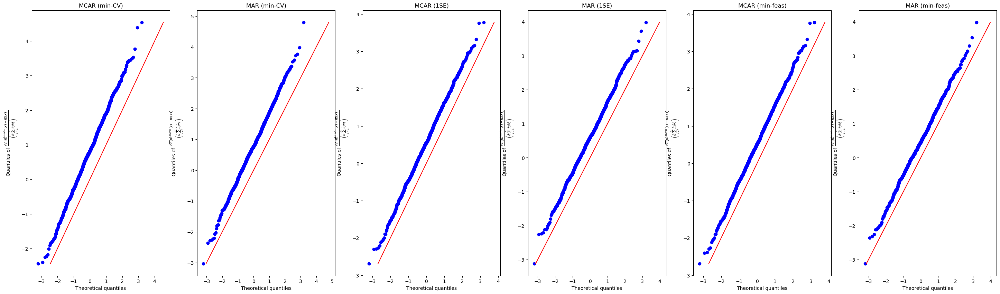

Scenario x0, beta1:



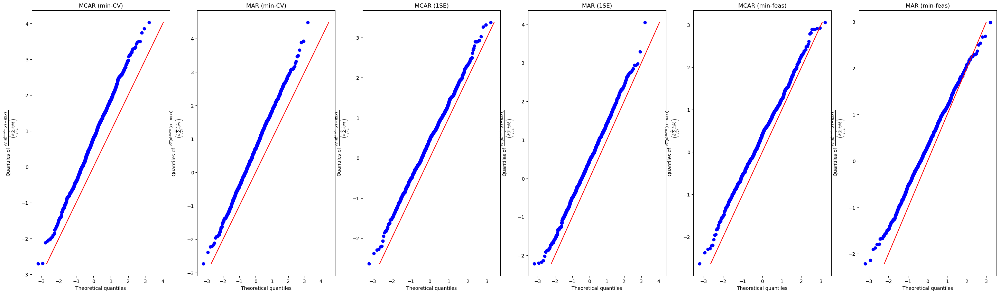

Scenario x0, beta2:



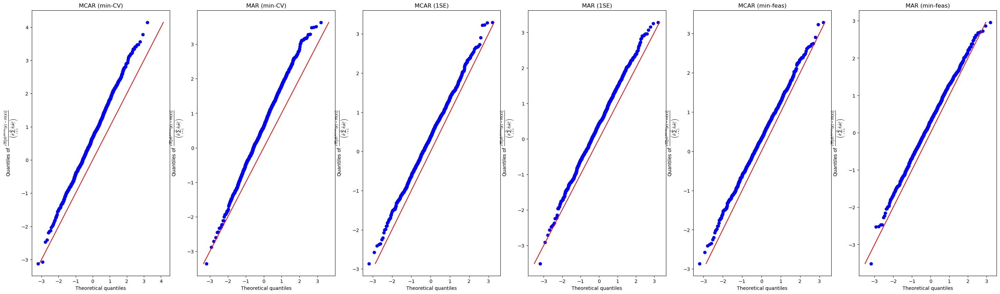

Scenario x1, beta0:



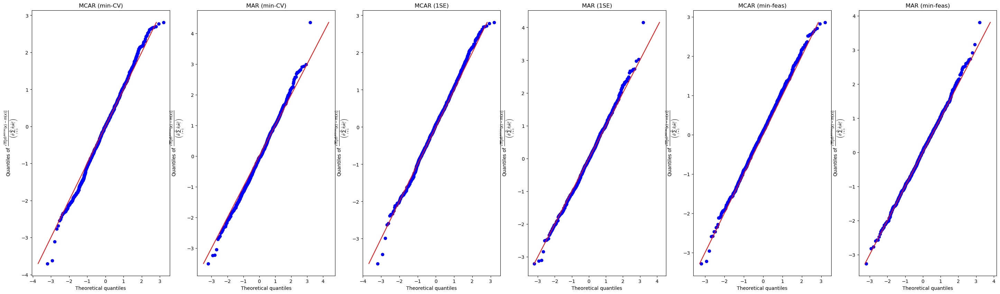

Scenario x1, beta1:



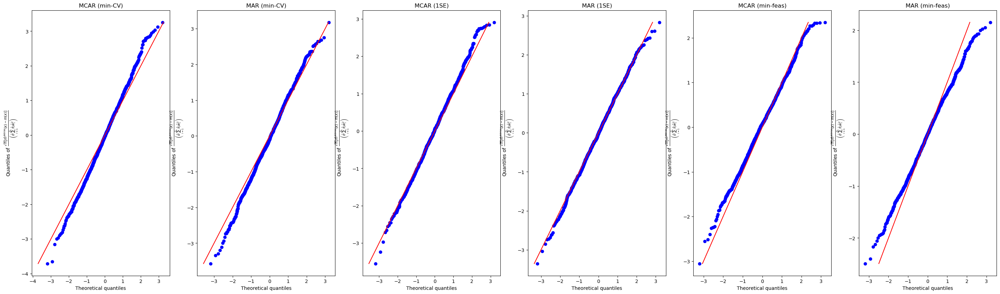

Scenario x1, beta2:



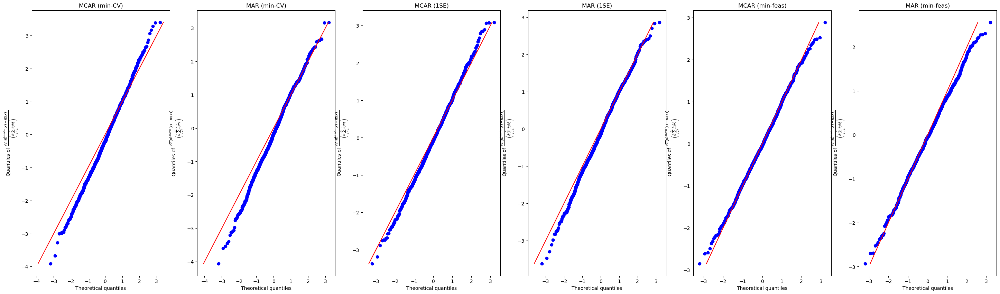

Scenario x2, beta0:



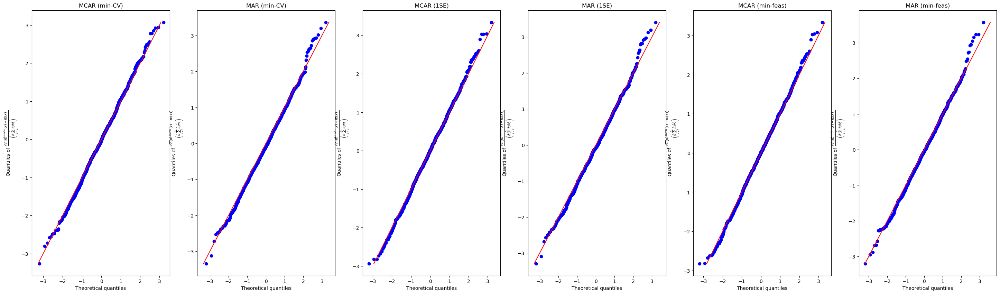

Scenario x2, beta1:



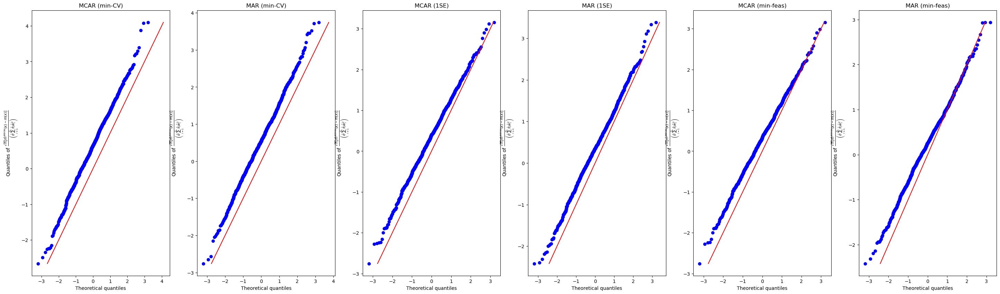

Scenario x2, beta2:



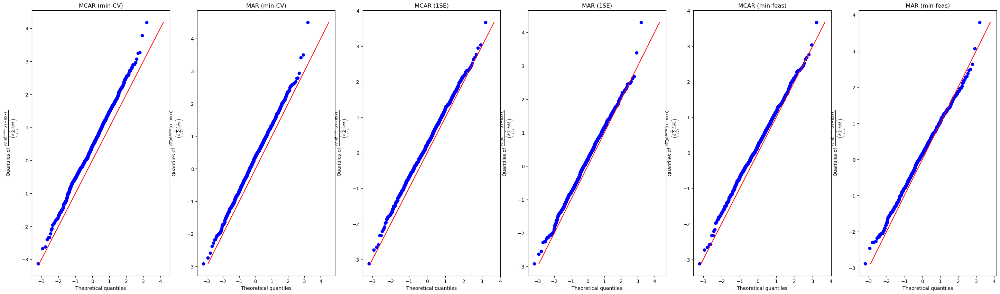

Scenario x3, beta0:



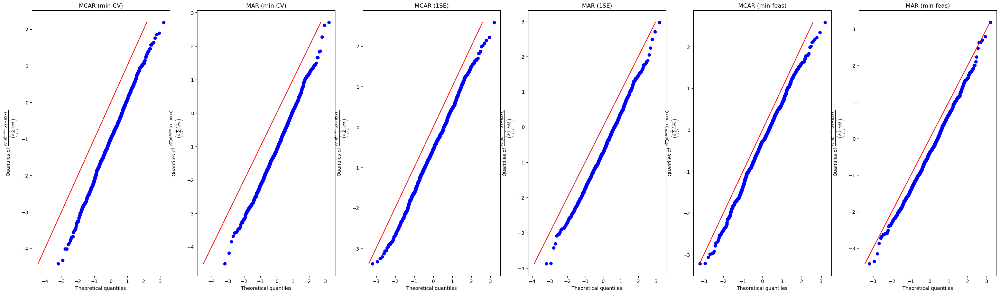

Scenario x3, beta1:



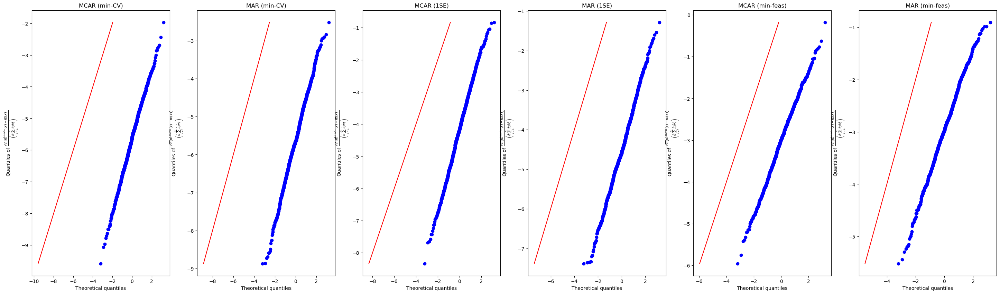

Scenario x3, beta2:



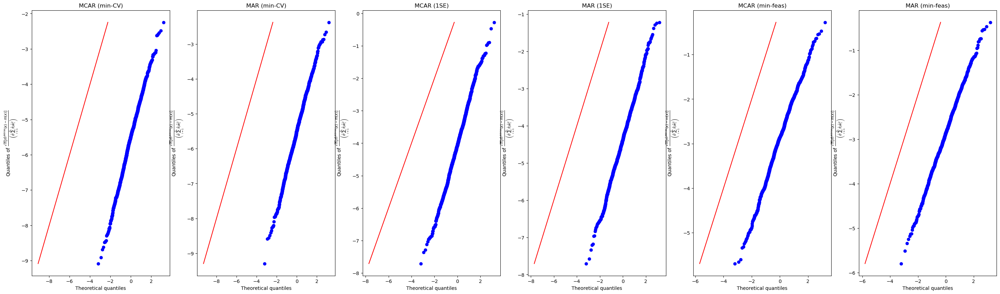

Scenario x4, beta0:



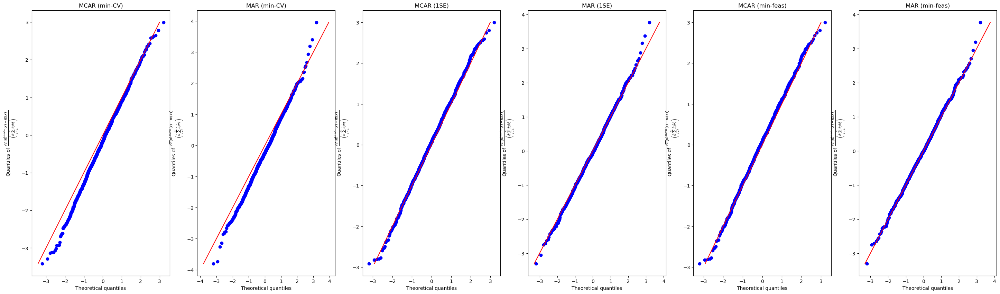

Scenario x4, beta1:



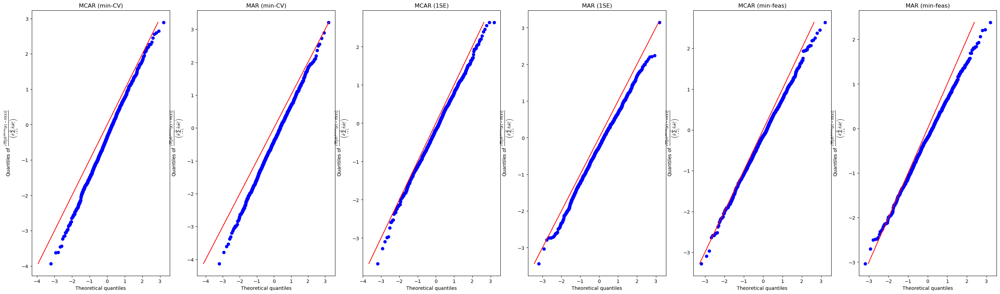

Scenario x4, beta2:



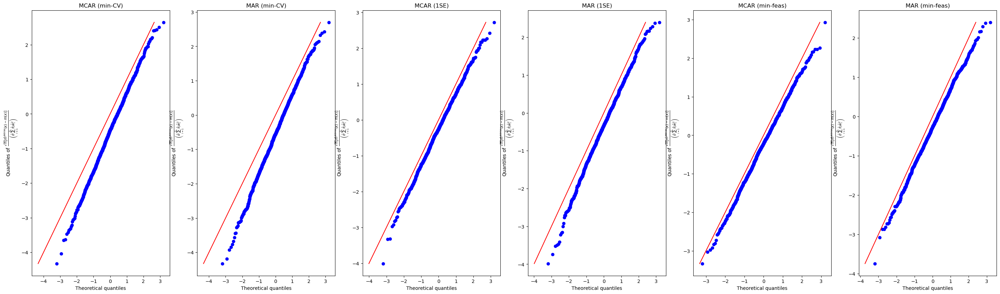

In [7]:
d = 1000
n= 900
for i in range(5):
    if i == 0:
        ## x0
        x = np.zeros((d,))
        x[0] = 1
    if i == 1:
        ## x1
        x = np.zeros((d,))
        x[0] = 1
        x[1] = 1/2
        x[2] = 1/4
        x[6] = 1/2
        x[7] = 1/8
    if i == 2:
        ## x2
        x = np.zeros((d,))
        x[99] = 1
    if i == 3:
        ## x3
        x = 1/np.linspace(1, d, d)
    if i == 4:
        ## x4
        x = 1/np.linspace(1, d, d)**2
    for k in range(3):
        if k == 0:
            s_beta = 5
            beta_0 = np.zeros((d,))
            beta_0[:s_beta] = np.sqrt(5)
        if k == 1:
            beta_0 = 1/np.sqrt(np.linspace(1, d, d))
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)
        if k == 2:
            beta_0 = 1/np.linspace(1, d, d)
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)

        # True regression function
        m_true = np.dot(x, beta_0)
        
        deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_1se.csv')
        deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_mincv.csv')
        deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_minfeas.csv')
        
        print('Scenario x'+str(i)+', beta'+str(k)+':\n')
        
        plt.figure(figsize=(36,10))
        plt.subplot(161)
        pts = (deb_est_mincv['m_deb1'] - m_true)/(deb_est_mincv['asym_se1'] * deb_est_mincv['sigma_hat1'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MCAR (min-CV)')
        
        plt.subplot(162)
        pts = (deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MAR (min-CV)')
        
        plt.subplot(163)
        pts = (deb_est_1se['m_deb1'] - m_true)/(deb_est_1se['asym_se1'] * deb_est_1se['sigma_hat1'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MCAR (1SE)')
        
        plt.subplot(164)
        pts = (deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MAR (1SE)')
        
        plt.subplot(165)
        pts = (deb_est_minfeas['m_deb1'] - m_true)/(deb_est_minfeas['asym_se1'] * deb_est_minfeas['sigma_hat1'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MCAR (min-feas)')
        
        plt.subplot(166)
        pts = (deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MAR (min-feas)')
        plt.show()

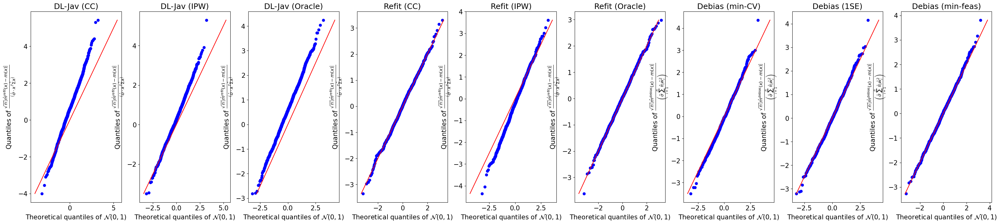

In [11]:
d = 1000
n = 900
B_repeat = 1000
i = 1
k = 0
## x1
x = np.zeros((d,))
x[0] = 1
x[1] = 1/2
x[2] = 1/4
x[6] = 1/2
x[7] = 1/8

s_beta = 5
beta_0 = np.zeros((d,))
beta_0[:s_beta] = np.sqrt(5)

# True regression function
m_true = np.dot(x, beta_0)

debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_1se.csv')
deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_mincv.csv')
deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_minfeas.csv')
if (i == 0) or (i == 2):
    rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')

plt.figure(figsize=(40,8))
plt.subplot(191)
pts = (debl_res1['m_obs2'] - m_true)/(debl_res1['asym_se_obs2'] * debl_res1['sigma_hat_obs2'])
scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, x_range, color='red')
plt.xlabel('Theoretical quantiles of $\mathcal{N}(0,1)$')
plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{refit}(x) - m(x) \right]}{\left(\hat{\sigma} \cdot x^T\hat{\Sigma}x\right)}$')
plt.title('DL-Jav (CC)')

plt.subplot(192)
pts = (debl_res1['m_ipw2'] - m_true)/(debl_res1['asym_se_ipw2'] * debl_res1['sigma_hat_ipw2'])
scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, x_range, color='red')
plt.xlabel('Theoretical quantiles of $\mathcal{N}(0,1)$')
plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{refit}(x) - m(x) \right]}{\left(\hat{\sigma} \cdot x^T\hat{\Sigma}x\right)}$')
plt.title('DL-Jav (IPW)')

plt.subplot(193)
pts = (debl_res1['m_full'] - m_true)/(debl_res1['asym_se_full'] * debl_res1['sigma_hat_full'])
scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, x_range, color='red')
plt.xlabel('Theoretical quantiles of $\mathcal{N}(0,1)$')
plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{refit}(x) - m(x) \right]}{\left(\hat{\sigma} \cdot x^T\hat{\Sigma}x\right)}$')
plt.title('DL-Jav (Oracle)')


plt.subplot(194)
pts = (refit_res1['m_obs2'] - m_true)/(refit_res1['asym_se_obs2'] * refit_res1['sigma_hat_obs2'])
scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, x_range, color='red')
plt.xlabel('Theoretical quantiles of $\mathcal{N}(0,1)$')
plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{refit}(x) - m(x) \right]}{\left(\hat{\sigma} \cdot x^T\hat{\Sigma}x\right)}$')
plt.title('Refit (CC)')


plt.subplot(195)
pts = (refit_res1['m_ipw2'] - m_true)/(refit_res1['asym_se_ipw2'] * refit_res1['sigma_hat_ipw2'])
scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, x_range, color='red')
plt.xlabel('Theoretical quantiles of $\mathcal{N}(0,1)$')
plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{refit}(x) - m(x) \right]}{\left(\hat{\sigma} \cdot x^T\hat{\Sigma}x\right)}$')
plt.title('Refit (IPW)')

plt.subplot(196)
pts = (refit_res1['m_full'] - m_true)/(refit_res1['asym_se_full'] * refit_res1['sigma_hat_full'])
scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, x_range, color='red')
plt.xlabel('Theoretical quantiles of $\mathcal{N}(0,1)$')
plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{refit}(x) - m(x) \right]}{\left(\hat{\sigma} \cdot x^T\hat{\Sigma}x\right)}$')
plt.title('Refit (Oracle)')


plt.subplot(197)
pts = (deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2'])
scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, x_range, color='red')
plt.xlabel('Theoretical quantiles of $\mathcal{N}(0,1)$')
plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
plt.title('Debias (min-CV)')

plt.subplot(198)
pts = (deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2'])
scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, x_range, color='red')
plt.xlabel('Theoretical quantiles of $\mathcal{N}(0,1)$')
plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
plt.title('Debias (1SE)')

plt.subplot(199)
pts = (deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2'])
scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, x_range, color='red')
plt.xlabel('Theoretical quantiles of $\mathcal{N}(0,1)$')
plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
plt.title('Debias (min-feas)')
plt.show()

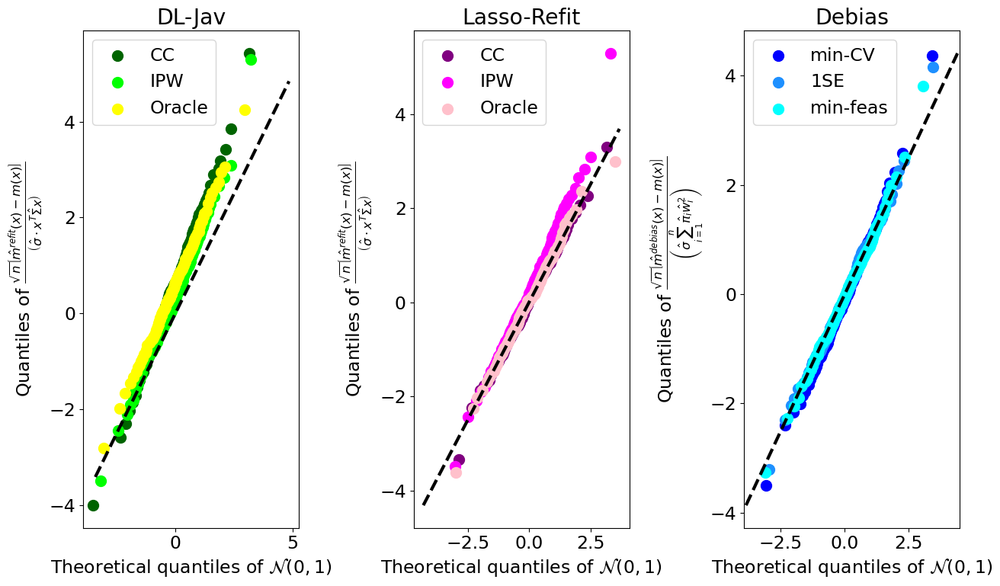

In [205]:
d = 1000
n = 900
B_repeat = 1000
i = 1
k = 0
## x1
x = np.zeros((d,))
x[0] = 1
x[1] = 1/2
x[2] = 1/4
x[6] = 1/2
x[7] = 1/8

s_beta = 5
beta_0 = np.zeros((d,))
beta_0[:s_beta] = np.sqrt(5)

# True regression function
m_true = np.dot(x, beta_0)

debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_1se.csv')
deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_mincv.csv')
deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_minfeas.csv')
if (i == 0) or (i == 2):
    rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'.csv')
    
    
colors = ['darkgreen', 'lime', 'yellow', 'purple', 'magenta', 'pink', 'blue', 'dodgerblue', 'cyan']
# 'oldlace', 'orange', 'darkorange'
col_pal = dict(zip(list(Bias_df['Scenarios'].unique()), colors))


plt.rcParams.update({'font.size': 17})
plt.figure(figsize=(13,8))
plt.subplot(131)
pts = (debl_res1['m_obs2'] - m_true)/(debl_res1['asym_se_obs2'] * debl_res1['sigma_hat_obs2'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[0], s=100, label='CC')

pts = (debl_res1['m_ipw2'] - m_true)/(debl_res1['asym_se_ipw2'] * debl_res1['sigma_hat_ipw2'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[1], s=100, label='IPW')

pts = (debl_res1['m_full'] - m_true)/(debl_res1['asym_se_full'] * debl_res1['sigma_hat_full'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[2], s=100, label='Oracle')

x_range = np.linspace(np.min(pts)-0.6, np.max(pts)+0.6, 50)
plt.plot(x_range, x_range, color='black', linestyle='dashed', linewidth=3)
plt.xlabel('Theoretical quantiles of $\mathcal{N}(0,1)$')
plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{refit}(x) - m(x) \right]}{\left(\hat{\sigma} \cdot x^T\hat{\Sigma}x\right)}$')
plt.legend()
plt.title('DL-Jav')


plt.subplot(132)
pts = (refit_res1['m_obs2'] - m_true)/(refit_res1['asym_se_obs2'] * refit_res1['sigma_hat_obs2'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[3], s=100, label='CC')

pts = (debl_res1['m_ipw2'] - m_true)/(debl_res1['asym_se_ipw2'] * debl_res1['sigma_hat_ipw2'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[4], s=100, label='IPW')

pts = (refit_res1['m_full'] - m_true)/(refit_res1['asym_se_full'] * refit_res1['sigma_hat_full'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[5], s=100, label='Oracle')

x_range = np.linspace(np.min(pts)-0.7, np.max(pts)+0.7, 50)
plt.plot(x_range, x_range, color='black', linestyle='dashed', linewidth=3)
plt.xlabel('Theoretical quantiles of $\mathcal{N}(0,1)$')
plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{refit}(x) - m(x) \right]}{\left(\hat{\sigma} \cdot x^T\hat{\Sigma}x\right)}$')
plt.legend()
plt.title('Lasso-Refit')


plt.subplot(133)
pts = (deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[6], s=100, label='min-CV')

pts = (deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[7], s=100, label='1SE')

pts = (deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[8], s=100, label='min-feas')

x_range = np.linspace(np.min(pts)-0.6, np.max(pts)+0.6, 50)
plt.plot(x_range, x_range, color='black', linestyle='dashed', linewidth=3)
plt.xlabel('Theoretical quantiles of $\mathcal{N}(0,1)$')
plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
plt.legend()
plt.title('Debias')
plt.margins(x=0.01)
plt.tight_layout()
plt.savefig('./Figures/cirsym_qqplot_x'+str(i)+'_beta'+str(k)+'.pdf', bbox_inches='tight')

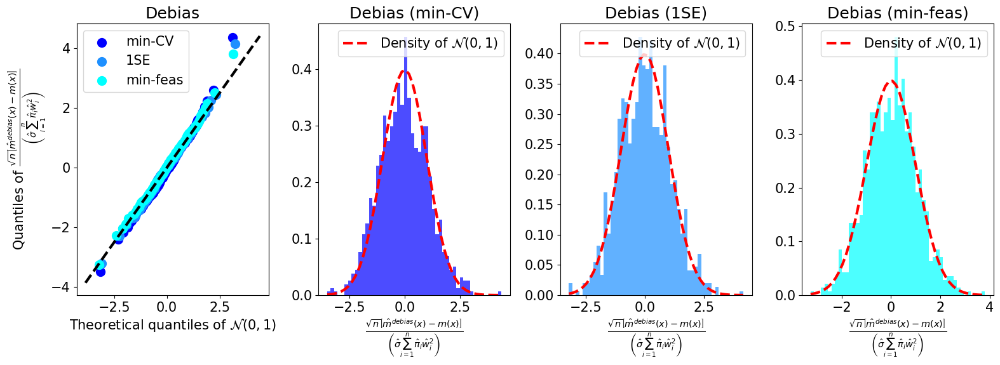

In [206]:
colors = ['darkgreen', 'lime', 'yellow', 'purple', 'magenta', 'pink', 'blue', 'dodgerblue', 'cyan']
# 'oldlace', 'orange', 'darkorange'
col_pal = dict(zip(list(Bias_df['Scenarios'].unique()), colors))


plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(16,6))
plt.subplot(141)
pts = (deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[6], s=100, label='min-CV')

pts = (deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[7], s=100, label='1SE')

pts = (deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[8], s=100, label='min-feas')

x_range = np.linspace(np.min(pts)-0.6, np.max(pts)+0.6, 50)
plt.plot(x_range, x_range, color='black', linestyle='dashed', linewidth=3)
plt.xlabel('Theoretical quantiles of $\mathcal{N}(0,1)$')
plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
plt.legend()
plt.title('Debias')


plt.subplot(142)
plt.hist((deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2']), bins=50, 
         density=True, alpha=0.7, color='blue')
pts = (deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2'])
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', linewidth=3,
         label='Density of $\mathcal{N}(0,1)$')
plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
plt.legend()
plt.title('Debias (min-CV)')

plt.subplot(143)
plt.hist((deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2']), bins=50, 
         density=True, alpha=0.7, color='dodgerblue')
pts = (deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2'])
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', linewidth=3,
         label='Density of $\mathcal{N}(0,1)$')
plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
plt.legend()
plt.title('Debias (1SE)')

plt.subplot(144)
plt.hist((deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2']), bins=50, 
         density=True, alpha=0.7, color='cyan')
pts = (deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2'])
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', linewidth=3,
         label='Density of $\mathcal{N}(0,1)$')
plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
plt.legend()
plt.title('Debias (min-feas)')

plt.tight_layout()
plt.savefig('./Figures/cirsym_asym_norm_x'+str(i)+'_beta'+str(k)+'.pdf', bbox_inches='tight')

## d=1000, n=900 (Laplace noise)

### Bias Comparison (Laplace noise)

Scenario x0, beta0:



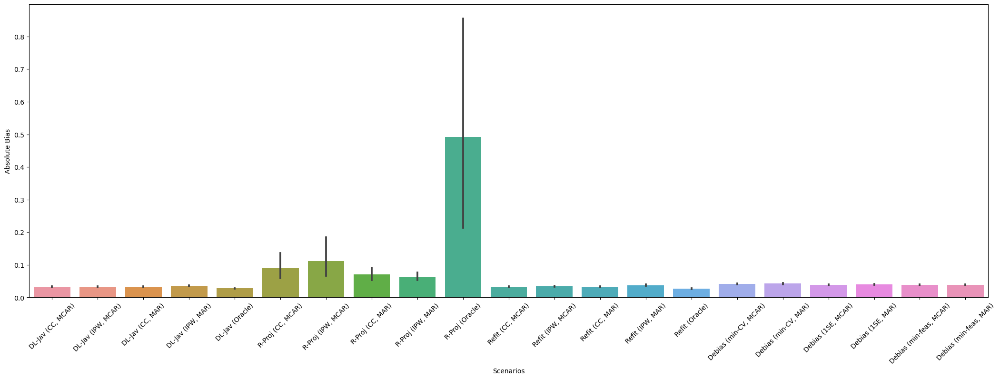

Scenario x0, beta1:



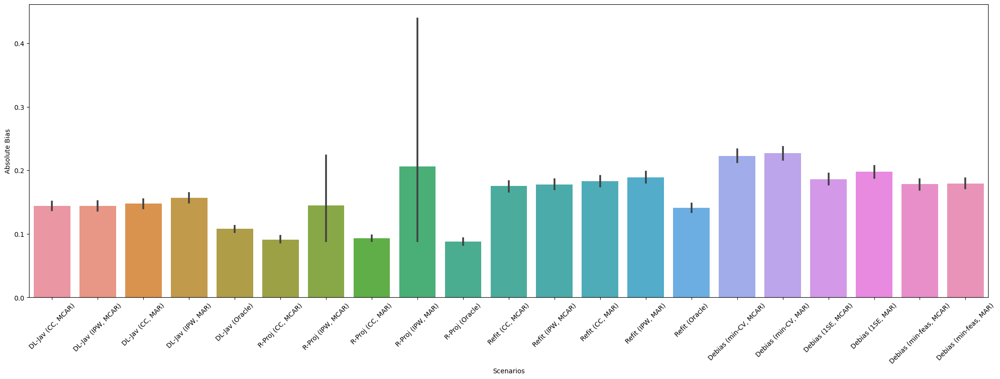

Scenario x0, beta2:



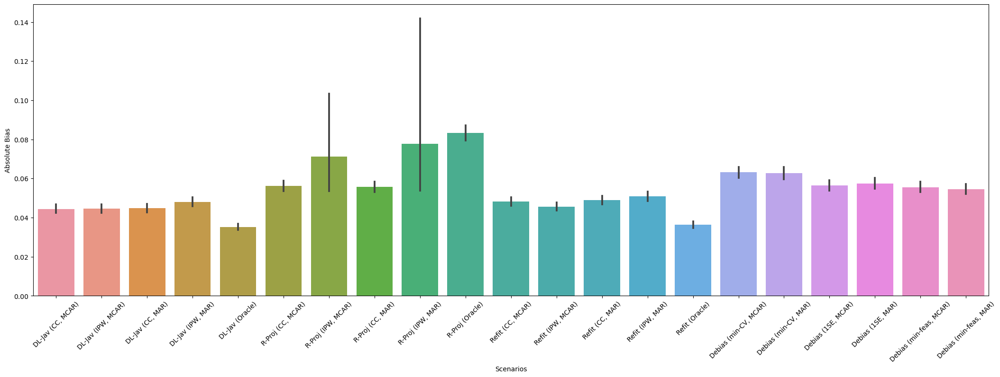

Scenario x1, beta0:



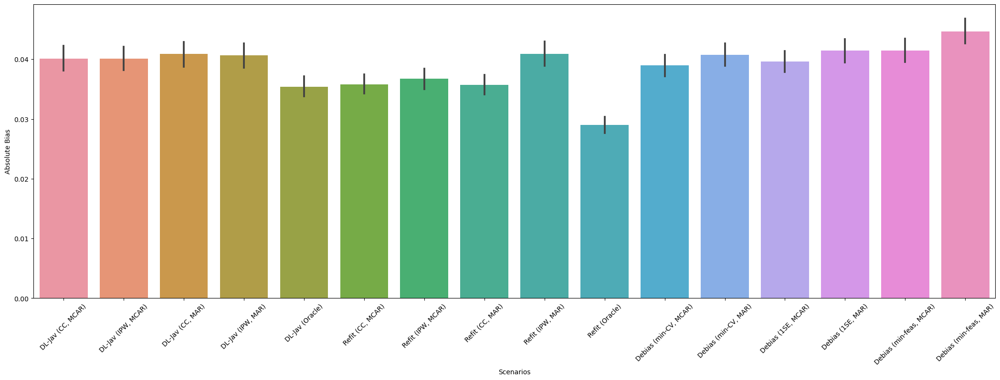

Scenario x1, beta1:



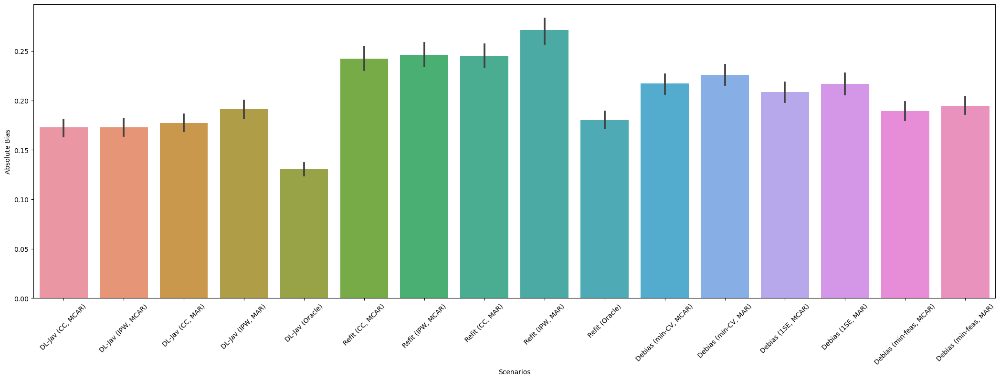

Scenario x1, beta2:



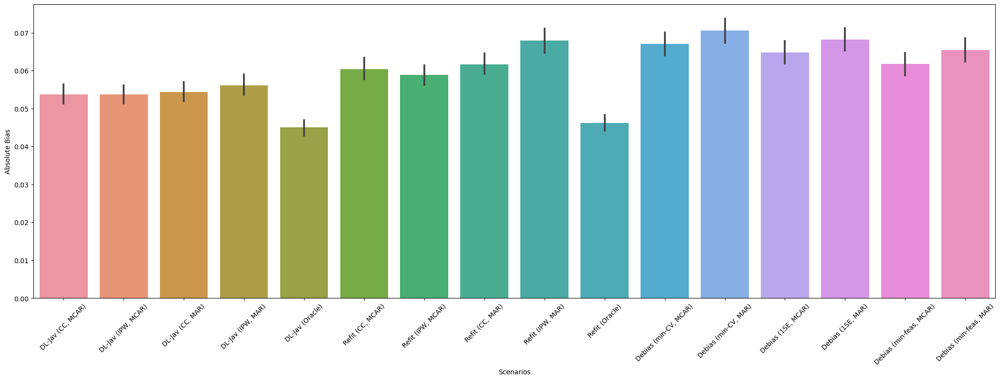

Scenario x2, beta0:



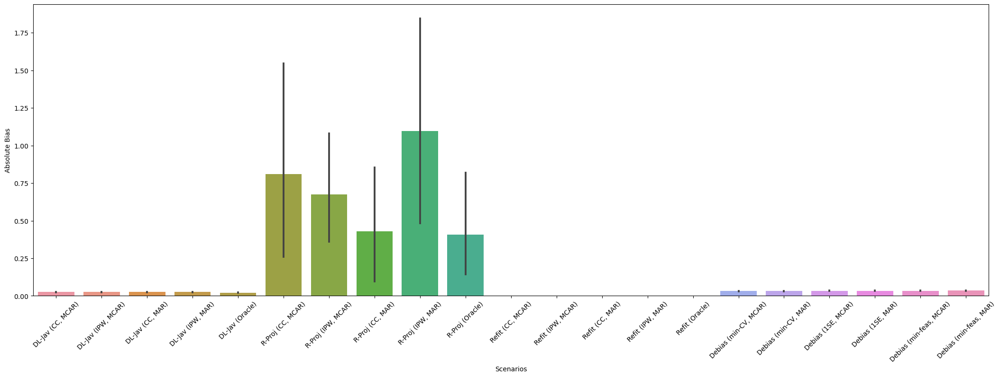

Scenario x2, beta1:



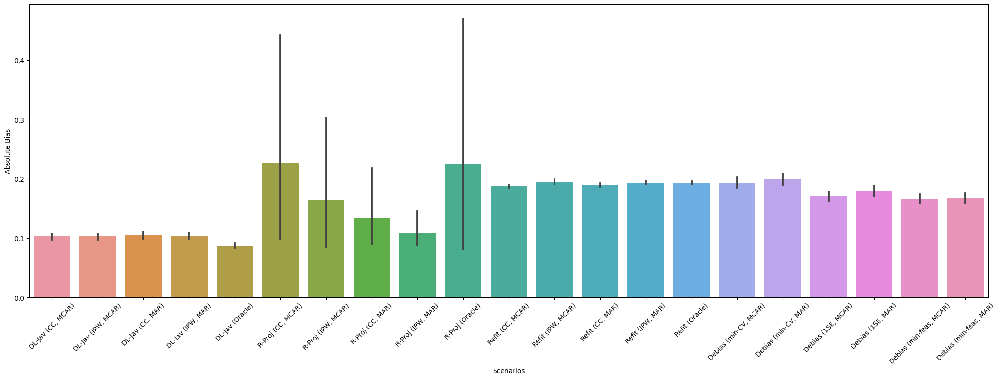

Scenario x2, beta2:



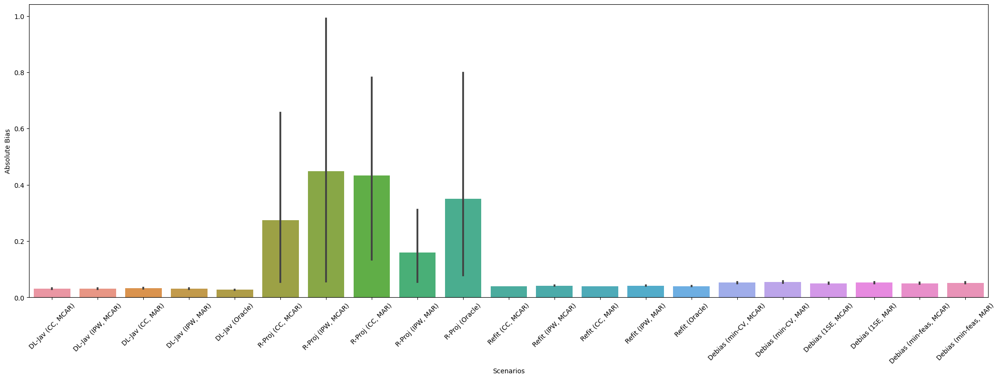

Scenario x3, beta0:



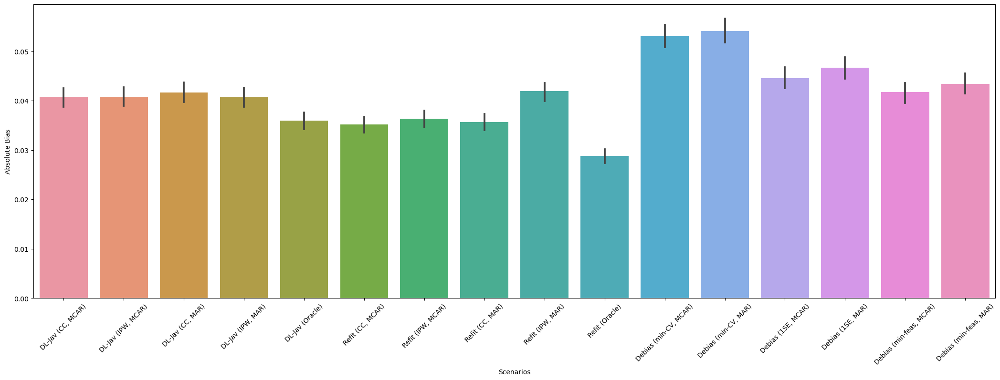

Scenario x3, beta1:



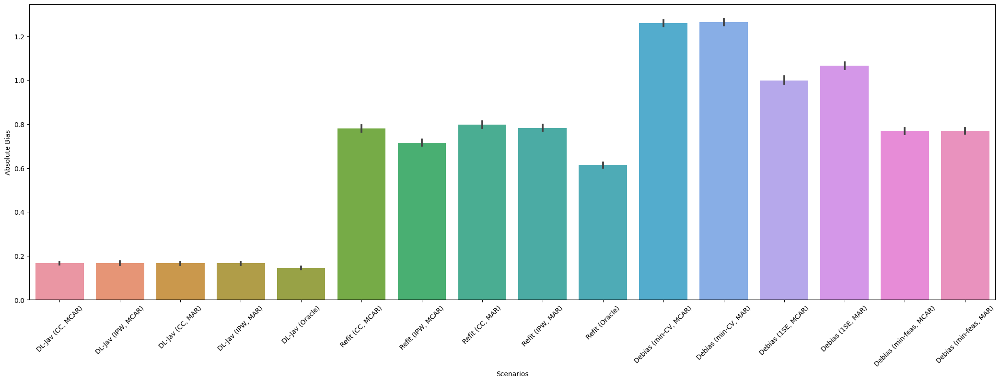

Scenario x3, beta2:



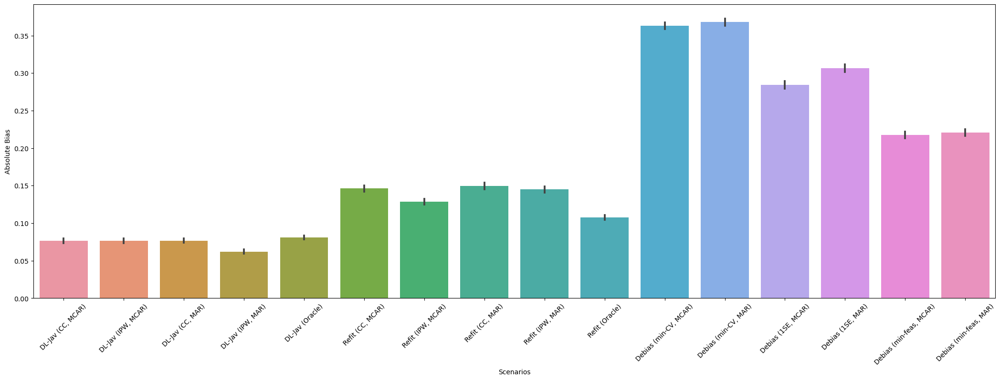

Scenario x4, beta0:



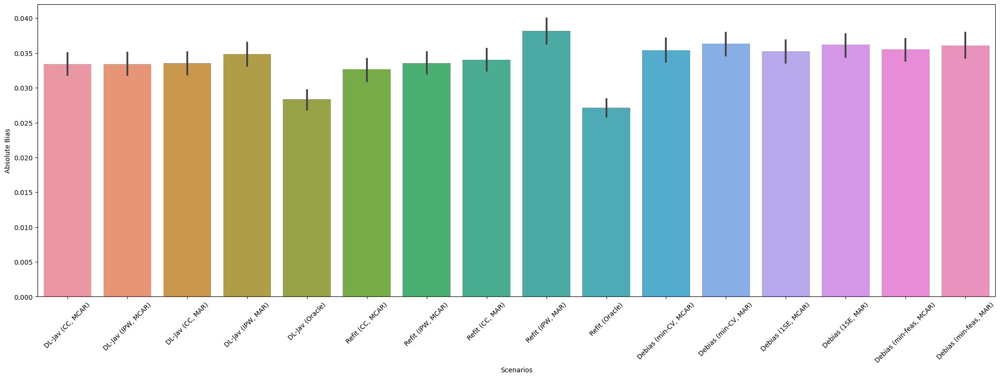

Scenario x4, beta1:



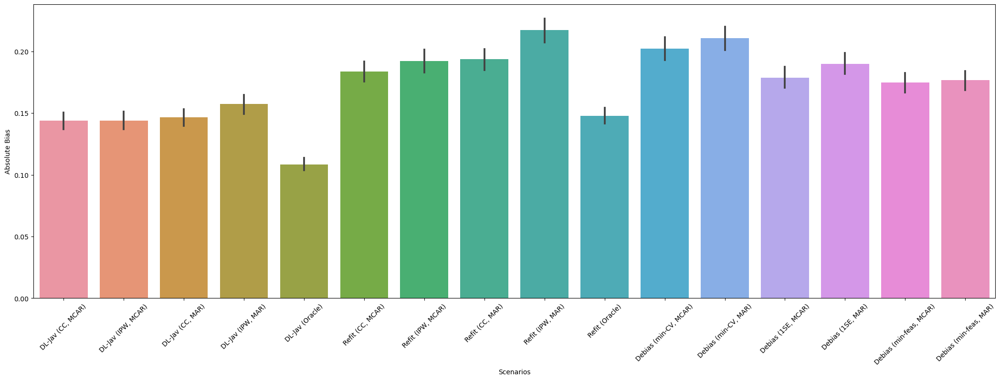

Scenario x4, beta2:



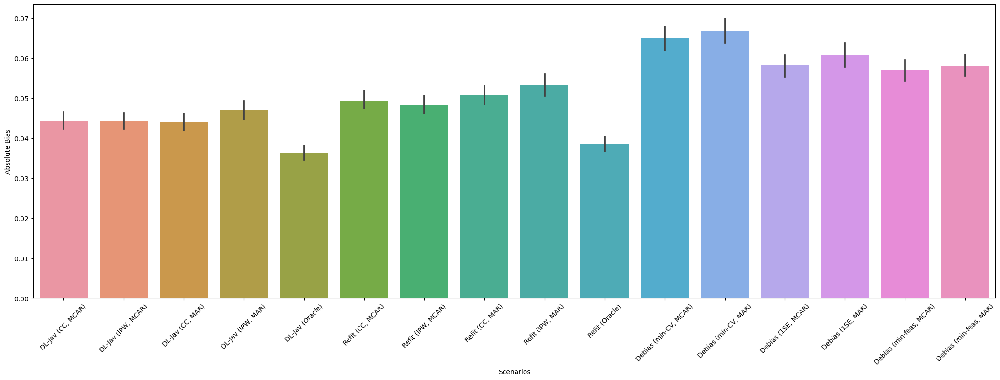

In [3]:
d = 1000
n= 900
B_repeat = 1000
for i in range(5):
    if i == 0:
        ## x0
        x = np.zeros((d,))
        x[0] = 1
    if i == 1:
        ## x1
        x = np.zeros((d,))
        x[0] = 1
        x[1] = 1/2
        x[2] = 1/4
        x[6] = 1/2
        x[7] = 1/8
    if i == 2:
        ## x2
        x = np.zeros((d,))
        x[99] = 1
    if i == 3:
        ## x3
        x = 1/np.linspace(1, d, d)
    if i == 4:
        ## x4
        x = 1/np.linspace(1, d, d)**2
    for k in range(3):
        if k == 0:
            s_beta = 5
            beta_0 = np.zeros((d,))
            beta_0[:s_beta] = np.sqrt(5)
        if k == 1:
            beta_0 = 1/np.sqrt(np.linspace(1, d, d))
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)
        if k == 2:
            beta_0 = 1/np.linspace(1, d, d)
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)

        # True regression function
        m_true = np.dot(x, beta_0)
        
        print('Scenario x'+str(i)+', beta'+str(k)+':\n')
        
        
        debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')
        refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')
        deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_1se.csv')
        deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_mincv.csv')
        deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_minfeas.csv')
        if (i == 0) or (i == 2):
            rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')
        
        # Bias Comparisons
        ## Debiased lasso (Javanmard and Montarani, 2014)
        Bias_df = pd.DataFrame({'Absolute Bias': abs(debl_res1['m_obs1'] - m_true), 
                                'Scenarios': np.repeat('DL-Jav (CC, MCAR)', B_repeat)})
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(debl_res1['m_ipw1'] - m_true), 
                                           'Scenarios': np.repeat('DL-Jav (IPW, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(debl_res1['m_obs2'] - m_true), 
                                           'Scenarios': np.repeat('DL-Jav (CC, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(debl_res1['m_ipw2'] - m_true), 
                                           'Scenarios': np.repeat('DL-Jav (IPW, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(debl_res1['m_full'] - m_true), 
                                           'Scenarios': np.repeat('DL-Jav (Oracle)', B_repeat)})], axis=0)
        
        ## Ridge projection
        if (i == 0) or (i == 2):
            Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_obs1'] - m_true), 
                                           'Scenarios': np.repeat('R-Proj (CC, MCAR)', B_repeat)})], axis=0)
            Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_ipw1'] - m_true), 
                                           'Scenarios': np.repeat('R-Proj (IPW, MCAR)', B_repeat)})], axis=0)
            Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_obs2'] - m_true), 
                                           'Scenarios': np.repeat('R-Proj (CC, MAR)', B_repeat)})], axis=0)
            Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_ipw2'] - m_true), 
                                           'Scenarios': np.repeat('R-Proj (IPW, MAR)', B_repeat)})], axis=0)
            Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_full'] - m_true), 
                                           'Scenarios': np.repeat('R-Proj (Oracle)', B_repeat)})], axis=0)
            
        ## Lasso Refitting
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(refit_res1['m_obs1'] - m_true), 
                                           'Scenarios': np.repeat('Refit (CC, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(refit_res1['m_ipw1'] - m_true), 
                                           'Scenarios': np.repeat('Refit (IPW, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(refit_res1['m_obs2'] - m_true), 
                                           'Scenarios': np.repeat('Refit (CC, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(refit_res1['m_ipw2'] - m_true), 
                                           'Scenarios': np.repeat('Refit (IPW, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(refit_res1['m_full'] - m_true), 
                                           'Scenarios': np.repeat('Refit (Oracle)', B_repeat)})], axis=0)
        
        ## Our proposed debiasing framework
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_mincv['m_deb1'] - m_true), 
                                           'Scenarios': np.repeat('Debias (min-CV, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_mincv['m_deb2'] - m_true), 
                                           'Scenarios': np.repeat('Debias (min-CV, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_1se['m_deb1'] - m_true), 
                                           'Scenarios': np.repeat('Debias (1SE, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_1se['m_deb2'] - m_true), 
                                           'Scenarios': np.repeat('Debias (1SE, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_minfeas['m_deb1'] - m_true), 
                                           'Scenarios': np.repeat('Debias (min-feas, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_minfeas['m_deb2'] - m_true), 
                                           'Scenarios': np.repeat('Debias (min-feas, MAR)', B_repeat)})], axis=0).reset_index()
        
        plt.figure(figsize=(26, 8))
        sns.barplot(y='Absolute Bias', x='Scenarios', data=Bias_df)
        plt.xticks(rotation=45)
        plt.show()

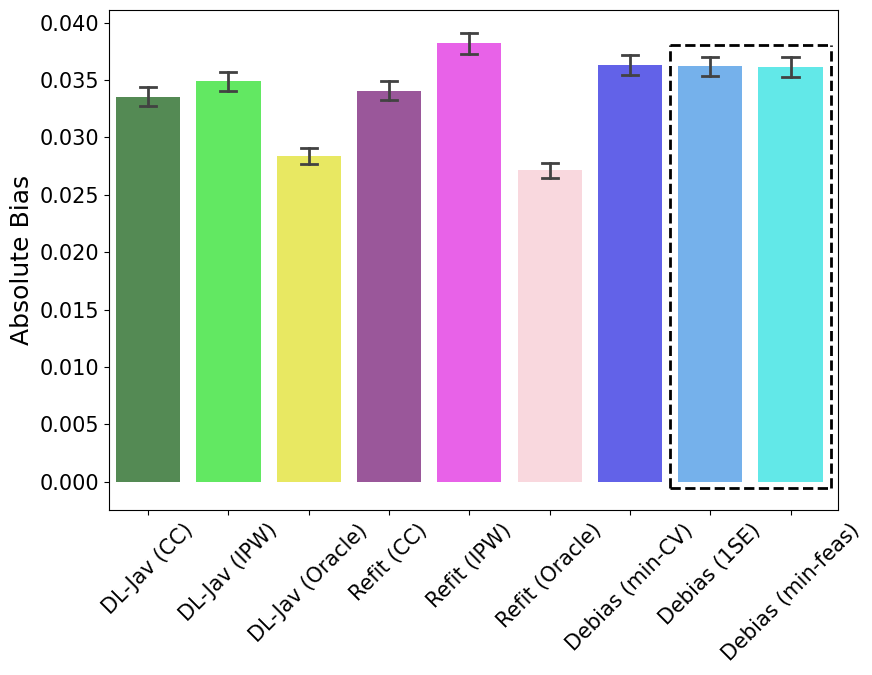

In [193]:
d = 1000
n = 900
B_repeat = 1000
i = 4
## x4
x = 1/np.linspace(1, d, d)**2

## beta 0
k = 0
s_beta = 5
beta_0 = np.zeros((d,))
beta_0[:s_beta] = np.sqrt(5)

# True regression function
m_true = np.dot(x, beta_0)

debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')
refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')
deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_1se.csv')
deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_mincv.csv')
deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_minfeas.csv')
if (i == 0) or (i == 2):
    rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')

# Bias Comparisons
## Debiased lasso (Javanmard and Montarani, 2014) MAR
Bias_df = pd.DataFrame({'Absolute Bias': abs(debl_res1['m_obs2'] - m_true), 
                        'Scenarios': np.repeat('DL-Jav (CC)', B_repeat)})
Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(debl_res1['m_ipw2'] - m_true), 
                                   'Scenarios': np.repeat('DL-Jav (IPW)', B_repeat)})], axis=0)
Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(debl_res1['m_full'] - m_true), 
                                   'Scenarios': np.repeat('DL-Jav (Oracle)', B_repeat)})], axis=0)

## Ridge projection MAR
if (i == 0) or (i == 2):
    Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_obs2'] - m_true), 
                                   'Scenarios': np.repeat('R-Proj (CC)', B_repeat)})], axis=0)
    Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_ipw2'] - m_true), 
                                   'Scenarios': np.repeat('R-Proj (IPW)', B_repeat)})], axis=0)
    Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_full'] - m_true), 
                                   'Scenarios': np.repeat('R-Proj (Oracle)', B_repeat)})], axis=0)
    
## Lasso Refitting MAR
Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(refit_res1['m_obs2'] - m_true), 
                                   'Scenarios': np.repeat('Refit (CC)', B_repeat)})], axis=0)
Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(refit_res1['m_ipw2'] - m_true), 
                                   'Scenarios': np.repeat('Refit (IPW)', B_repeat)})], axis=0)
Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(refit_res1['m_full'] - m_true), 
                                   'Scenarios': np.repeat('Refit (Oracle)', B_repeat)})], axis=0)

## Our proposed debiasing framework MAR
Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(deb_est_mincv['m_deb2'] - m_true), 
                                   'Scenarios': np.repeat('Debias (min-CV)', B_repeat)})], axis=0)
Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(deb_est_1se['m_deb2'] - m_true), 
                                   'Scenarios': np.repeat('Debias (1SE)', B_repeat)})], axis=0)
Bias_df = pd.concat([Bias_df, 
                     pd.DataFrame({'Absolute Bias': abs(deb_est_minfeas['m_deb2'] - m_true), 
                                   'Scenarios': np.repeat('Debias (min-feas)', B_repeat)})], axis=0).reset_index()


colors = ['darkgreen', 'lime', 'yellow', 'purple', 'magenta', 'pink', 'blue', 'dodgerblue', 'cyan']
# 'oldlace', 'orange', 'darkorange'
col_pal = dict(zip(list(Bias_df['Scenarios'].unique()), colors))


plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(9, 7))
sns.barplot(y='Absolute Bias', x='Scenarios', data=Bias_df, palette=col_pal, alpha=0.7, errorbar='se',
            capsize=.2, linewidth=6, errwidth=2)
plt.xlabel('')
plt.xticks(rotation=45)
plt.ylabel('Absolute Bias', size=18)
# plt.yticks(size=18)

refy2 = [-0.0005, 0.038]
refx2 = [6.5, 8.5]
plt.hlines(refy2, xmin=refx2[0], xmax=refx2[1], color='black', linestyles='--', linewidth=2)
plt.vlines(refx2, ymin=refy2[0], ymax=refy2[1], color='black', linestyles='--', linewidth=2)
plt.margins(x=0.01)
plt.tight_layout()
plt.savefig('./Figures/cirsym_abs_bias_x'+str(i)+'_beta'+str(k)+'_laperr.pdf', bbox_inches='tight')

### Coverage Probability (Laplace noise)

Scenario x0, beta0:



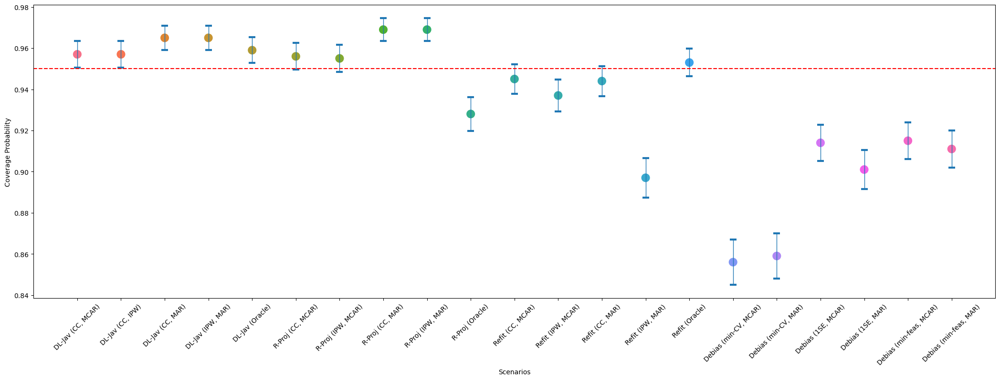

Scenario x0, beta1:



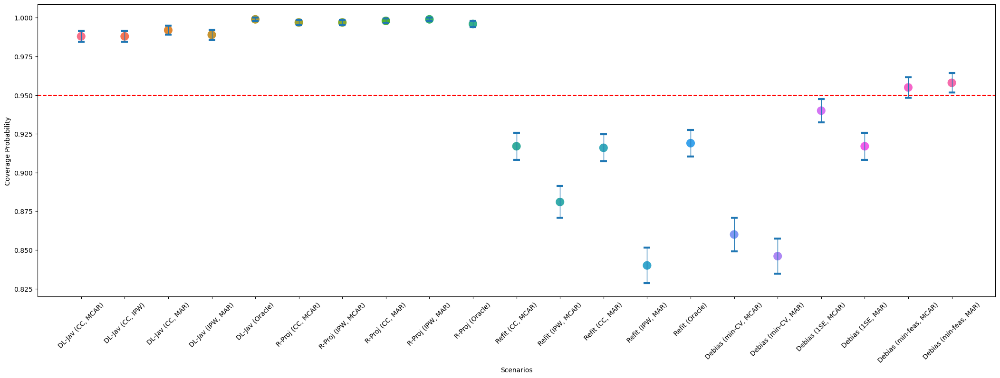

Scenario x0, beta2:



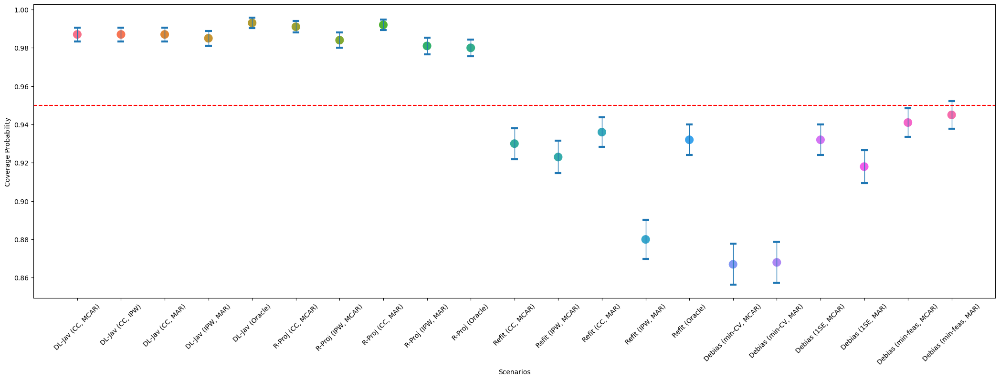

Scenario x1, beta0:



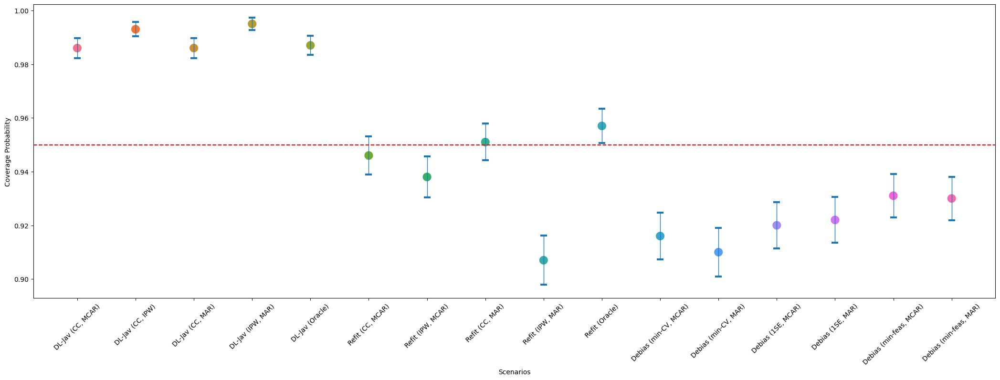

Scenario x1, beta1:



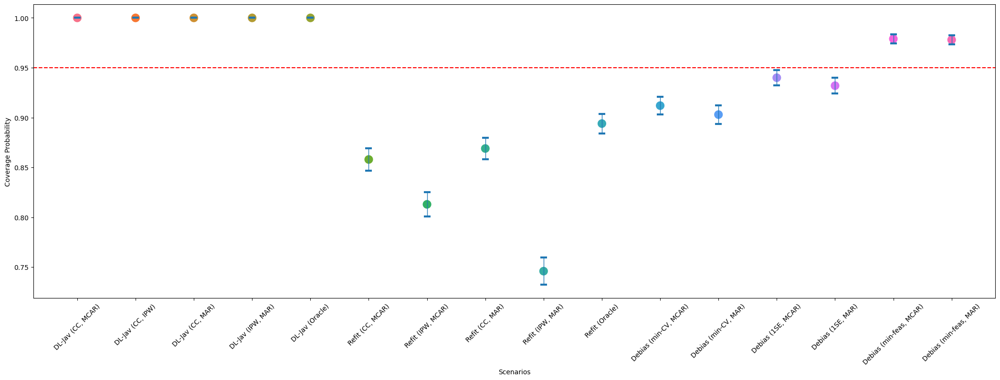

Scenario x1, beta2:



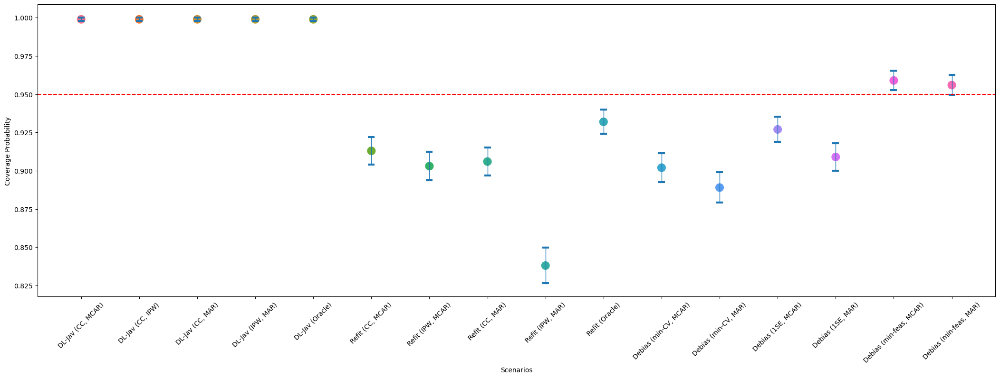

Scenario x2, beta0:



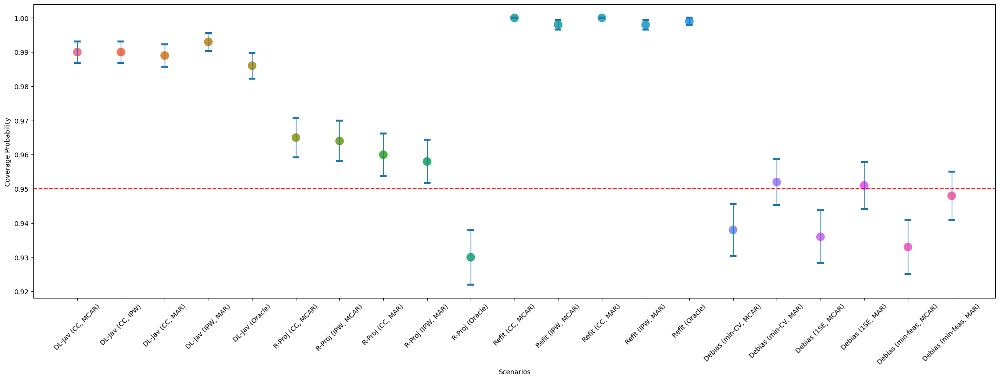

Scenario x2, beta1:



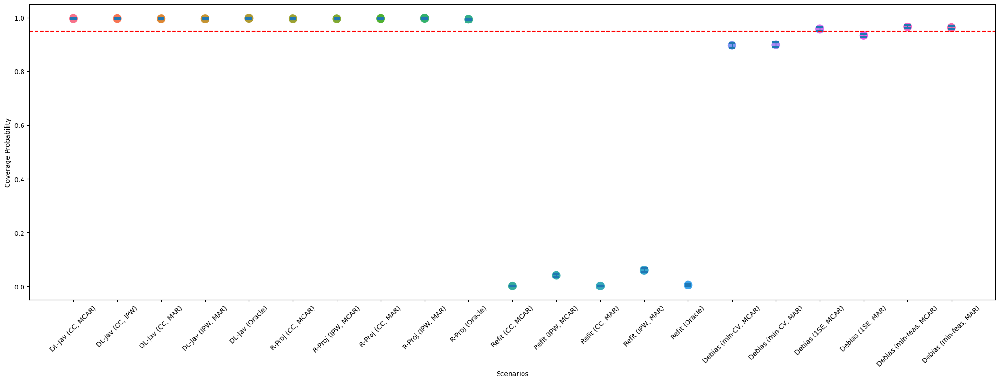

Scenario x2, beta2:



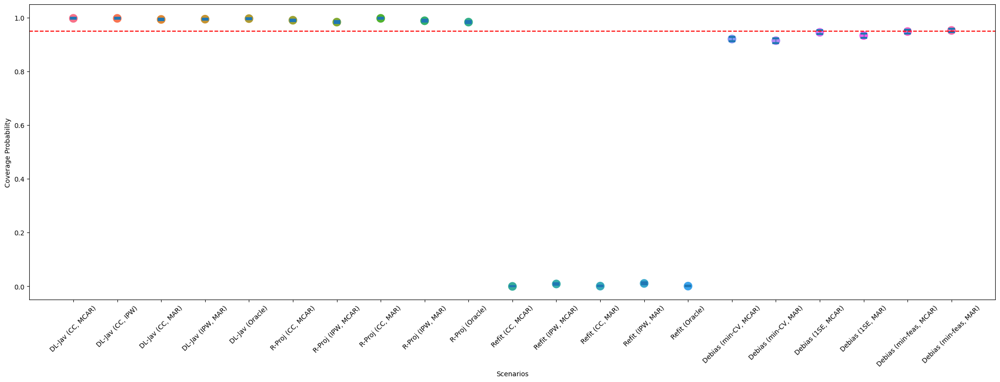

Scenario x3, beta0:



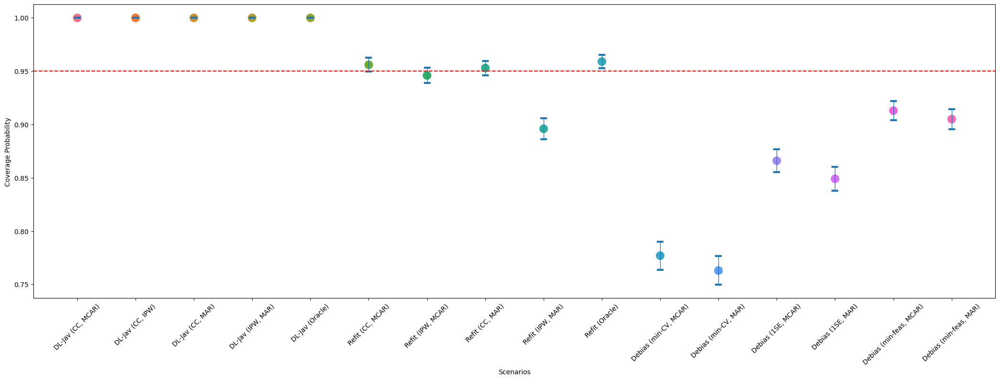

Scenario x3, beta1:



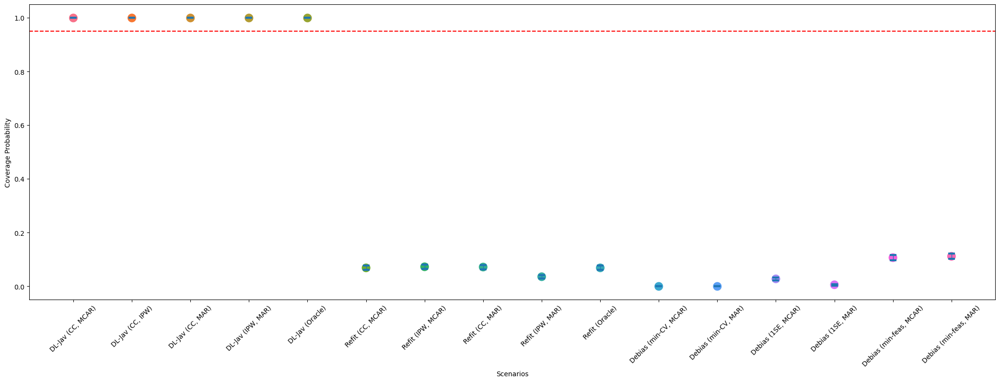

Scenario x3, beta2:



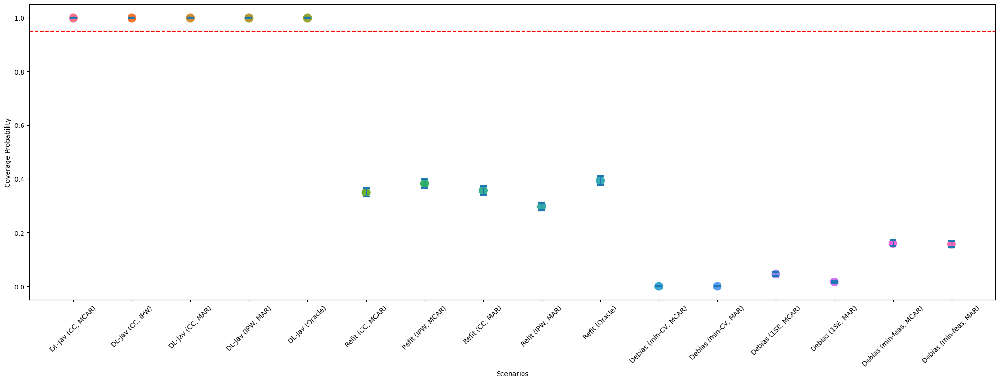

Scenario x4, beta0:



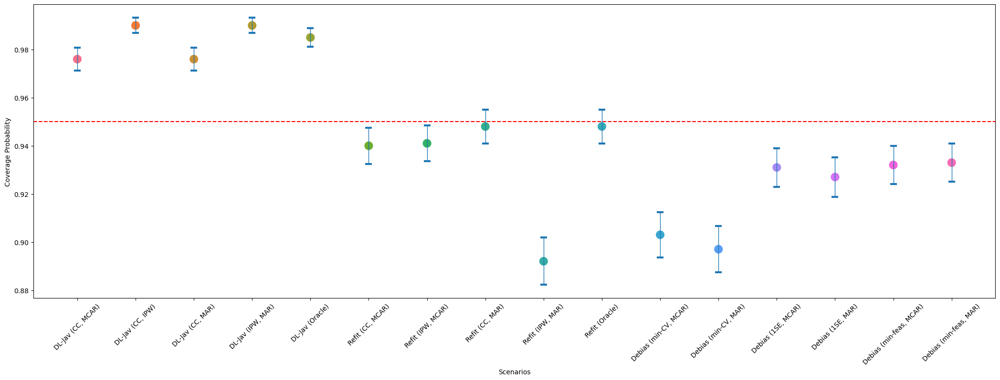

Scenario x4, beta1:



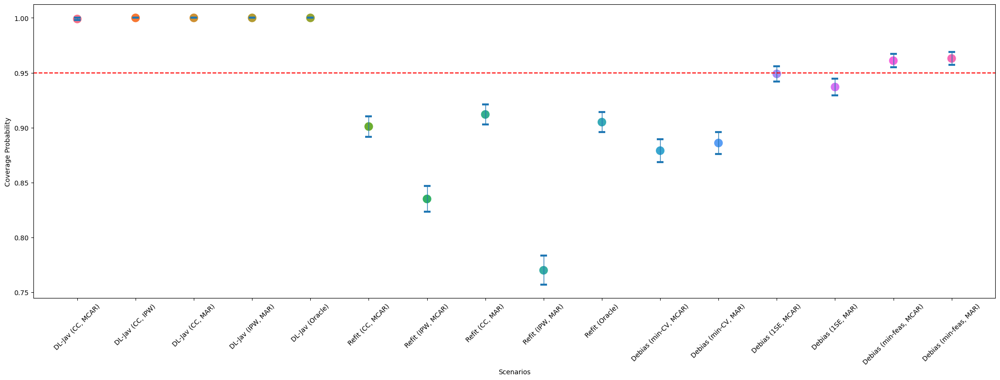

Scenario x4, beta2:



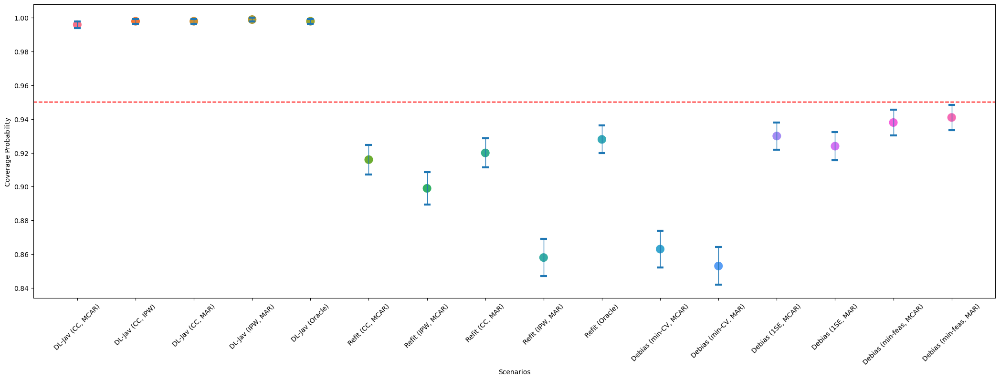

In [2]:
d = 1000
n= 900
B_repeat = 1000
for i in range(5):
    if i == 0:
        ## x0
        x = np.zeros((d,))
        x[0] = 1
    if i == 1:
        ## x1
        x = np.zeros((d,))
        x[0] = 1
        x[1] = 1/2
        x[2] = 1/4
        x[6] = 1/2
        x[7] = 1/8
    if i == 2:
        ## x2
        x = np.zeros((d,))
        x[99] = 1
    if i == 3:
        ## x3
        x = 1/np.linspace(1, d, d)
    if i == 4:
        ## x4
        x = 1/np.linspace(1, d, d)**2
    for k in range(3):
        if k == 0:
            s_beta = 5
            beta_0 = np.zeros((d,))
            beta_0[:s_beta] = np.sqrt(5)
        if k == 1:
            beta_0 = 1/np.sqrt(np.linspace(1, d, d))
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)
        if k == 2:
            beta_0 = 1/np.linspace(1, d, d)
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)

        # True regression function
        m_true = np.dot(x, beta_0)
        
        print('Scenario x'+str(i)+', beta'+str(k)+':\n')
        
        
        debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')
        refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')
        deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_1se.csv')
        deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_mincv.csv')
        deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_minfeas.csv')
        if (i == 0) or (i == 2):
            rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')
        
        
        # Coverage Probability
        ## Debiased lasso (Javanmard and Montarani, 2014)
        cov_prob = (debl_res1['m_obs1'] + debl_res1['ci_len_obs1']/2 >= m_true) & \
        (debl_res1['m_obs1'] - debl_res1['ci_len_obs1']/2 <= m_true)
        Cov_prob1 = pd.DataFrame({'Scenarios': ['DL-Jav (CC, MCAR)'], 
                                  'Coverage Probability': [np.mean(cov_prob)], 
                                  'Std': [np.std(cov_prob)], 
                                  'StdErr': [np.std(cov_prob)/np.sqrt(1000)]})
        
        cov_prob = (debl_res1['m_ipw1'] + debl_res1['ci_len_ipw1']/2 >= m_true) & \
        (debl_res1['m_ipw1'] - debl_res1['ci_len_ipw1']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['DL-Jav (CC, IPW)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (debl_res1['m_obs2'] + debl_res1['ci_len_obs2']/2 >= m_true) & \
        (debl_res1['m_obs2'] - debl_res1['ci_len_obs2']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['DL-Jav (CC, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (debl_res1['m_ipw2'] + debl_res1['ci_len_ipw2']/2 >= m_true) & \
        (debl_res1['m_ipw2'] - debl_res1['ci_len_ipw2']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['DL-Jav (IPW, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (debl_res1['m_full'] + debl_res1['ci_len_full']/2 >= m_true) & \
        (debl_res1['m_full'] - debl_res1['ci_len_full']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['DL-Jav (Oracle)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        ## Ridge projection
        if (i == 0) or (i == 2):
            cov_prob = (rproj_res1['m_obs1'] + rproj_res1['ci_len_obs1']/2 >= m_true) & \
            (rproj_res1['m_obs1'] - rproj_res1['ci_len_obs1']/2 <= m_true)
            Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (CC, MCAR)', np.mean(cov_prob), 
                                                   np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
            
            cov_prob = (rproj_res1['m_ipw1'] + rproj_res1['ci_len_ipw1']/2 >= m_true) & \
            (rproj_res1['m_ipw1'] - rproj_res1['ci_len_ipw1']/2 <= m_true)
            Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (IPW, MCAR)', np.mean(cov_prob), 
                                                   np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
            
            cov_prob = (rproj_res1['m_obs2'] + rproj_res1['ci_len_obs2']/2 >= m_true) & \
            (rproj_res1['m_obs2'] - rproj_res1['ci_len_obs2']/2 <= m_true)
            Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (CC, MAR)', np.mean(cov_prob), 
                                                   np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
            
            cov_prob = (rproj_res1['m_ipw2'] + rproj_res1['ci_len_ipw2']/2 >= m_true) & \
            (rproj_res1['m_ipw2'] - rproj_res1['ci_len_ipw2']/2 <= m_true)
            Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (IPW, MAR)', np.mean(cov_prob), 
                                                   np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
            
            cov_prob = (rproj_res1['m_full'] + rproj_res1['ci_len_full']/2 >= m_true) & \
            (rproj_res1['m_full'] - rproj_res1['ci_len_full']/2 <= m_true)
            Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (Oracle)', np.mean(cov_prob), 
                                                   np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        ## Lasso refitting
        cov_prob = (refit_res1['m_obs1'] + refit_res1['ci_len_obs1']/2 >= m_true) & \
        (refit_res1['m_obs1'] - refit_res1['ci_len_obs1']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (CC, MCAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (refit_res1['m_ipw1'] + refit_res1['ci_len_ipw1']/2 >= m_true) & \
        (refit_res1['m_ipw1'] - refit_res1['ci_len_ipw1']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (IPW, MCAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (refit_res1['m_obs2'] + refit_res1['ci_len_obs2']/2 >= m_true) & \
        (refit_res1['m_obs2'] - refit_res1['ci_len_obs2']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (CC, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (refit_res1['m_ipw2'] + refit_res1['ci_len_ipw2']/2 >= m_true) & \
        (refit_res1['m_ipw2'] - refit_res1['ci_len_ipw2']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (IPW, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (refit_res1['m_full'] + refit_res1['ci_len_full']/2 >= m_true) & \
        (refit_res1['m_full'] - refit_res1['ci_len_full']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (Oracle)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        # Proposed framework   
        cov_prob = (deb_est_mincv['m_deb1'] + deb_est_mincv['asym_se1']*deb_est_mincv['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_mincv['m_deb1'] - deb_est_mincv['asym_se1']*deb_est_mincv['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (min-CV, MCAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (deb_est_mincv['m_deb2'] + deb_est_mincv['asym_se2']*deb_est_mincv['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_mincv['m_deb2'] - deb_est_mincv['asym_se2']*deb_est_mincv['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (min-CV, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (deb_est_1se['m_deb1'] + deb_est_1se['asym_se1']*deb_est_1se['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_1se['m_deb1'] - deb_est_1se['asym_se1']*deb_est_1se['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (1SE, MCAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (deb_est_1se['m_deb2'] + deb_est_1se['asym_se2']*deb_est_1se['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_1se['m_deb2'] - deb_est_1se['asym_se2']*deb_est_1se['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (1SE, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (deb_est_minfeas['m_deb1'] + deb_est_minfeas['asym_se1']*deb_est_minfeas['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_minfeas['m_deb1'] - deb_est_minfeas['asym_se1']*deb_est_minfeas['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (min-feas, MCAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (deb_est_minfeas['m_deb2'] + deb_est_minfeas['asym_se2']*deb_est_minfeas['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_minfeas['m_deb2'] - deb_est_minfeas['asym_se2']*deb_est_minfeas['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (min-feas, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        plt.figure(figsize=(26,8))
        sns.scatterplot(x='Scenarios', y='Coverage Probability', data=Cov_prob1, hue='Scenarios', 
                        s=200, legend=False)
        # sns.pointplot(x='Scenarios', y='Coverage Probability', errorbar='sd', data=Cov_prob1, hue='Scenarios')
        # plt.scatter(Cov_prob1['Scenarios'], Cov_prob1['Coverage Probability'])
        plt.errorbar(Cov_prob1['Scenarios'], Cov_prob1['Coverage Probability'], 
                     yerr=Cov_prob1['StdErr'], ls='none', capsize=5, elinewidth=1, capthick=3)
        plt.axhline(y=0.95, color='red', linestyle='dashed')
        plt.xticks(rotation=45)
        plt.show()

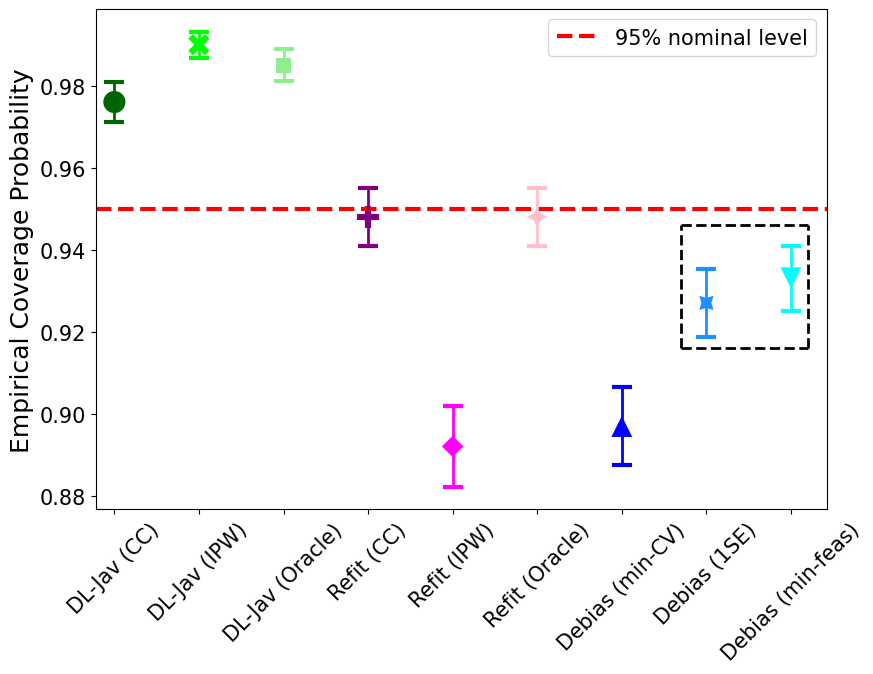

In [161]:
d = 1000
n = 900
B_repeat = 1000
i = 4
## x4
x = 1/np.linspace(1, d, d)**2

## beta 0
k = 0
s_beta = 5
beta_0 = np.zeros((d,))
beta_0[:s_beta] = np.sqrt(5)

# True regression function
m_true = np.dot(x, beta_0)

debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')
refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')
deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_1se.csv')
deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_mincv.csv')
deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_minfeas.csv')
if (i == 0) or (i == 2):
    rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')

# Coverage Probability
## Debiased lasso (Javanmard and Montarani, 2014) MAR
cov_prob = (debl_res1['m_obs2'] + debl_res1['ci_len_obs2']/2 >= m_true) & \
(debl_res1['m_obs2'] - debl_res1['ci_len_obs2']/2 <= m_true)
Cov_prob1 = pd.DataFrame({'Scenarios': ['DL-Jav (CC)'], 
                          'Coverage Probability': [np.mean(cov_prob)], 
                          'Std': [np.std(cov_prob)], 
                          'StdErr': [np.std(cov_prob)/np.sqrt(1000)]})

cov_prob = (debl_res1['m_ipw2'] + debl_res1['ci_len_ipw2']/2 >= m_true) & \
(debl_res1['m_ipw2'] - debl_res1['ci_len_ipw2']/2 <= m_true)
Cov_prob1.loc[len(Cov_prob1.index)] = ['DL-Jav (IPW)', np.mean(cov_prob), 
                                       np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]

cov_prob = (debl_res1['m_full'] + debl_res1['ci_len_full']/2 >= m_true) & \
(debl_res1['m_full'] - debl_res1['ci_len_full']/2 <= m_true)
Cov_prob1.loc[len(Cov_prob1.index)] = ['DL-Jav (Oracle)', np.mean(cov_prob), 
                                       np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]

## Ridge projection MAR
if (i == 0) or (i == 2):
    cov_prob = (rproj_res1['m_obs2'] + rproj_res1['ci_len_obs2']/2 >= m_true) & \
    (rproj_res1['m_obs2'] - rproj_res1['ci_len_obs2']/2 <= m_true)
    Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (CC)', np.mean(cov_prob), 
                                           np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
    
    cov_prob = (rproj_res1['m_ipw2'] + rproj_res1['ci_len_ipw2']/2 >= m_true) & \
    (rproj_res1['m_ipw2'] - rproj_res1['ci_len_ipw2']/2 <= m_true)
    Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (IPW)', np.mean(cov_prob), 
                                           np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
    
    cov_prob = (rproj_res1['m_full'] + rproj_res1['ci_len_full']/2 >= m_true) & \
    (rproj_res1['m_full'] - rproj_res1['ci_len_full']/2 <= m_true)
    Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (Oracle)', np.mean(cov_prob), 
                                           np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]

## Lasso refitting MAR
cov_prob = (refit_res1['m_obs2'] + refit_res1['ci_len_obs2']/2 >= m_true) & \
(refit_res1['m_obs2'] - refit_res1['ci_len_obs2']/2 <= m_true)
Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (CC)', np.mean(cov_prob), 
                                       np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]

cov_prob = (refit_res1['m_ipw2'] + refit_res1['ci_len_ipw2']/2 >= m_true) & \
(refit_res1['m_ipw2'] - refit_res1['ci_len_ipw2']/2 <= m_true)
Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (IPW)', np.mean(cov_prob), 
                                       np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]

cov_prob = (refit_res1['m_full'] + refit_res1['ci_len_full']/2 >= m_true) & \
(refit_res1['m_full'] - refit_res1['ci_len_full']/2 <= m_true)
Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (Oracle)', np.mean(cov_prob), 
                                       np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]

# Proposed framework  MAR 
cov_prob = (deb_est_mincv['m_deb2'] + deb_est_mincv['asym_se2']*deb_est_mincv['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
(deb_est_mincv['m_deb2'] - deb_est_mincv['asym_se2']*deb_est_mincv['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (min-CV)', np.mean(cov_prob), 
                                       np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]

cov_prob = (deb_est_1se['m_deb2'] + deb_est_1se['asym_se2']*deb_est_1se['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
(deb_est_1se['m_deb2'] - deb_est_1se['asym_se2']*deb_est_1se['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (1SE)', np.mean(cov_prob), 
                                       np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]

cov_prob = (deb_est_minfeas['m_deb2'] + deb_est_minfeas['asym_se2']*deb_est_minfeas['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
(deb_est_minfeas['m_deb2'] - deb_est_minfeas['asym_se2']*deb_est_minfeas['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (min-feas)', np.mean(cov_prob), 
                                       np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]


colors = ['darkgreen', 'lime', 'yellow', 'purple', 'magenta', 'pink', 'blue', 'dodgerblue', 'cyan']
# 'oldlace', 'orange', 'darkorange'
col_pal = dict(zip(list(Bias_df['Scenarios'].unique()), colors))

plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(9,7))
# lines={'linestyle': 'None'}
# plt.rc('lines', **lines)
sns.scatterplot(x='Scenarios', y='Coverage Probability', data=Cov_prob1, hue='Scenarios', style='Scenarios',
                s=300, legend=False, palette=col_pal)
# sns.pointplot(x='Scenarios', y='Coverage Probability', errorbar='sd', data=Cov_prob1, hue='Scenarios')
# plt.errorbar(Cov_prob1['Scenarios'], Cov_prob1['Coverage Probability'], 
#                   yerr=Cov_prob1['StdErr'], fmt='b', capthick=2, linewidth=2, ecolor=colors)
plt.axhline(y=0.95, color='red', linestyle='dashed', label='95% nominal level', linewidth=3)
for pos, y, err, color in zip(Cov_prob1['Scenarios'], Cov_prob1['Coverage Probability'], Cov_prob1['StdErr'], colors):
    plt.errorbar(pos, y, err, lw=2, ls='none', capsize=7, capthick=3, color=color)
plt.xticks(rotation=45)
plt.xlabel('')
plt.ylabel('Empirical Coverage Probability', size=18)
plt.legend()

refy2 = [0.916, 0.946]
refx2 = [6.7, 8.2]
plt.hlines(refy2, xmin=refx2[0], xmax=refx2[1], color='black', linestyles='--', linewidth=2)
plt.vlines(refx2, ymin=refy2[0], ymax=refy2[1], color='black', linestyles='--', linewidth=2)

plt.margins(x=0.027)
plt.tight_layout()
plt.savefig('./Figures/cirsym_coverage_x'+str(i)+'_beta'+str(k)+'_laperr.pdf', bbox_inches='tight')

### Lengths of Confidence Intervals (Laplace noise)

Scenario x0, beta0:



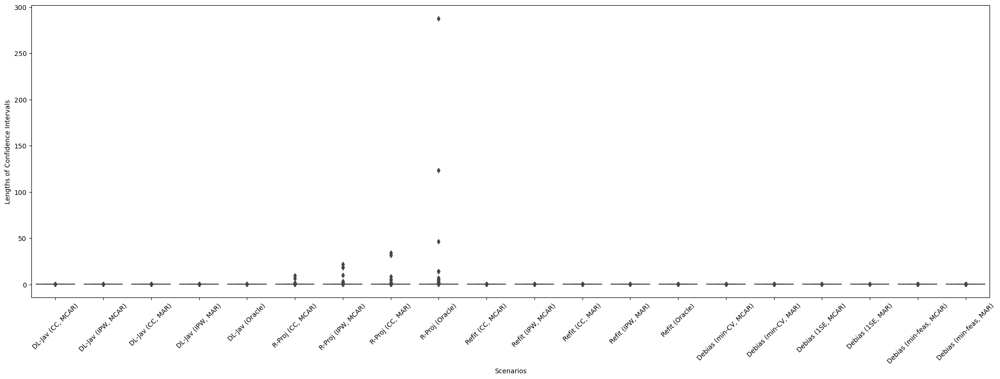

Scenario x0, beta1:



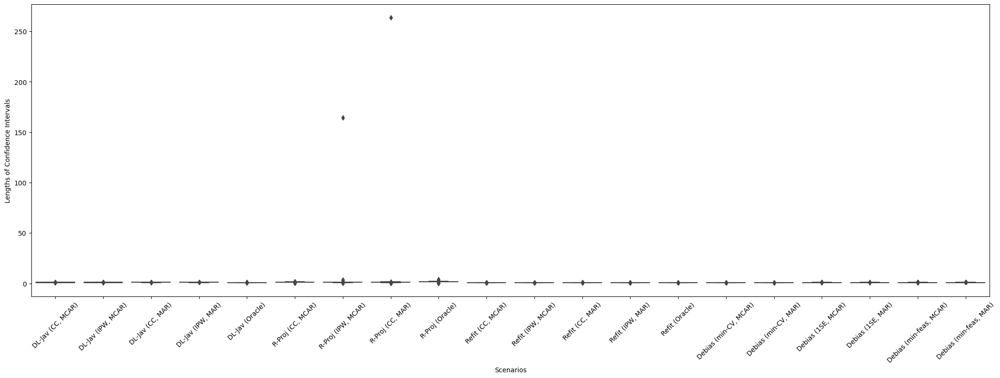

Scenario x0, beta2:



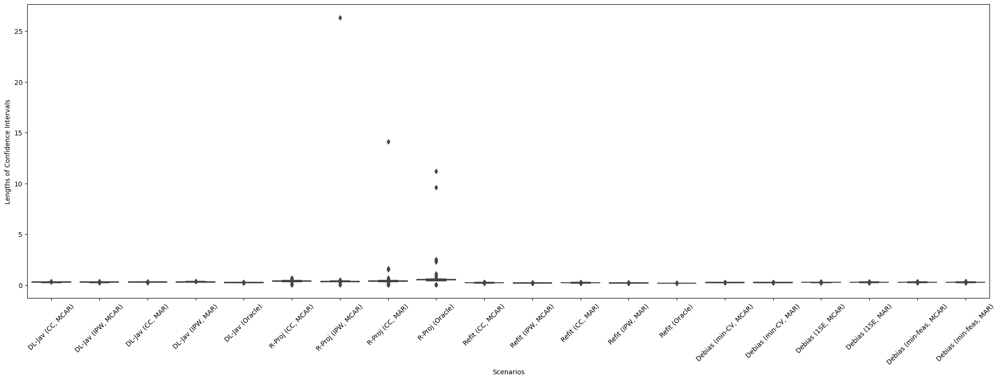

Scenario x1, beta0:



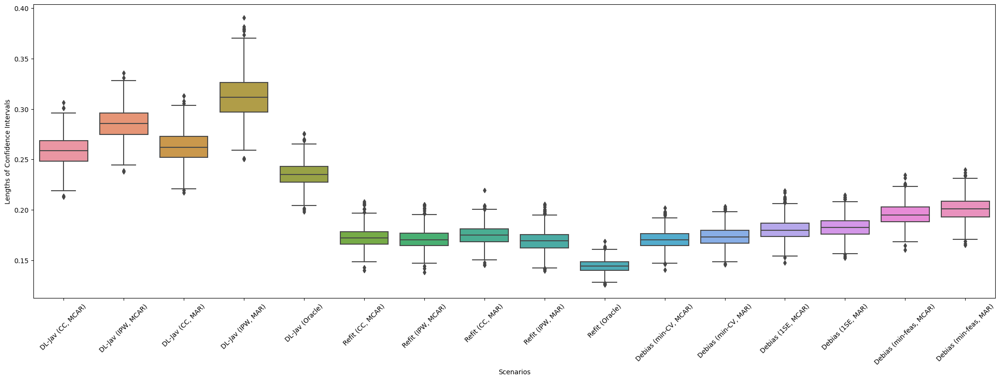

Scenario x1, beta1:



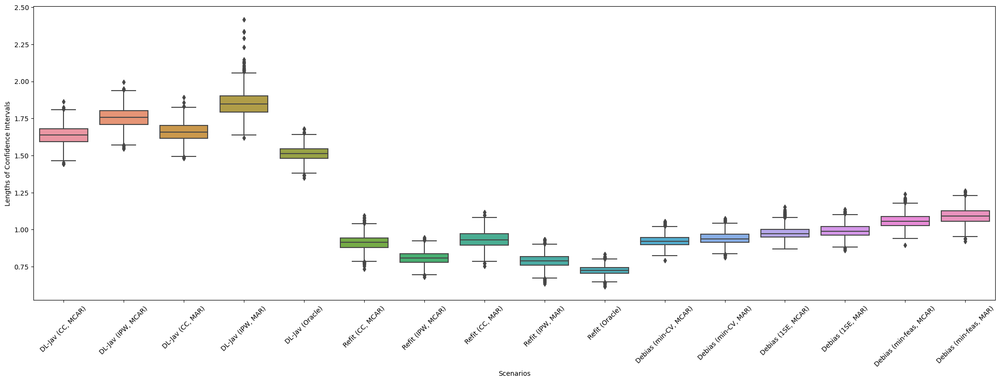

Scenario x1, beta2:



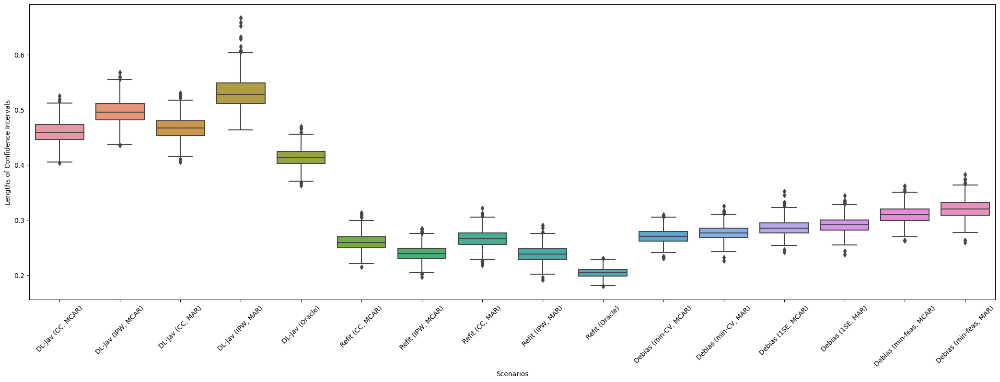

Scenario x2, beta0:



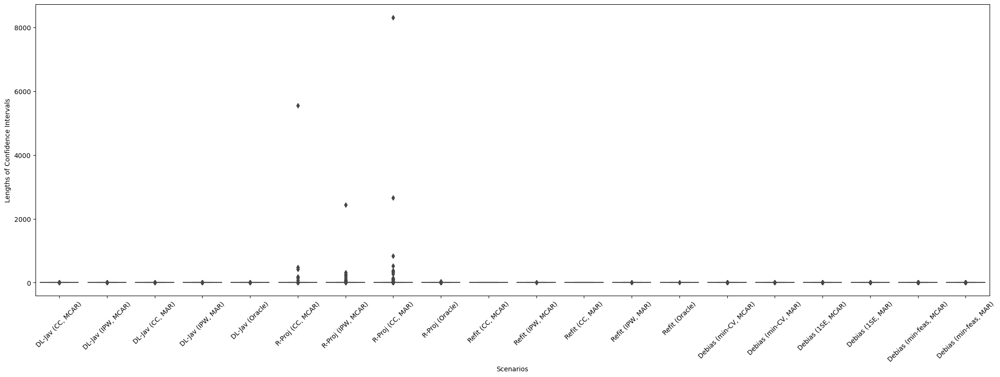

Scenario x2, beta1:



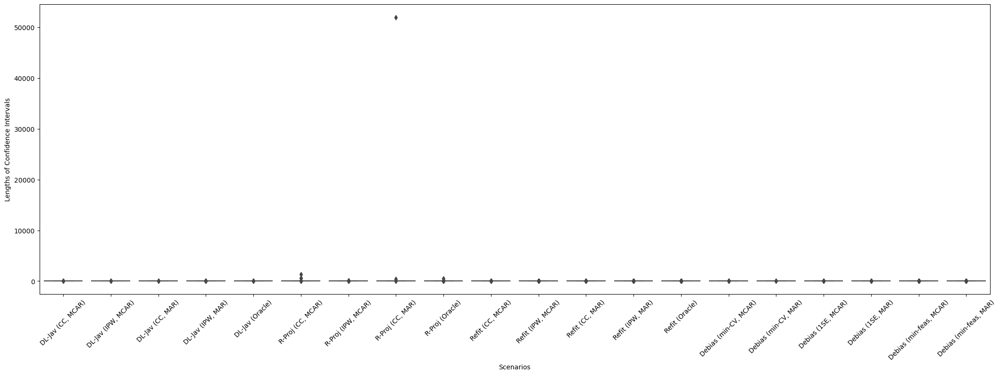

Scenario x2, beta2:



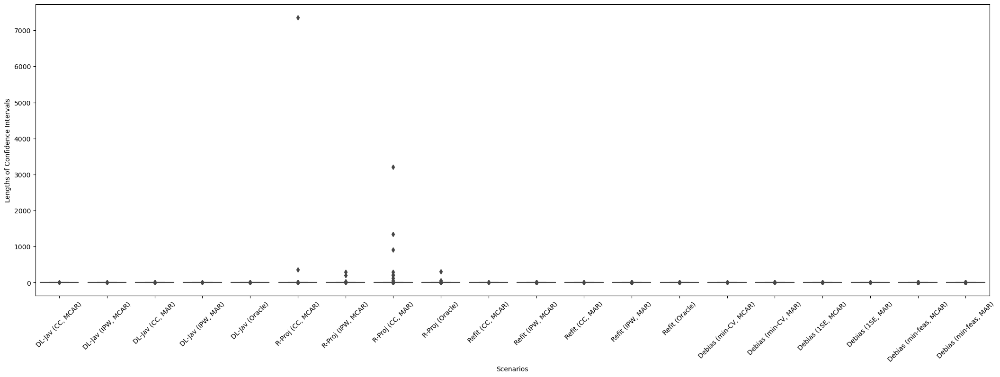

Scenario x3, beta0:



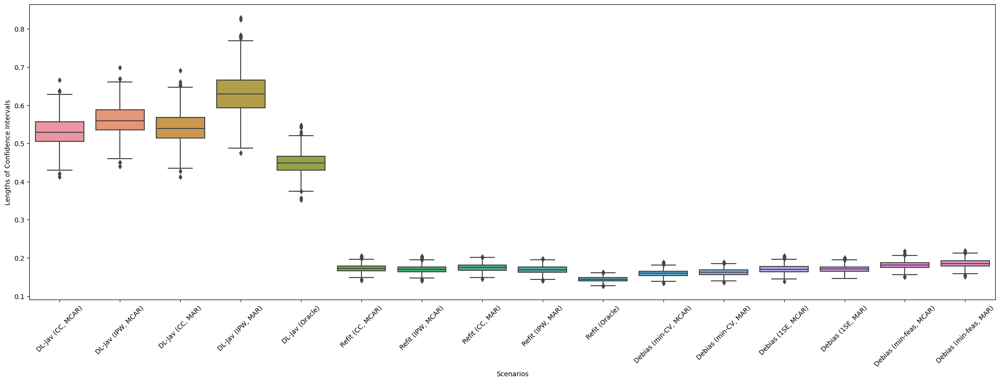

Scenario x3, beta1:



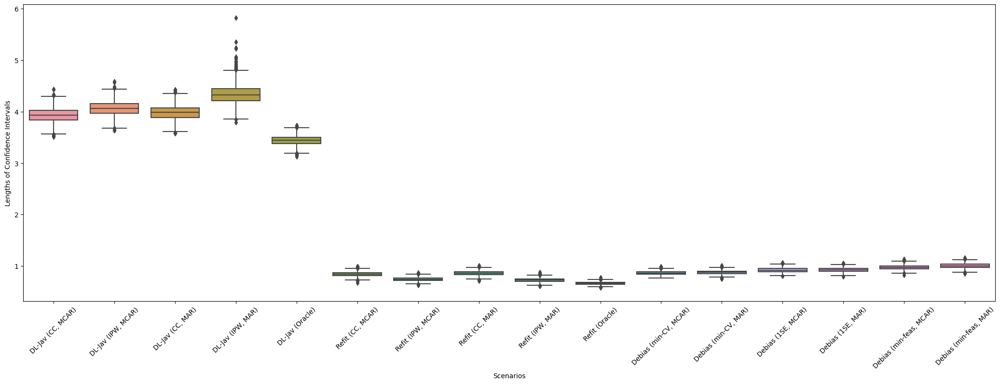

Scenario x3, beta2:



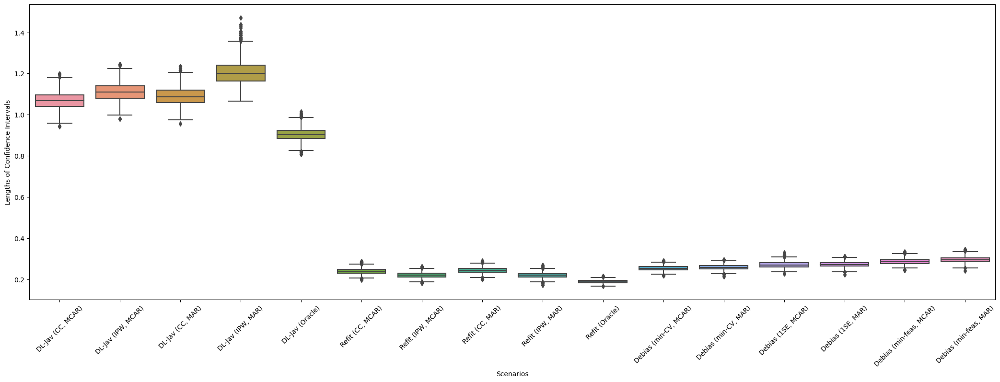

Scenario x4, beta0:



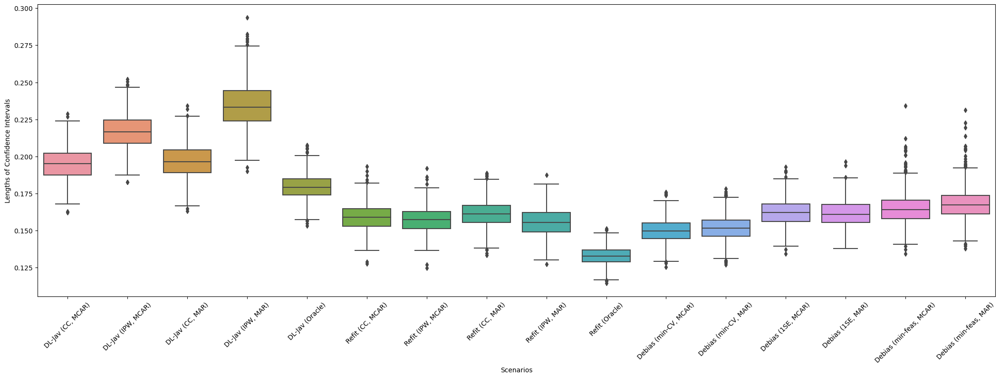

Scenario x4, beta1:



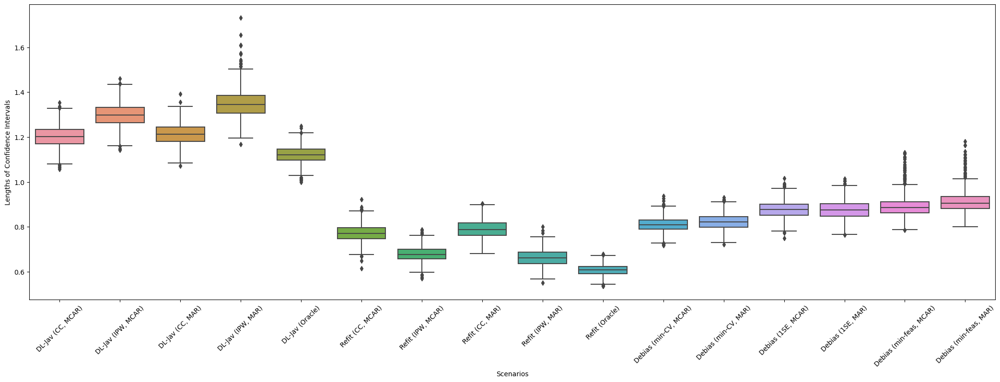

Scenario x4, beta2:



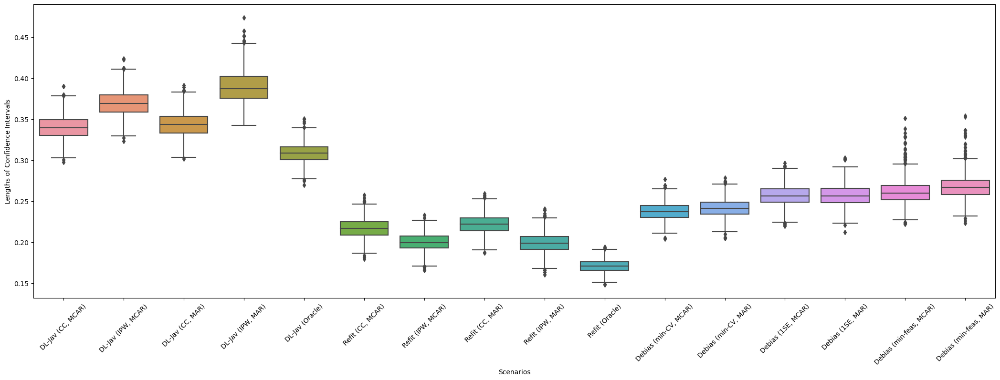

In [4]:
d = 1000
n= 900
B_repeat = 1000
for i in range(5):
    if i == 0:
        ## x0
        x = np.zeros((d,))
        x[0] = 1
    if i == 1:
        ## x1
        x = np.zeros((d,))
        x[0] = 1
        x[1] = 1/2
        x[2] = 1/4
        x[6] = 1/2
        x[7] = 1/8
    if i == 2:
        ## x2
        x = np.zeros((d,))
        x[99] = 1
    if i == 3:
        ## x3
        x = 1/np.linspace(1, d, d)
    if i == 4:
        ## x4
        x = 1/np.linspace(1, d, d)**2
    for k in range(3):
        if k == 0:
            s_beta = 5
            beta_0 = np.zeros((d,))
            beta_0[:s_beta] = np.sqrt(5)
        if k == 1:
            beta_0 = 1/np.sqrt(np.linspace(1, d, d))
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)
        if k == 2:
            beta_0 = 1/np.linspace(1, d, d)
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)

        # True regression function
        m_true = np.dot(x, beta_0)
        
        print('Scenario x'+str(i)+', beta'+str(k)+':\n')
        
        
        debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')
        refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')
        deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_1se.csv')
        deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_mincv.csv')
        deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_minfeas.csv')
        if (i == 0) or (i == 2):
            rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')
        
        # Lengths of confidence intervals
        ## Debiased lasso (Javanmard and Montarani, 2014)
        CIlen_df = pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_obs1'], 
                                'Scenarios': np.repeat('DL-Jav (CC, MCAR)', B_repeat)})
        CIlen_df = pd.concat([CIlen_df, 
                             pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_ipw1'], 
                                           'Scenarios': np.repeat('DL-Jav (IPW, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                             pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_obs2'], 
                                           'Scenarios': np.repeat('DL-Jav (CC, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                             pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_ipw2'], 
                                           'Scenarios': np.repeat('DL-Jav (IPW, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                             pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_full'], 
                                           'Scenarios': np.repeat('DL-Jav (Oracle)', B_repeat)})], axis=0)
        
        ## Ridge projection
        if (i == 0) or (i == 2):
            CIlen_df = pd.concat([CIlen_df, 
                                  pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_obs1'], 
                                               'Scenarios': np.repeat('R-Proj (CC, MCAR)', B_repeat)})], axis=0)
            CIlen_df = pd.concat([CIlen_df, 
                                  pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_ipw1'], 
                                               'Scenarios': np.repeat('R-Proj (IPW, MCAR)', B_repeat)})], axis=0)
            CIlen_df = pd.concat([CIlen_df, 
                                  pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_obs2'], 
                                               'Scenarios': np.repeat('R-Proj (CC, MAR)', B_repeat)})], axis=0)
            CIlen_df = pd.concat([CIlen_df, 
                                  pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_ipw2'], 
                                               'Scenarios': np.repeat('R-Proj (CC, MAR)', B_repeat)})], axis=0)
            CIlen_df = pd.concat([CIlen_df, 
                                  pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_full'], 
                                               'Scenarios': np.repeat('R-Proj (Oracle)', B_repeat)})], axis=0)
        
        ## Lasso refitting
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_obs1'], 
                                            'Scenarios': np.repeat('Refit (CC, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_ipw1'], 
                                            'Scenarios': np.repeat('Refit (IPW, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_obs2'], 
                                            'Scenarios': np.repeat('Refit (CC, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_ipw2'], 
                                            'Scenarios': np.repeat('Refit (IPW, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_full'], 
                                            'Scenarios': np.repeat('Refit (Oracle)', B_repeat)})], axis=0)
        
        ## Proposed debiasing framework
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_mincv['asym_se1']*deb_est_mincv['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (min-CV, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_mincv['asym_se2']*deb_est_mincv['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (min-CV, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_1se['asym_se1']*deb_est_1se['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (1SE, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_1se['asym_se2']*deb_est_1se['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (1SE, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_minfeas['asym_se1']*deb_est_minfeas['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (min-feas, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_minfeas['asym_se2']*deb_est_minfeas['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (min-feas, MAR)', B_repeat)})], axis=0)
        
        plt.figure(figsize=(26, 8))
        sns.boxplot(y='Lengths of Confidence Intervals', x='Scenarios', data=CIlen_df)
        plt.xticks(rotation=45)
        plt.show()

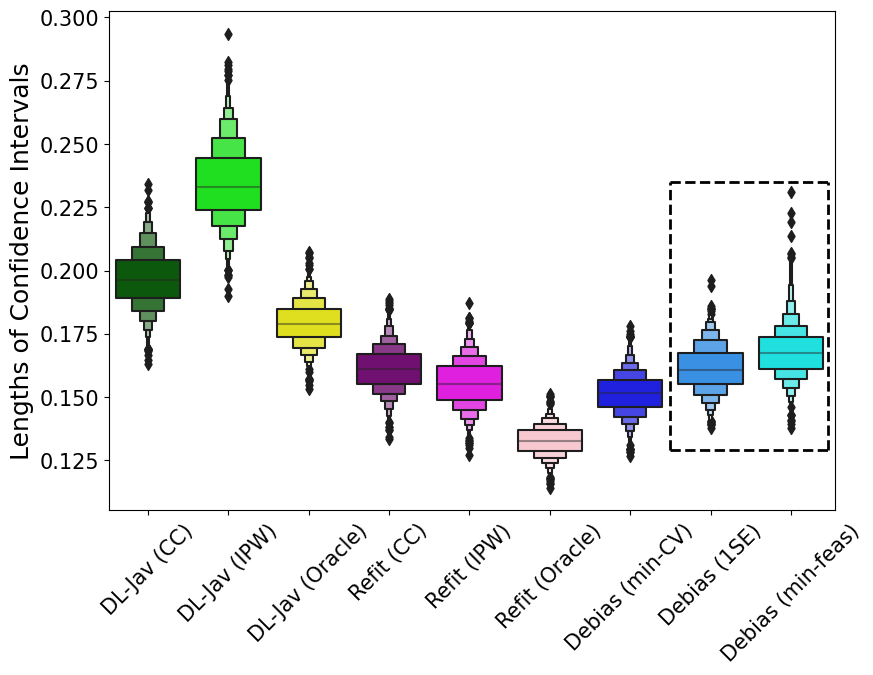

In [188]:
d = 1000
n = 900
B_repeat = 1000
i = 4
## x4
x = 1/np.linspace(1, d, d)**2

## beta 0
k = 0
s_beta = 5
beta_0 = np.zeros((d,))
beta_0[:s_beta] = np.sqrt(5)

# True regression function
m_true = np.dot(x, beta_0)

debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')
refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')
deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_1se.csv')
deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_mincv.csv')
deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_minfeas.csv')
if (i == 0) or (i == 2):
    rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')

# Lengths of confidence intervals
## Debiased lasso (Javanmard and Montarani, 2014) MAR
CIlen_df = pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_obs2'], 
                        'Scenarios': np.repeat('DL-Jav (CC)', B_repeat)})
CIlen_df = pd.concat([CIlen_df, 
                     pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_ipw2'], 
                                   'Scenarios': np.repeat('DL-Jav (IPW)', B_repeat)})], axis=0)
CIlen_df = pd.concat([CIlen_df, 
                     pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_full'], 
                                   'Scenarios': np.repeat('DL-Jav (Oracle)', B_repeat)})], axis=0)

## Ridge projection MAR
if (i == 0) or (i == 2):
    CIlen_df = pd.concat([CIlen_df, 
                          pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_obs2'], 
                                       'Scenarios': np.repeat('R-Proj (CC)', B_repeat)})], axis=0)
    CIlen_df = pd.concat([CIlen_df, 
                          pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_ipw2'], 
                                       'Scenarios': np.repeat('R-Proj (CC)', B_repeat)})], axis=0)
    CIlen_df = pd.concat([CIlen_df, 
                          pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_full'], 
                                       'Scenarios': np.repeat('R-Proj (Oracle)', B_repeat)})], axis=0)

## Lasso refitting MAR
CIlen_df = pd.concat([CIlen_df, 
                      pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_obs2'], 
                                    'Scenarios': np.repeat('Refit (CC)', B_repeat)})], axis=0)
CIlen_df = pd.concat([CIlen_df, 
                      pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_ipw2'], 
                                    'Scenarios': np.repeat('Refit (IPW)', B_repeat)})], axis=0)
CIlen_df = pd.concat([CIlen_df, 
                      pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_full'], 
                                    'Scenarios': np.repeat('Refit (Oracle)', B_repeat)})], axis=0)

## Proposed debiasing framework MAR
CIlen_df = pd.concat([CIlen_df, 
                      pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_mincv['asym_se2']*deb_est_mincv['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2), 
                                    'Scenarios': np.repeat('Debias (min-CV)', B_repeat)})], axis=0)
CIlen_df = pd.concat([CIlen_df, 
                      pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_1se['asym_se2']*deb_est_1se['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2), 
                                    'Scenarios': np.repeat('Debias (1SE)', B_repeat)})], axis=0)
CIlen_df = pd.concat([CIlen_df, 
                      pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_minfeas['asym_se2']*deb_est_minfeas['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2), 
                                    'Scenarios': np.repeat('Debias (min-feas)', B_repeat)})], axis=0)


colors = ['darkgreen', 'lime', 'yellow', 'purple', 'magenta', 'pink', 'blue', 'dodgerblue', 'cyan']
# 'oldlace', 'orange', 'darkorange'
col_pal = dict(zip(list(Bias_df['Scenarios'].unique()), colors))


plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(9, 7))
sns.boxenplot(y='Lengths of Confidence Intervals', x='Scenarios', data=CIlen_df, palette=col_pal)
plt.xticks(rotation=45)
plt.xlabel('')
plt.ylabel('Lengths of Confidence Intervals', size=18)

refy2 = [0.129, 0.235]
refx2 = [6.5, 8.46]
plt.hlines(refy2, xmin=refx2[0], xmax=refx2[1], color='black', linestyles='--', linewidth=2)
plt.vlines(refx2, ymin=refy2[0], ymax=refy2[1], color='black', linestyles='--', linewidth=2)
plt.margins(x=0.01)
plt.tight_layout()
plt.savefig('./Figures/cirsym_CI_len_x'+str(i)+'_beta'+str(k)+'_laperr.pdf', bbox_inches='tight')

### Asymptotic Normality of Our Debiased Estimator (Laplace noise)

Scenario x0, beta0:



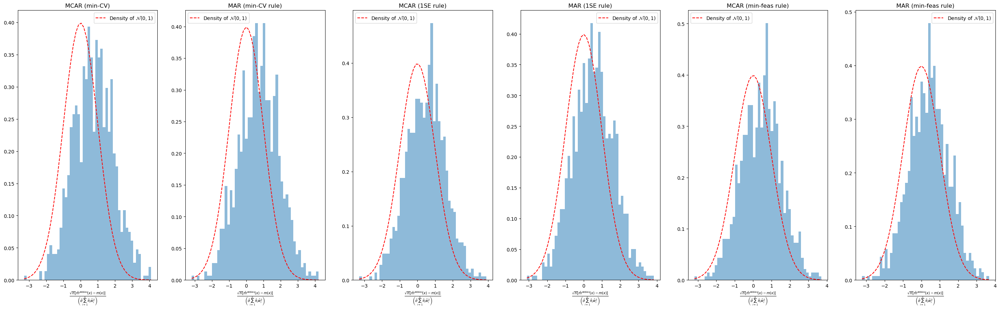

Scenario x0, beta1:



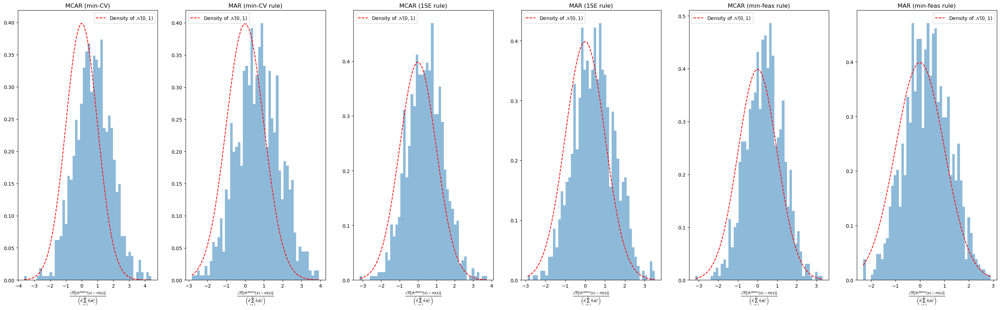

Scenario x0, beta2:



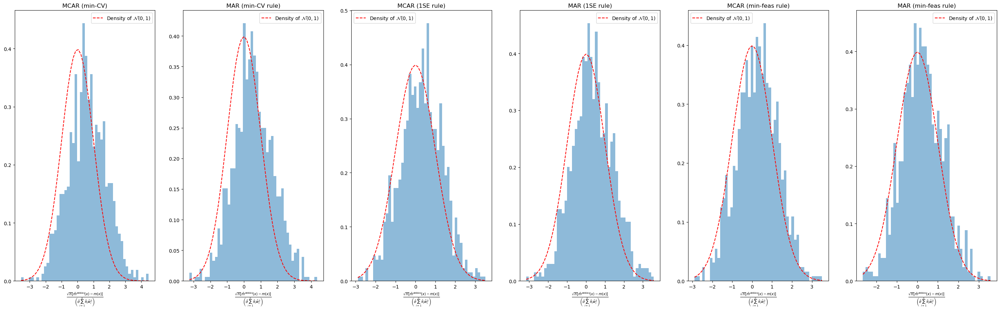

Scenario x1, beta0:



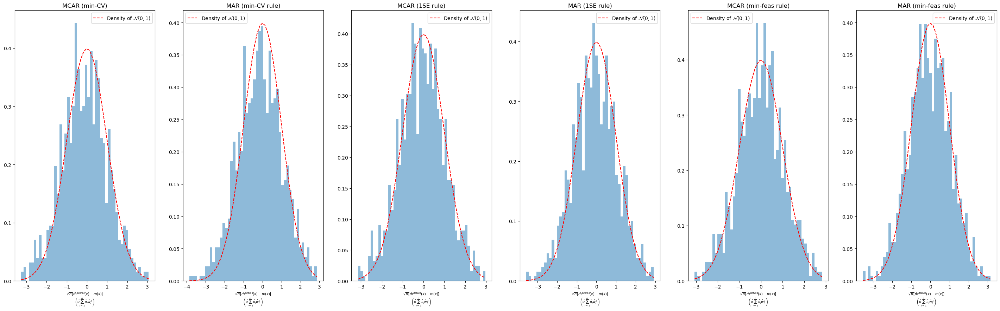

Scenario x1, beta1:



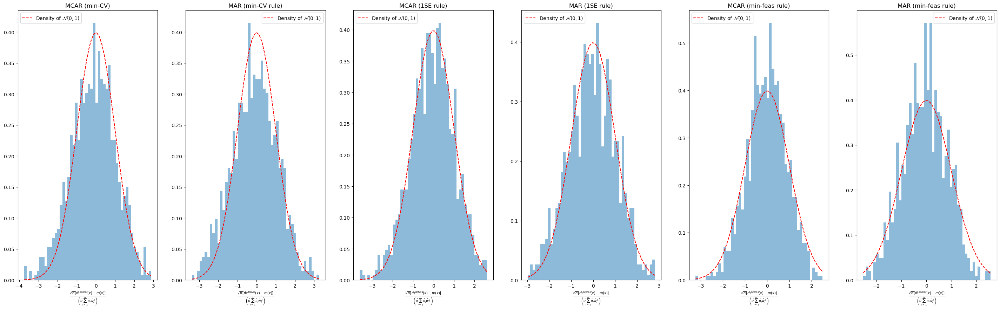

Scenario x1, beta2:



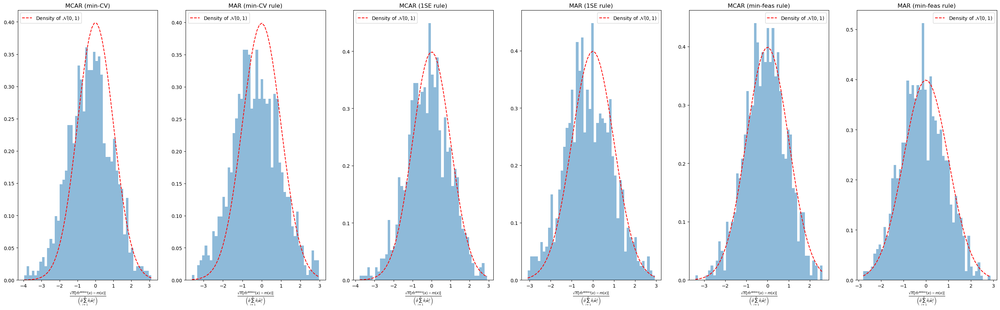

Scenario x2, beta0:



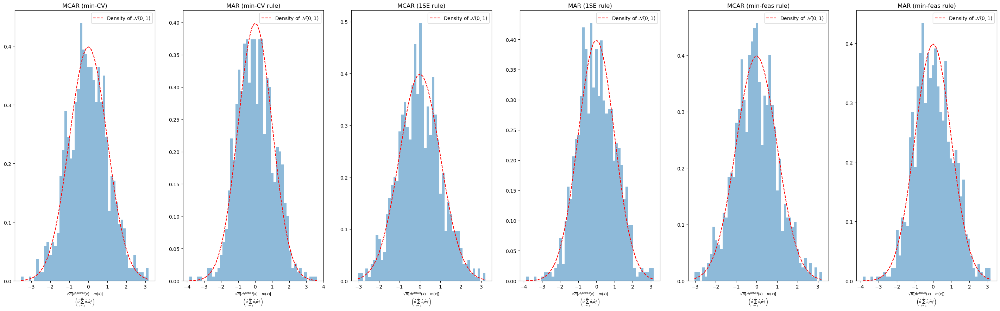

Scenario x2, beta1:



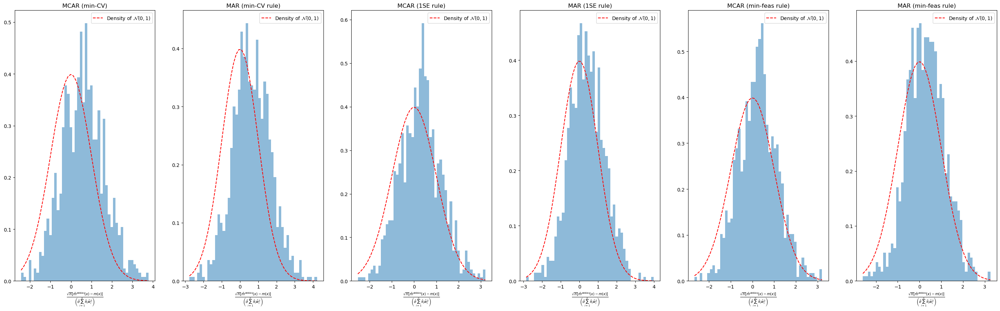

Scenario x2, beta2:



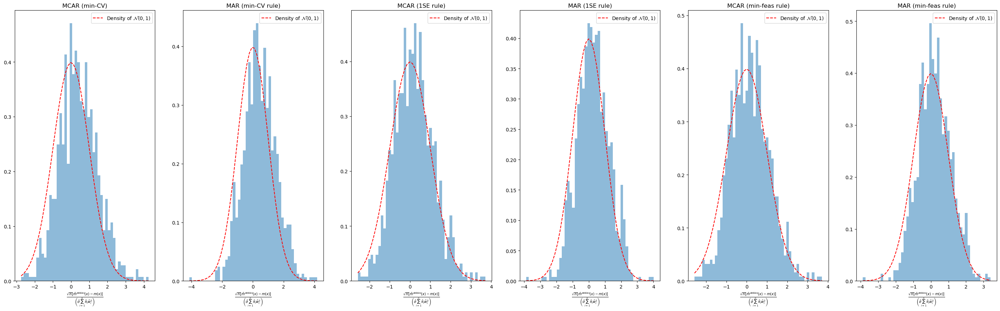

Scenario x3, beta0:



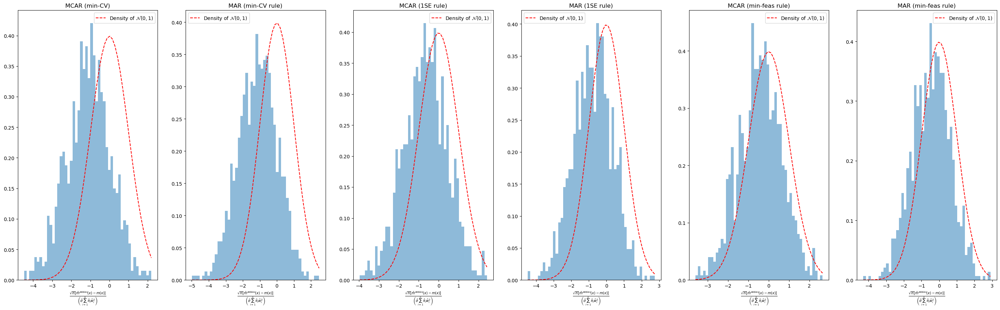

Scenario x3, beta1:



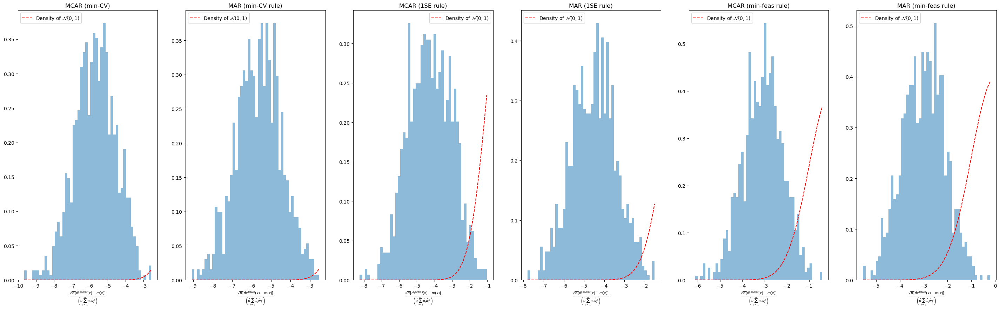

Scenario x3, beta2:



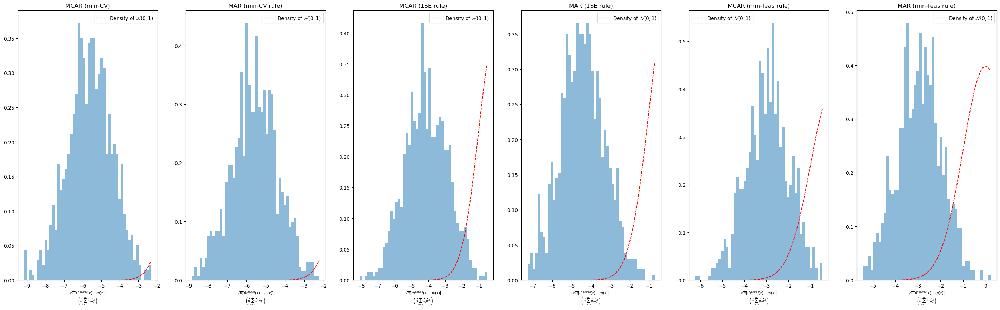

Scenario x4, beta0:



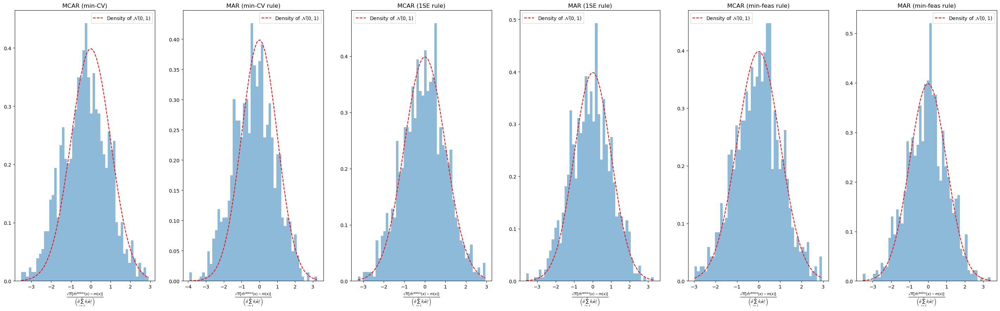

Scenario x4, beta1:



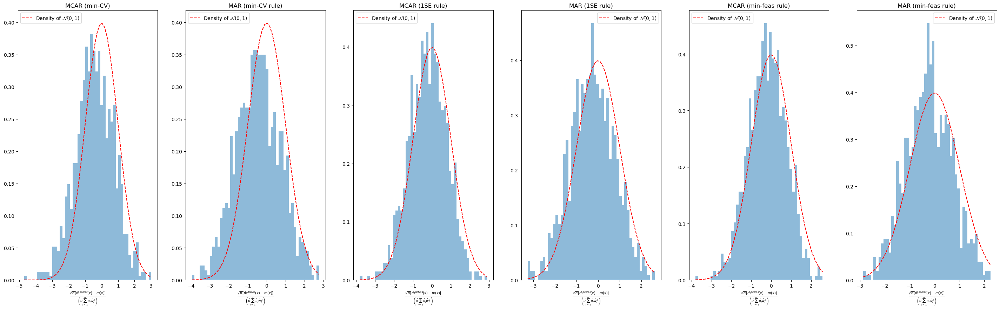

Scenario x4, beta2:



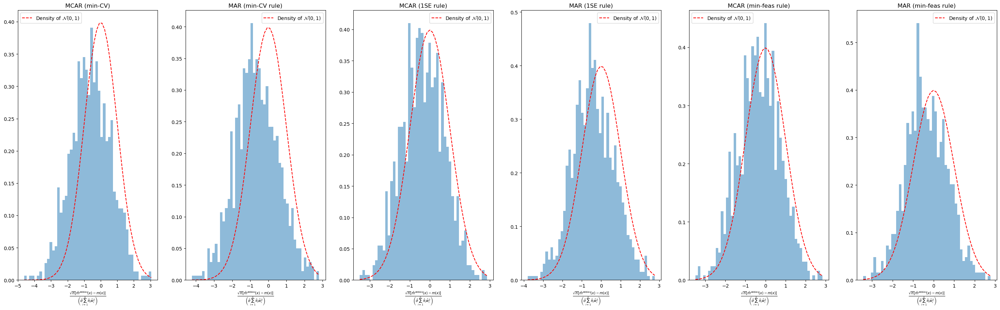

In [6]:
d = 1000
n= 900
for i in range(5):
    if i == 0:
        ## x0
        x = np.zeros((d,))
        x[0] = 1
    if i == 1:
        ## x1
        x = np.zeros((d,))
        x[0] = 1
        x[1] = 1/2
        x[2] = 1/4
        x[6] = 1/2
        x[7] = 1/8
    if i == 2:
        ## x2
        x = np.zeros((d,))
        x[99] = 1
    if i == 3:
        ## x3
        x = 1/np.linspace(1, d, d)
    if i == 4:
        ## x4
        x = 1/np.linspace(1, d, d)**2
    for k in range(3):
        if k == 0:
            s_beta = 5
            beta_0 = np.zeros((d,))
            beta_0[:s_beta] = np.sqrt(5)
        if k == 1:
            beta_0 = 1/np.sqrt(np.linspace(1, d, d))
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)
        if k == 2:
            beta_0 = 1/np.linspace(1, d, d)
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)

        # True regression function
        m_true = np.dot(x, beta_0)
        
        deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_1se.csv')
        deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_mincv.csv')
        deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_minfeas.csv')
        
        print('Scenario x'+str(i)+', beta'+str(k)+':\n')
        
        plt.figure(figsize=(36,10))
        plt.subplot(161)
        plt.hist((deb_est_mincv['m_deb1'] - m_true)/(deb_est_mincv['asym_se1'] * deb_est_mincv['sigma_hat1']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_mincv['m_deb1'] - m_true)/(deb_est_mincv['asym_se1'] * deb_est_mincv['sigma_hat1'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MCAR (min-CV)')
        
        plt.subplot(162)
        plt.hist((deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MAR (min-CV rule)')
        
        plt.subplot(163)
        plt.hist((deb_est_1se['m_deb1'] - m_true)/(deb_est_1se['asym_se1'] * deb_est_1se['sigma_hat1']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_1se['m_deb1'] - m_true)/(deb_est_1se['asym_se1'] * deb_est_1se['sigma_hat1'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MCAR (1SE rule)')
        
        plt.subplot(164)
        plt.hist((deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MAR (1SE rule)')
        
        plt.subplot(165)
        plt.hist((deb_est_minfeas['m_deb1'] - m_true)/(deb_est_minfeas['asym_se1'] * deb_est_minfeas['sigma_hat1']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_minfeas['m_deb1'] - m_true)/(deb_est_minfeas['asym_se1'] * deb_est_minfeas['sigma_hat1'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MCAR (min-feas rule)')
        
        plt.subplot(166)
        plt.hist((deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MAR (min-feas rule)')
        plt.show()

Scenario x0, beta0:



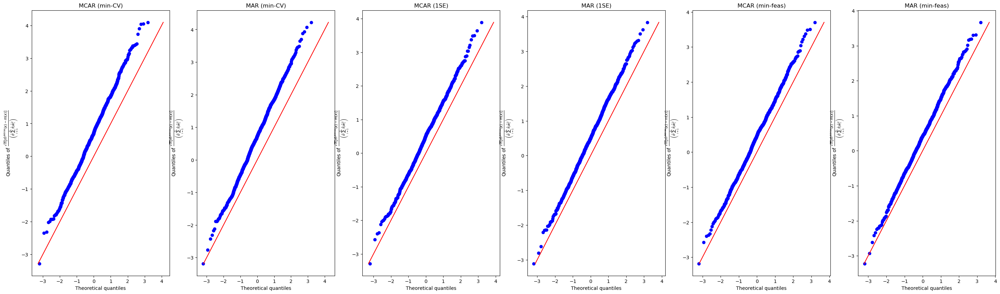

Scenario x0, beta1:



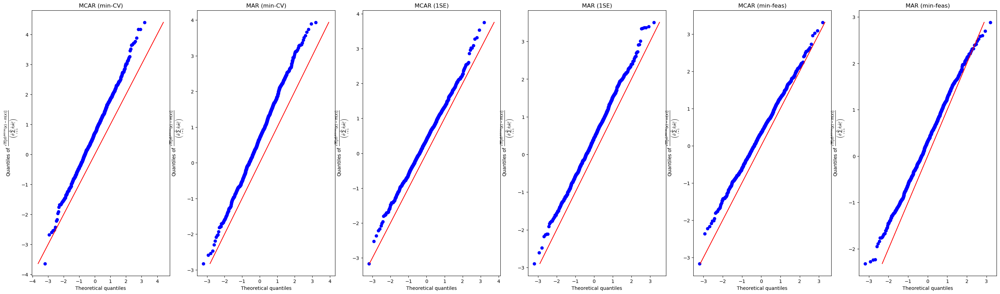

Scenario x0, beta2:



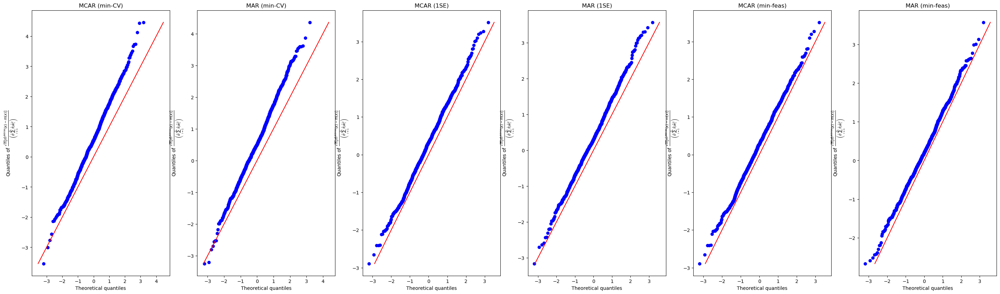

Scenario x1, beta0:



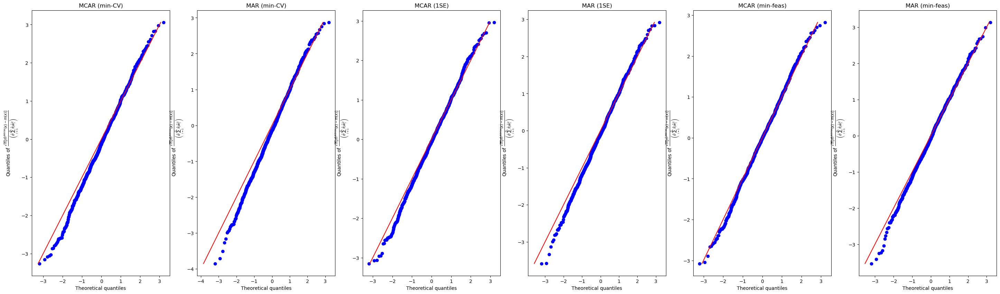

Scenario x1, beta1:



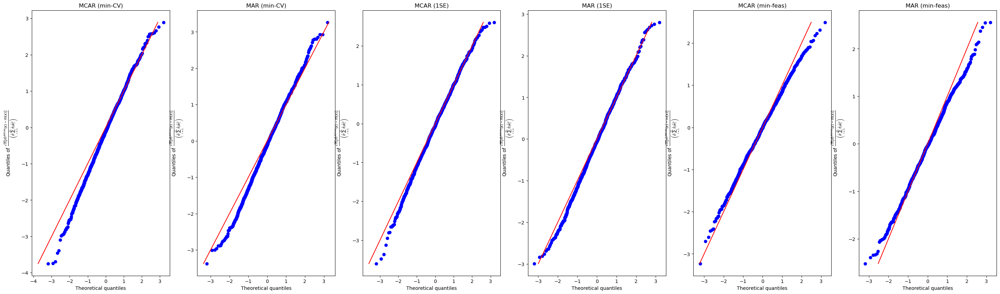

Scenario x1, beta2:



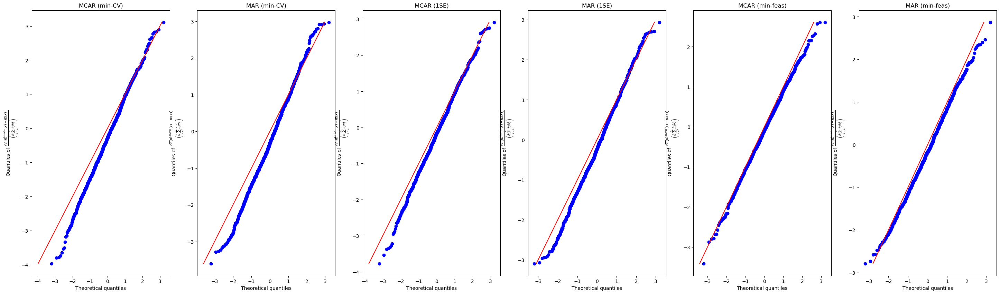

Scenario x2, beta0:



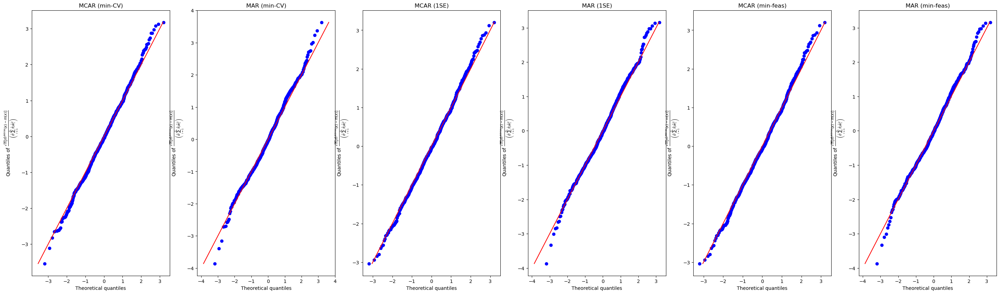

Scenario x2, beta1:



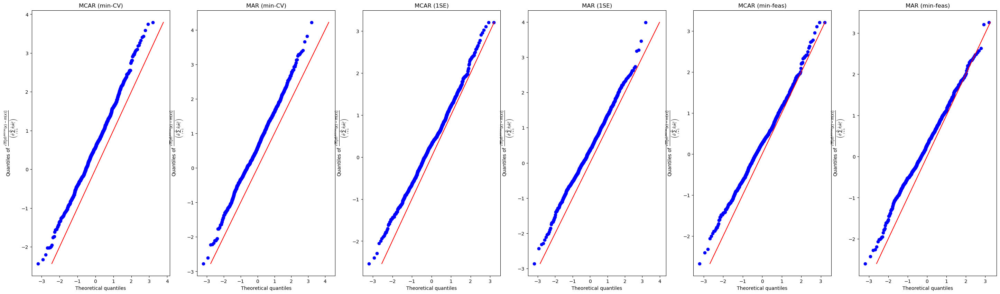

Scenario x2, beta2:



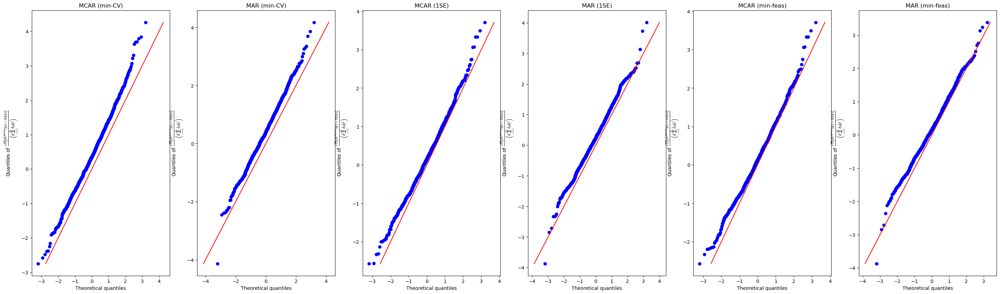

Scenario x3, beta0:



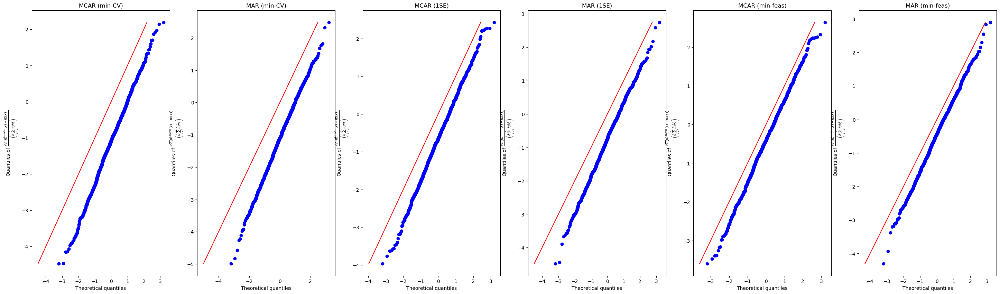

Scenario x3, beta1:



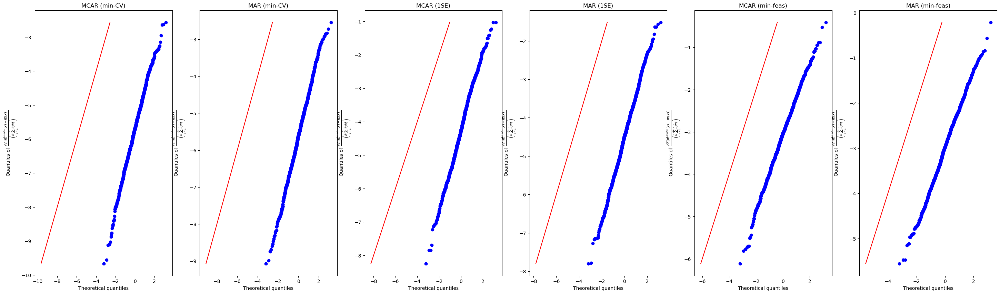

Scenario x3, beta2:



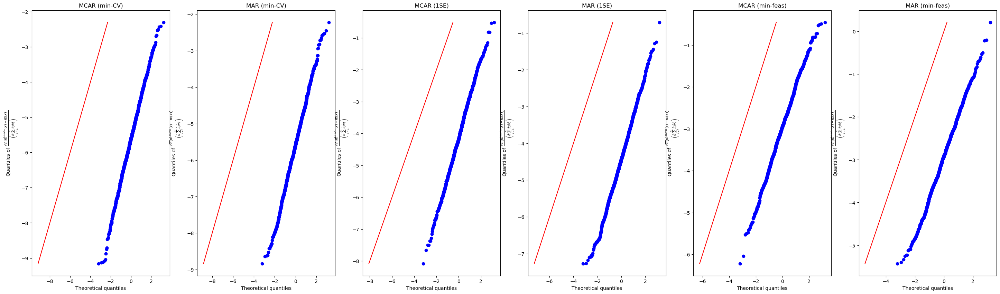

Scenario x4, beta0:



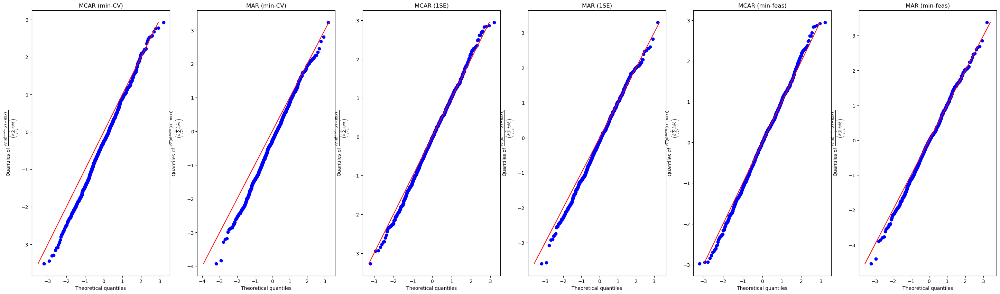

Scenario x4, beta1:



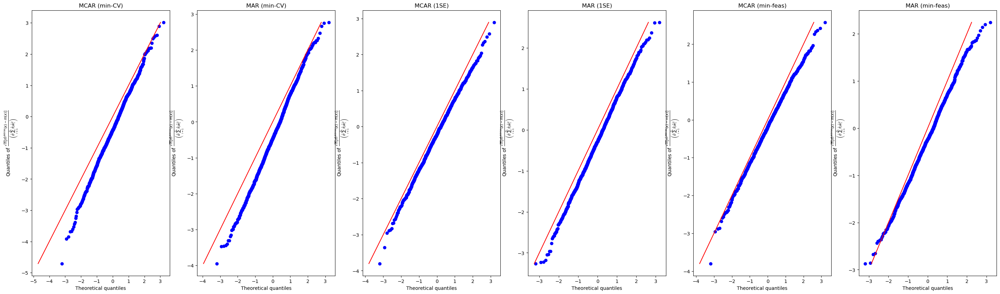

Scenario x4, beta2:



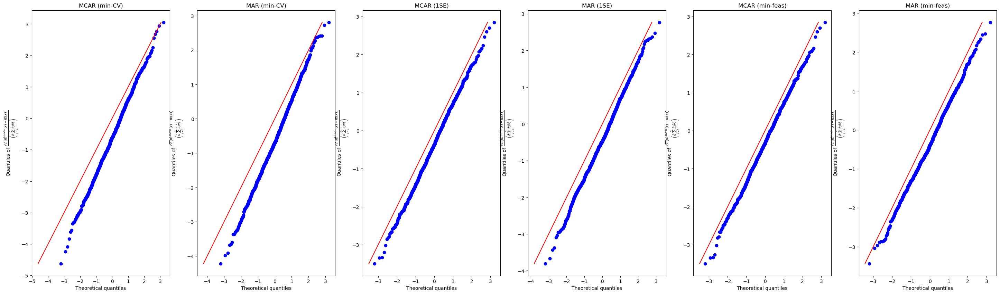

In [7]:
d = 1000
n= 900
for i in range(5):
    if i == 0:
        ## x0
        x = np.zeros((d,))
        x[0] = 1
    if i == 1:
        ## x1
        x = np.zeros((d,))
        x[0] = 1
        x[1] = 1/2
        x[2] = 1/4
        x[6] = 1/2
        x[7] = 1/8
    if i == 2:
        ## x2
        x = np.zeros((d,))
        x[99] = 1
    if i == 3:
        ## x3
        x = 1/np.linspace(1, d, d)
    if i == 4:
        ## x4
        x = 1/np.linspace(1, d, d)**2
    for k in range(3):
        if k == 0:
            s_beta = 5
            beta_0 = np.zeros((d,))
            beta_0[:s_beta] = np.sqrt(5)
        if k == 1:
            beta_0 = 1/np.sqrt(np.linspace(1, d, d))
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)
        if k == 2:
            beta_0 = 1/np.linspace(1, d, d)
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)

        # True regression function
        m_true = np.dot(x, beta_0)
        
        deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_1se.csv')
        deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_mincv.csv')
        deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_minfeas.csv')
        
        print('Scenario x'+str(i)+', beta'+str(k)+':\n')
        
        plt.figure(figsize=(36,10))
        plt.subplot(161)
        pts = (deb_est_mincv['m_deb1'] - m_true)/(deb_est_mincv['asym_se1'] * deb_est_mincv['sigma_hat1'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MCAR (min-CV)')
        
        plt.subplot(162)
        pts = (deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MAR (min-CV)')
        
        plt.subplot(163)
        pts = (deb_est_1se['m_deb1'] - m_true)/(deb_est_1se['asym_se1'] * deb_est_1se['sigma_hat1'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MCAR (1SE)')
        
        plt.subplot(164)
        pts = (deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MAR (1SE)')
        
        plt.subplot(165)
        pts = (deb_est_minfeas['m_deb1'] - m_true)/(deb_est_minfeas['asym_se1'] * deb_est_minfeas['sigma_hat1'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MCAR (min-feas)')
        
        plt.subplot(166)
        pts = (deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MAR (min-feas)')
        plt.show()

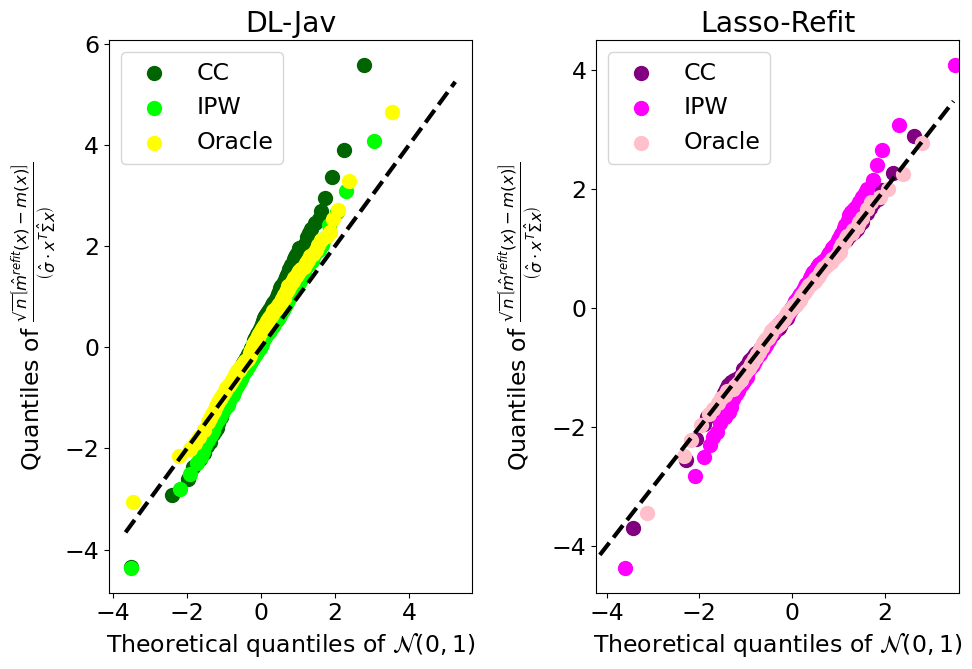

In [181]:
d = 1000
n = 900
B_repeat = 1000
i = 4
## x4
x = 1/np.linspace(1, d, d)**2

## beta 0
k = 0
s_beta = 5
beta_0 = np.zeros((d,))
beta_0[:s_beta] = np.sqrt(5)

# True regression function
m_true = np.dot(x, beta_0)

debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')
refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')
deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_1se.csv')
deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_mincv.csv')
deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr_minfeas.csv')
if (i == 0) or (i == 2):
    rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_laperr.csv')

    
colors = ['darkgreen', 'lime', 'yellow', 'purple', 'magenta', 'pink', 'blue', 'dodgerblue', 'cyan']
# 'oldlace', 'orange', 'darkorange'
col_pal = dict(zip(list(Bias_df['Scenarios'].unique()), colors))


plt.rcParams.update({'font.size': 17})
plt.figure(figsize=(10,7))
plt.subplot(121)
pts = (debl_res1['m_obs2'] - m_true)/(debl_res1['asym_se_obs2'] * debl_res1['sigma_hat_obs2'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[0], s=100, label='CC')

pts = (debl_res1['m_ipw2'] - m_true)/(debl_res1['asym_se_ipw2'] * debl_res1['sigma_hat_ipw2'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[1], s=100, label='IPW')

pts = (debl_res1['m_full'] - m_true)/(debl_res1['asym_se_full'] * debl_res1['sigma_hat_full'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[2], s=100, label='Oracle')

x_range = np.linspace(np.min(pts)-0.6, np.max(pts)+0.6, 50)
plt.plot(x_range, x_range, color='black', linestyle='dashed', linewidth=3)
plt.xlabel('Theoretical quantiles of $\mathcal{N}(0,1)$')
plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{refit}(x) - m(x) \right]}{\left(\hat{\sigma} \cdot x^T\hat{\Sigma}x\right)}$')
plt.legend()
plt.title('DL-Jav')


plt.subplot(122)
pts = (refit_res1['m_obs2'] - m_true)/(refit_res1['asym_se_obs2'] * refit_res1['sigma_hat_obs2'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[3], s=100, label='CC')

pts = (debl_res1['m_ipw2'] - m_true)/(debl_res1['asym_se_ipw2'] * debl_res1['sigma_hat_ipw2'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[4], s=100, label='IPW')

pts = (refit_res1['m_full'] - m_true)/(refit_res1['asym_se_full'] * refit_res1['sigma_hat_full'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[5], s=100, label='Oracle')

x_range = np.linspace(np.min(pts)-0.7, np.max(pts)+0.7, 50)
plt.plot(x_range, x_range, color='black', linestyle='dashed', linewidth=3)
plt.xlabel('Theoretical quantiles of $\mathcal{N}(0,1)$')
plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{refit}(x) - m(x) \right]}{\left(\hat{\sigma} \cdot x^T\hat{\Sigma}x\right)}$')
plt.legend()
plt.title('Lasso-Refit')
plt.margins(x=0.01)
plt.tight_layout()
plt.savefig('./Figures/cirsym_qqplot_x'+str(i)+'_beta'+str(k)+'_laperr.pdf', bbox_inches='tight')

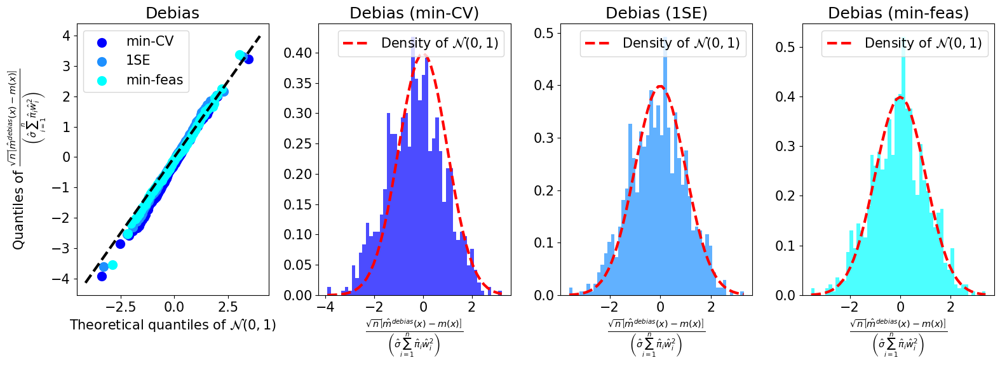

In [189]:
colors = ['darkgreen', 'lime', 'yellow', 'purple', 'magenta', 'pink', 'blue', 'dodgerblue', 'cyan']
# 'oldlace', 'orange', 'darkorange'
col_pal = dict(zip(list(Bias_df['Scenarios'].unique()), colors))


plt.rcParams.update({'font.size': 15})
plt.figure(figsize=(16,6))
plt.subplot(141)
pts = (deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[6], s=100, label='min-CV')

pts = (deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[7], s=100, label='1SE')

pts = (deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2'])
pts_norm = np.random.normal(0, 1, len(pts))
percs = np.linspace(0, 100, 101)
qn_pts = np.percentile(pts, percs)
qn_norm = np.percentile(pts_norm, percs)
plt.scatter(qn_norm, qn_pts, color=colors[8], s=100, label='min-feas')

x_range = np.linspace(np.min(pts)-0.6, np.max(pts)+0.6, 50)
plt.plot(x_range, x_range, color='black', linestyle='dashed', linewidth=3)
plt.xlabel('Theoretical quantiles of $\mathcal{N}(0,1)$')
plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
plt.legend()
plt.title('Debias')


plt.subplot(142)
plt.hist((deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2']), bins=50, 
         density=True, alpha=0.7, color='blue')
pts = (deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2'])
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', linewidth=3,
         label='Density of $\mathcal{N}(0,1)$')
plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
plt.legend()
plt.title('Debias (min-CV)')

plt.subplot(143)
plt.hist((deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2']), bins=50, 
         density=True, alpha=0.7, color='dodgerblue')
pts = (deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2'])
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', linewidth=3,
         label='Density of $\mathcal{N}(0,1)$')
plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
plt.legend()
plt.title('Debias (1SE)')

plt.subplot(144)
plt.hist((deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2']), bins=50, 
         density=True, alpha=0.7, color='cyan')
pts = (deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2'])
x_range = np.linspace(np.min(pts), np.max(pts), 50)
plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', linewidth=3,
         label='Density of $\mathcal{N}(0,1)$')
plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
plt.legend()
plt.title('Debias (min-feas)')

plt.tight_layout()
plt.savefig('./Figures/cirsym_asym_norm_x'+str(i)+'_beta'+str(k)+'_laperr.pdf', bbox_inches='tight')

## d=1000, n=900 (t-distributed noise)

### Bias Comparisons (t-distributed noise)

Scenario x0, beta0:



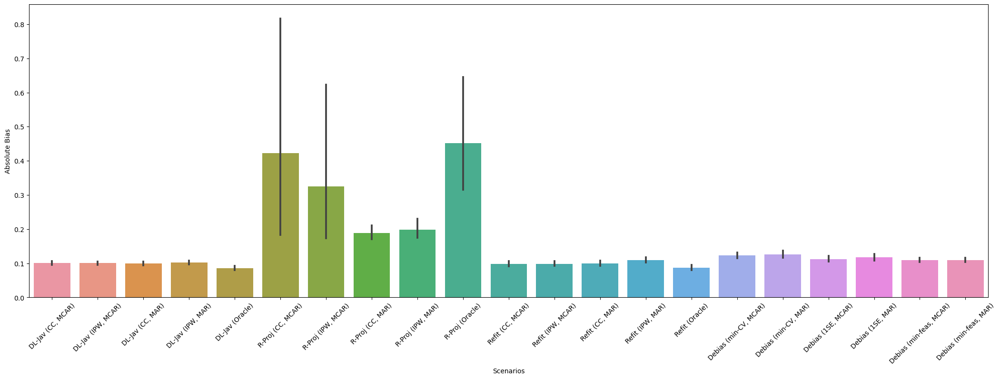

Scenario x0, beta1:



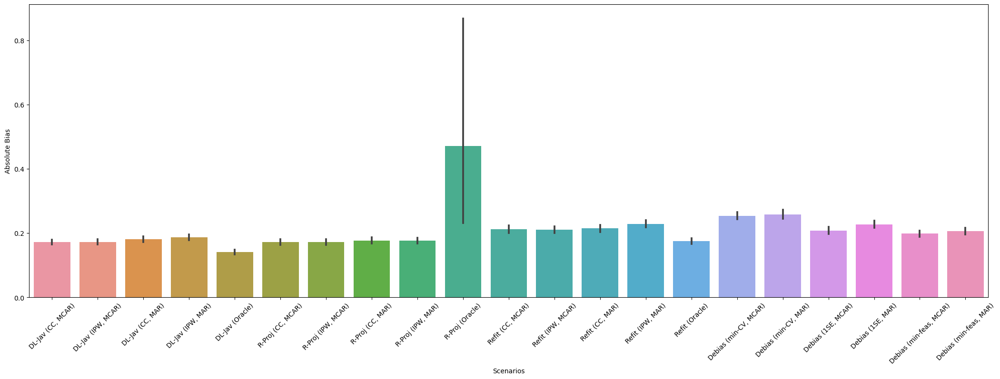

Scenario x0, beta2:



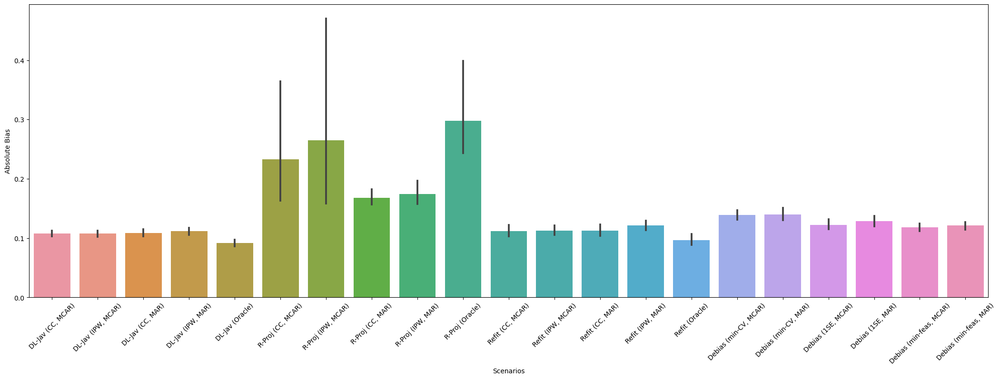

Scenario x1, beta0:



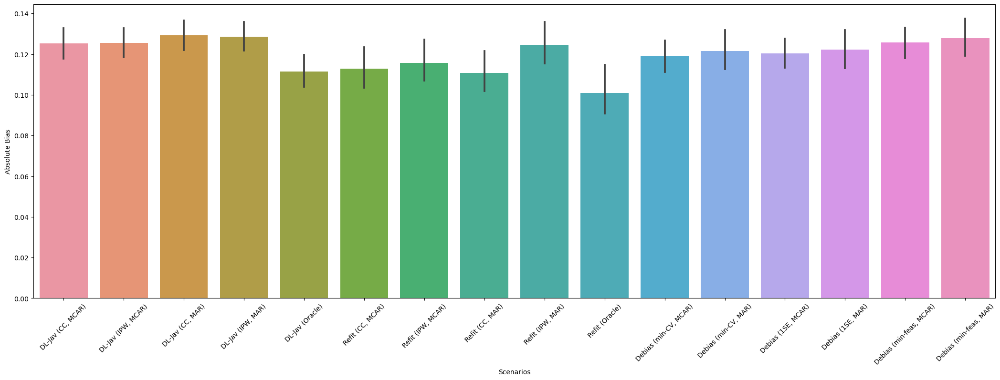

Scenario x1, beta1:



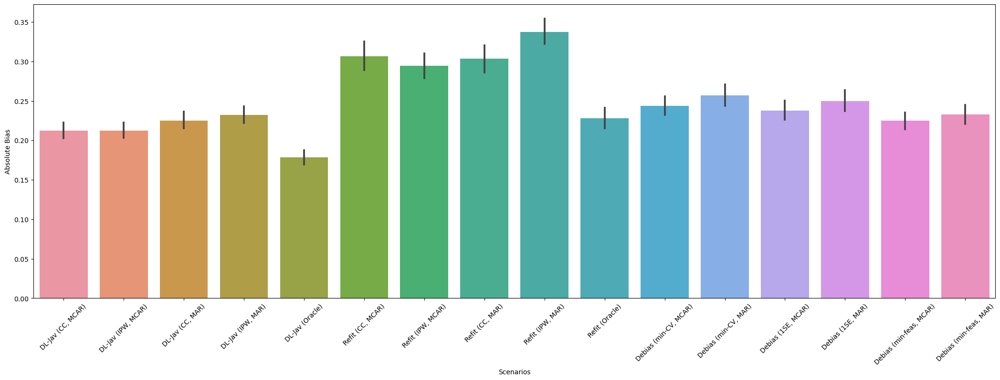

Scenario x1, beta2:



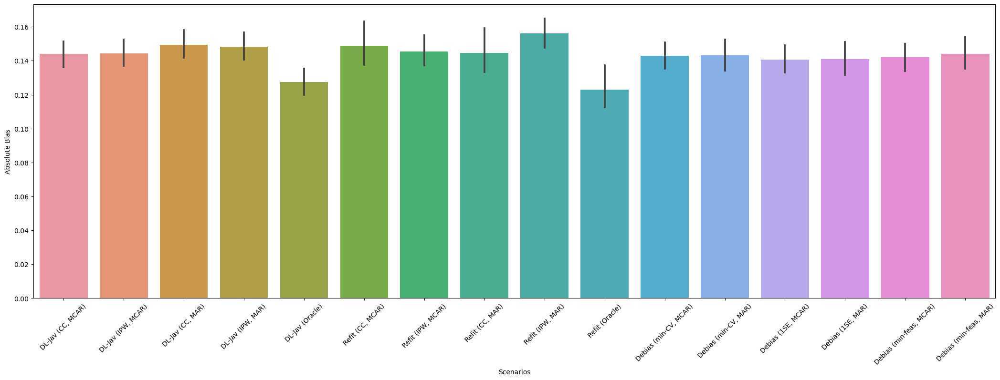

Scenario x2, beta0:



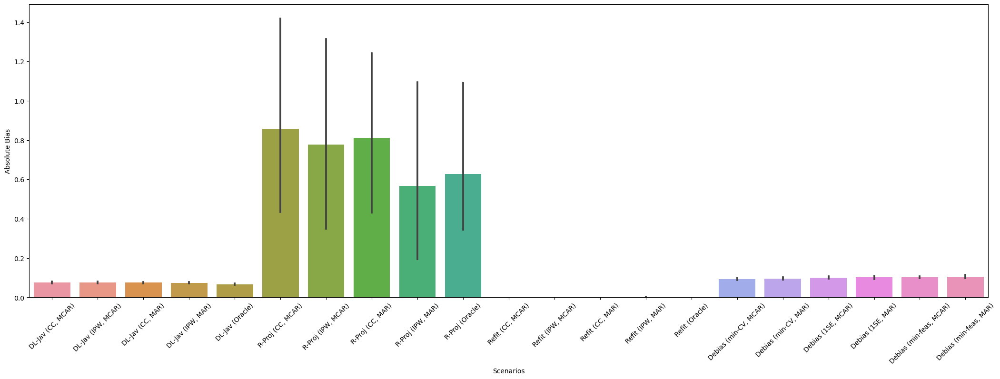

Scenario x2, beta1:



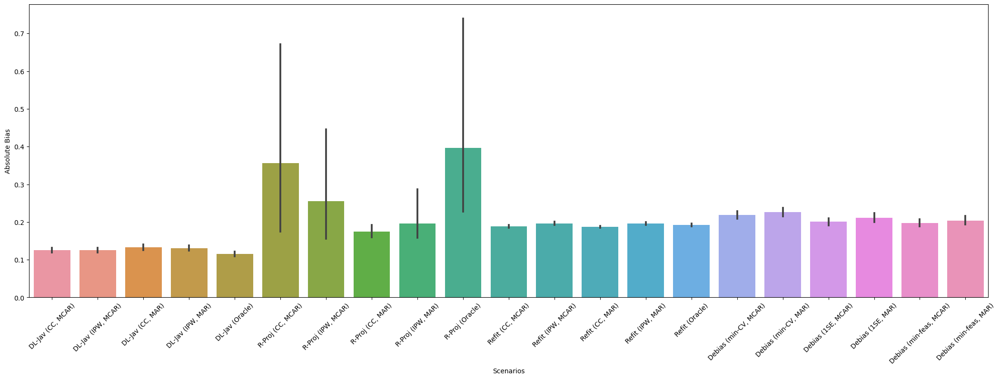

Scenario x2, beta2:



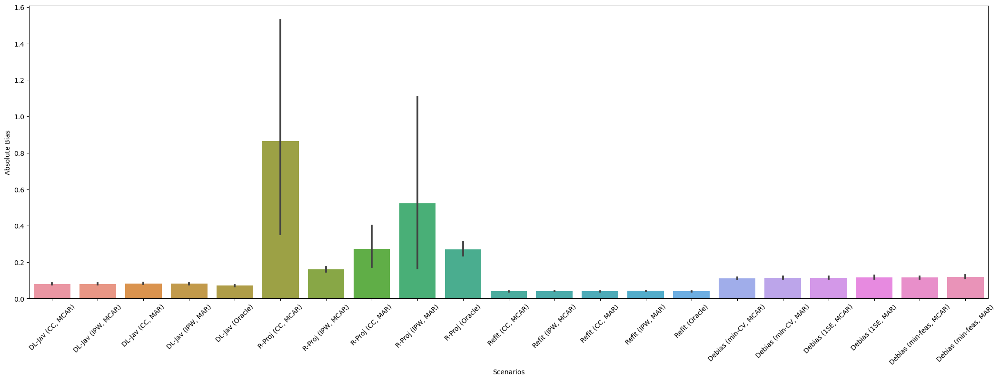

Scenario x3, beta0:



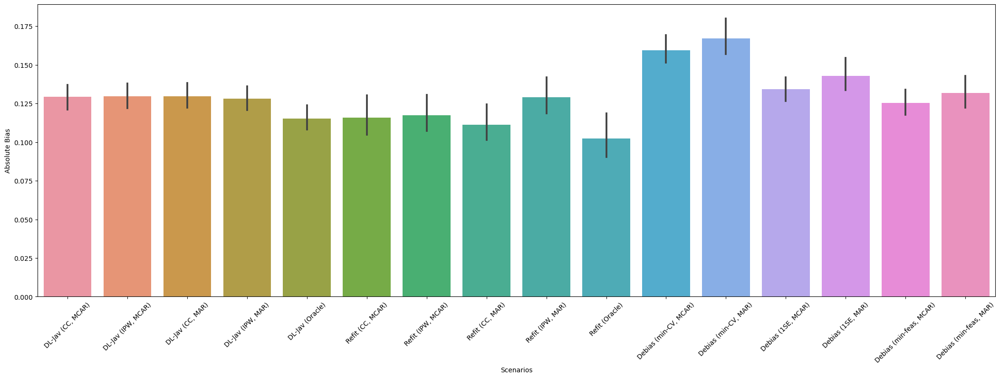

Scenario x3, beta1:



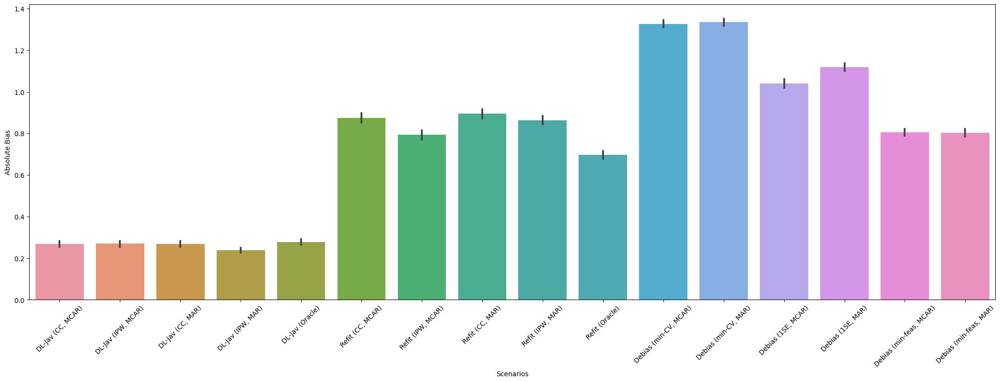

Scenario x3, beta2:



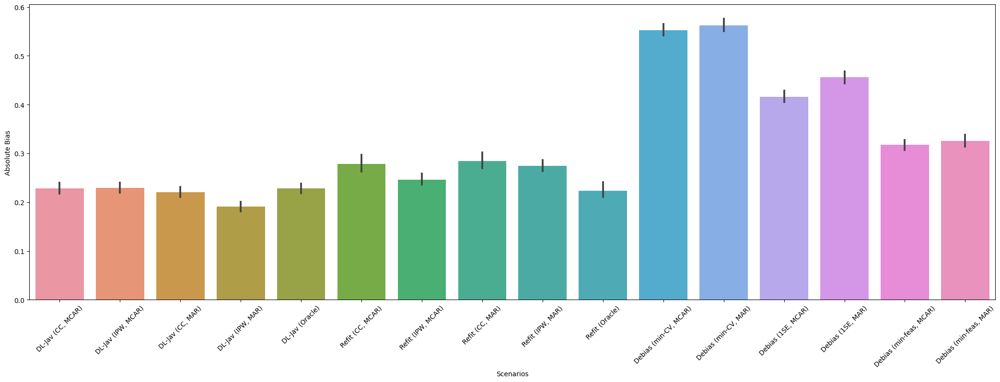

Scenario x4, beta0:



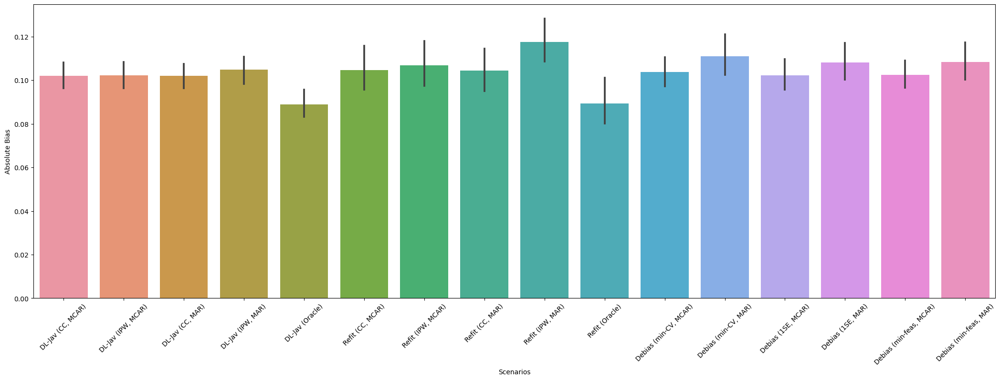

Scenario x4, beta1:



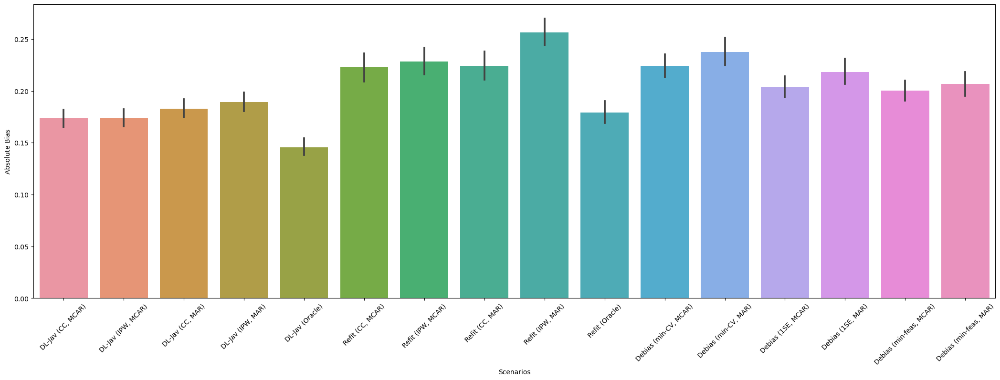

Scenario x4, beta2:



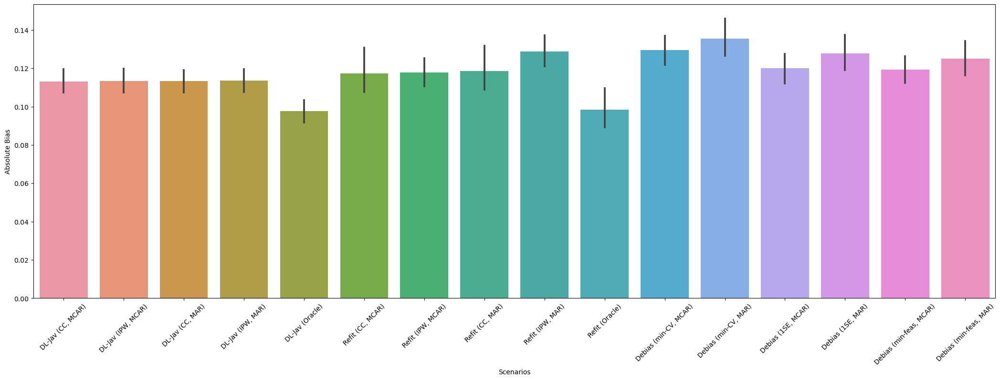

In [8]:
d = 1000
n= 900
B_repeat = 1000
for i in range(5):
    if i == 0:
        ## x0
        x = np.zeros((d,))
        x[0] = 1
    if i == 1:
        ## x1
        x = np.zeros((d,))
        x[0] = 1
        x[1] = 1/2
        x[2] = 1/4
        x[6] = 1/2
        x[7] = 1/8
    if i == 2:
        ## x2
        x = np.zeros((d,))
        x[99] = 1
    if i == 3:
        ## x3
        x = 1/np.linspace(1, d, d)
    if i == 4:
        ## x4
        x = 1/np.linspace(1, d, d)**2
    for k in range(3):
        if k == 0:
            s_beta = 5
            beta_0 = np.zeros((d,))
            beta_0[:s_beta] = np.sqrt(5)
        if k == 1:
            beta_0 = 1/np.sqrt(np.linspace(1, d, d))
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)
        if k == 2:
            beta_0 = 1/np.linspace(1, d, d)
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)

        # True regression function
        m_true = np.dot(x, beta_0)
        
        print('Scenario x'+str(i)+', beta'+str(k)+':\n')
        
        
        debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr.csv')
        refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr.csv')
        deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr_1se.csv')
        deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr_mincv.csv')
        deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr_minfeas.csv')
        if (i == 0) or (i == 2):
            rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr.csv')
        
        # Bias Comparisons
        ## Debiased lasso (Javanmard and Montarani, 2014)
        Bias_df = pd.DataFrame({'Absolute Bias': abs(debl_res1['m_obs1'] - m_true), 
                                'Scenarios': np.repeat('DL-Jav (CC, MCAR)', B_repeat)})
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(debl_res1['m_ipw1'] - m_true), 
                                           'Scenarios': np.repeat('DL-Jav (IPW, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(debl_res1['m_obs2'] - m_true), 
                                           'Scenarios': np.repeat('DL-Jav (CC, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(debl_res1['m_ipw2'] - m_true), 
                                           'Scenarios': np.repeat('DL-Jav (IPW, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(debl_res1['m_full'] - m_true), 
                                           'Scenarios': np.repeat('DL-Jav (Oracle)', B_repeat)})], axis=0)
        
        ## Ridge projection
        if (i == 0) or (i == 2):
            Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_obs1'] - m_true), 
                                           'Scenarios': np.repeat('R-Proj (CC, MCAR)', B_repeat)})], axis=0)
            Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_ipw1'] - m_true), 
                                           'Scenarios': np.repeat('R-Proj (IPW, MCAR)', B_repeat)})], axis=0)
            Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_obs2'] - m_true), 
                                           'Scenarios': np.repeat('R-Proj (CC, MAR)', B_repeat)})], axis=0)
            Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_ipw2'] - m_true), 
                                           'Scenarios': np.repeat('R-Proj (IPW, MAR)', B_repeat)})], axis=0)
            Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(rproj_res1['m_full'] - m_true), 
                                           'Scenarios': np.repeat('R-Proj (Oracle)', B_repeat)})], axis=0)
            
        ## Lasso Refitting
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(refit_res1['m_obs1'] - m_true), 
                                           'Scenarios': np.repeat('Refit (CC, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(refit_res1['m_ipw1'] - m_true), 
                                           'Scenarios': np.repeat('Refit (IPW, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(refit_res1['m_obs2'] - m_true), 
                                           'Scenarios': np.repeat('Refit (CC, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(refit_res1['m_ipw2'] - m_true), 
                                           'Scenarios': np.repeat('Refit (IPW, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(refit_res1['m_full'] - m_true), 
                                           'Scenarios': np.repeat('Refit (Oracle)', B_repeat)})], axis=0)
        
        ## Our proposed debiasing framework
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_mincv['m_deb1'] - m_true), 
                                           'Scenarios': np.repeat('Debias (min-CV, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_mincv['m_deb2'] - m_true), 
                                           'Scenarios': np.repeat('Debias (min-CV, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_1se['m_deb1'] - m_true), 
                                           'Scenarios': np.repeat('Debias (1SE, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_1se['m_deb2'] - m_true), 
                                           'Scenarios': np.repeat('Debias (1SE, MAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_minfeas['m_deb1'] - m_true), 
                                           'Scenarios': np.repeat('Debias (min-feas, MCAR)', B_repeat)})], axis=0)
        Bias_df = pd.concat([Bias_df, 
                             pd.DataFrame({'Absolute Bias': abs(deb_est_minfeas['m_deb2'] - m_true), 
                                           'Scenarios': np.repeat('Debias (min-feas, MAR)', B_repeat)})], axis=0).reset_index()
        
        plt.figure(figsize=(26, 8))
        sns.barplot(y='Absolute Bias', x='Scenarios', data=Bias_df)
        plt.xticks(rotation=45)
        plt.show()

### Coverage Probability (t-distributed noise)

Scenario x0, beta0:



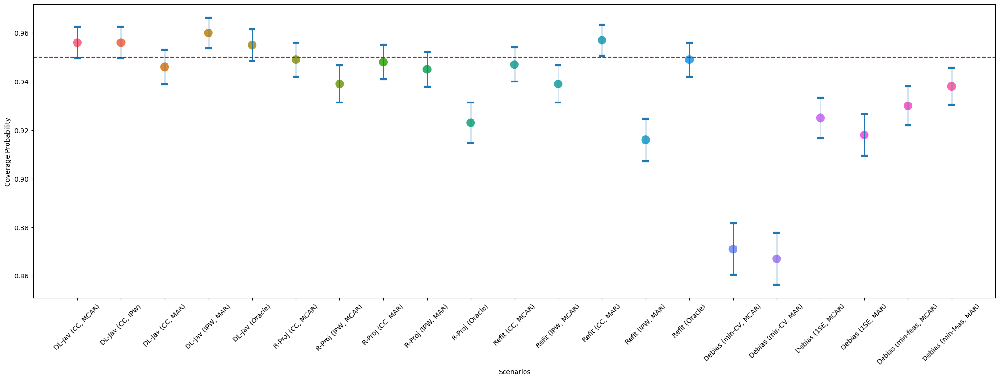

Scenario x0, beta1:



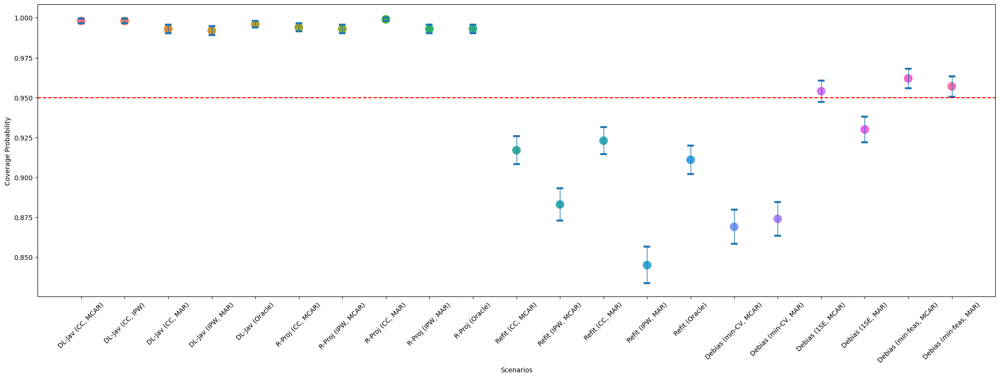

Scenario x0, beta2:



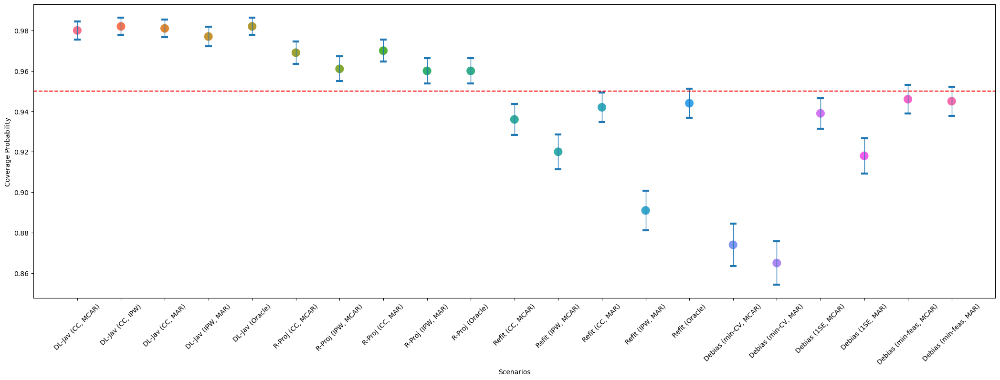

Scenario x1, beta0:



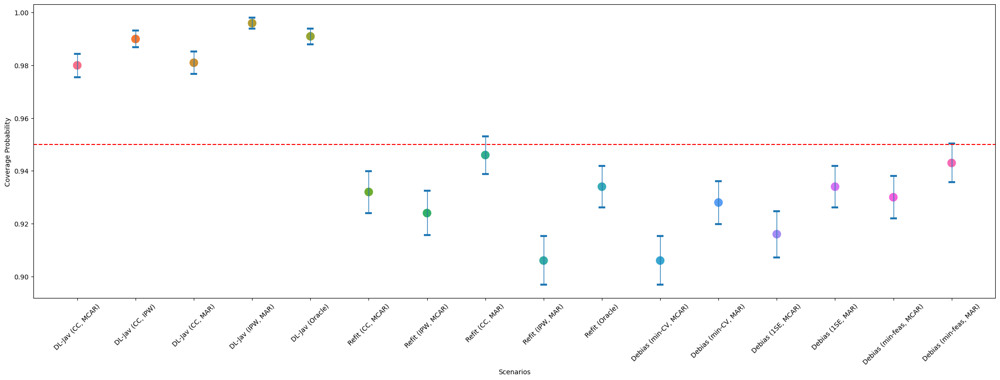

Scenario x1, beta1:



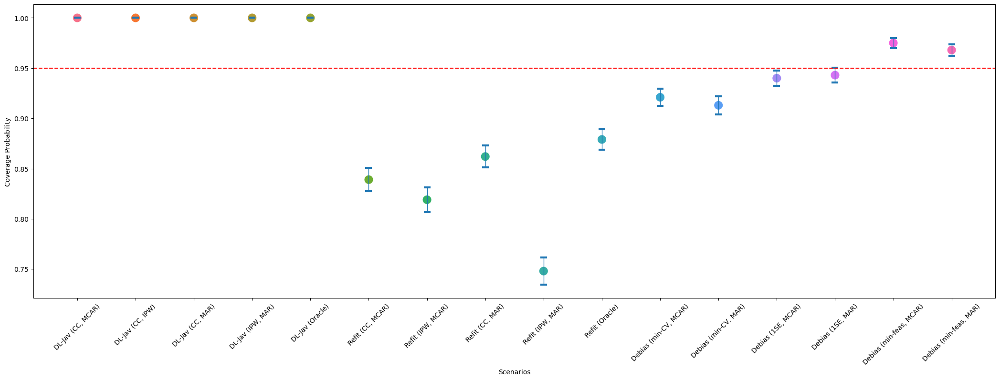

Scenario x1, beta2:



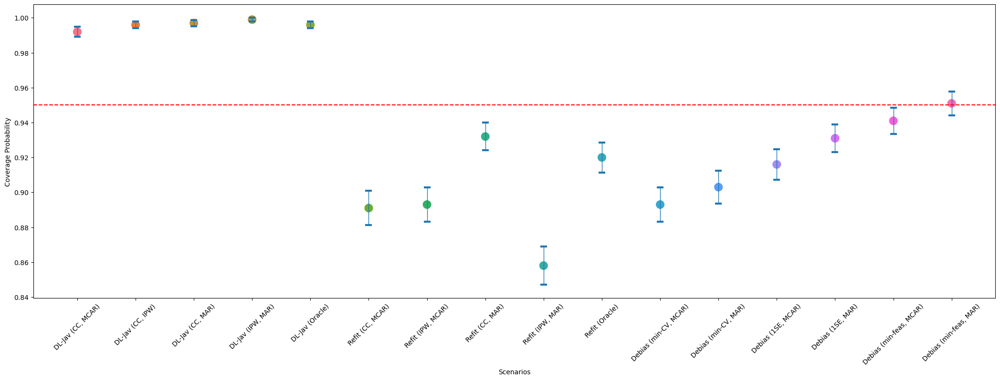

Scenario x2, beta0:



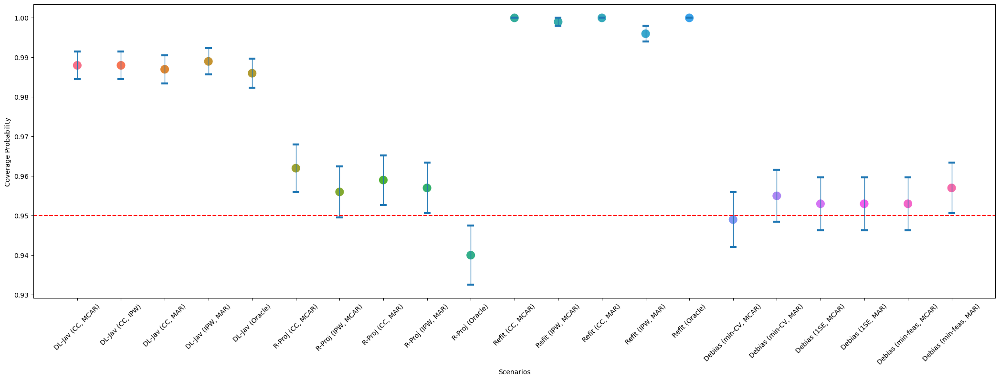

Scenario x2, beta1:



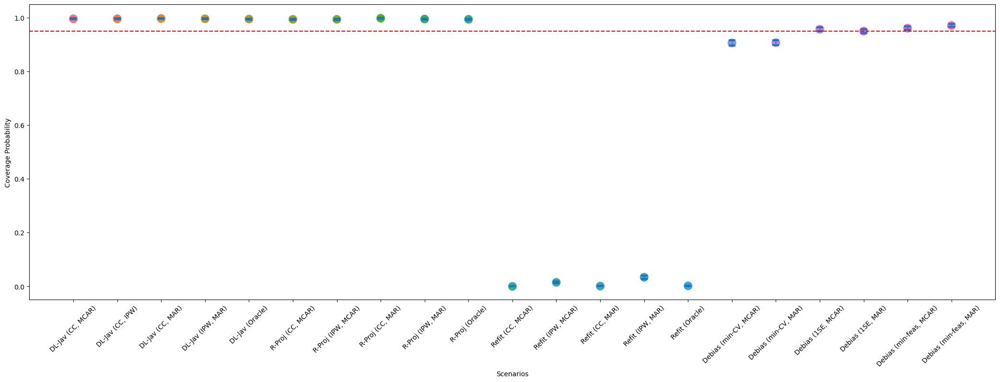

Scenario x2, beta2:



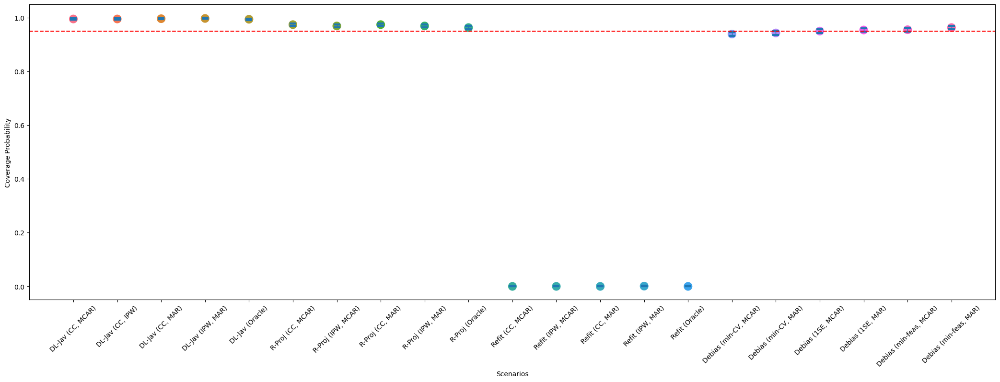

Scenario x3, beta0:



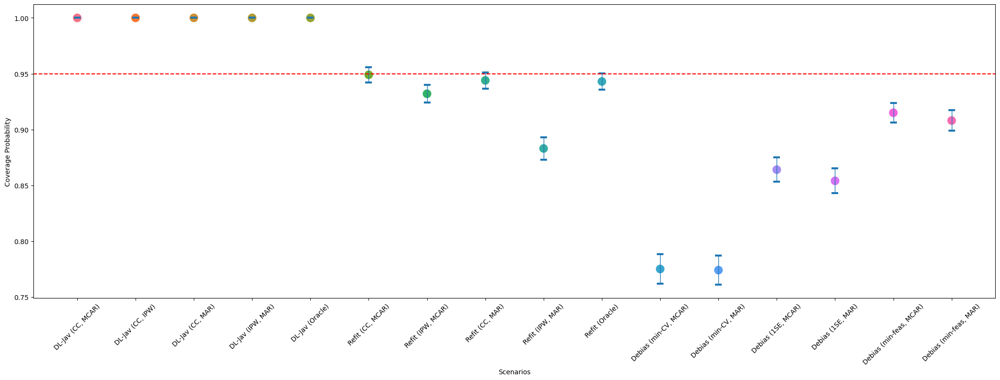

Scenario x3, beta1:



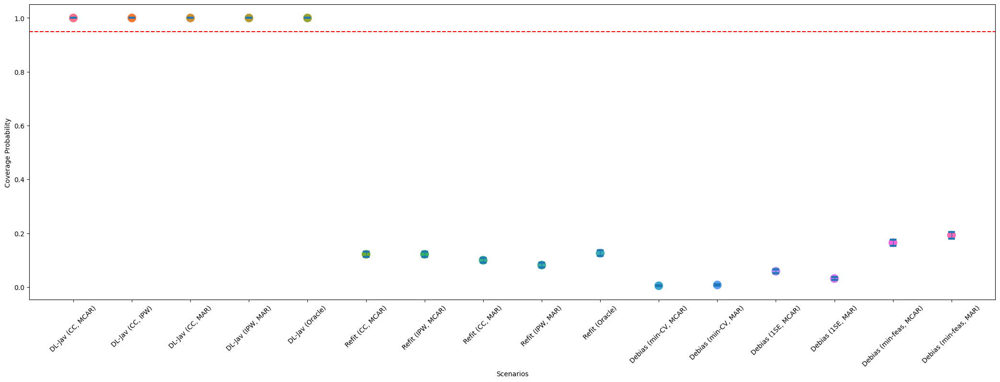

Scenario x3, beta2:



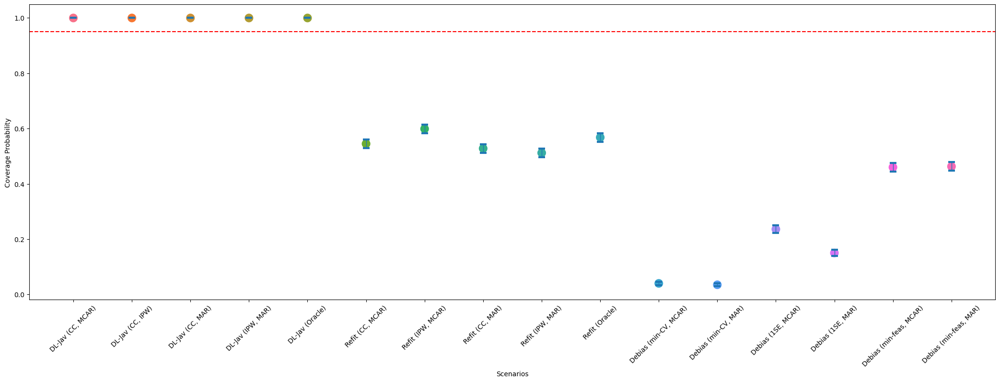

Scenario x4, beta0:



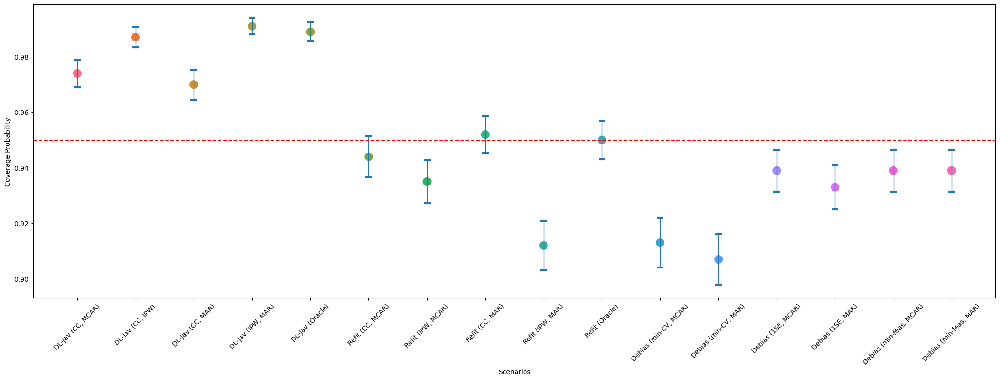

Scenario x4, beta1:



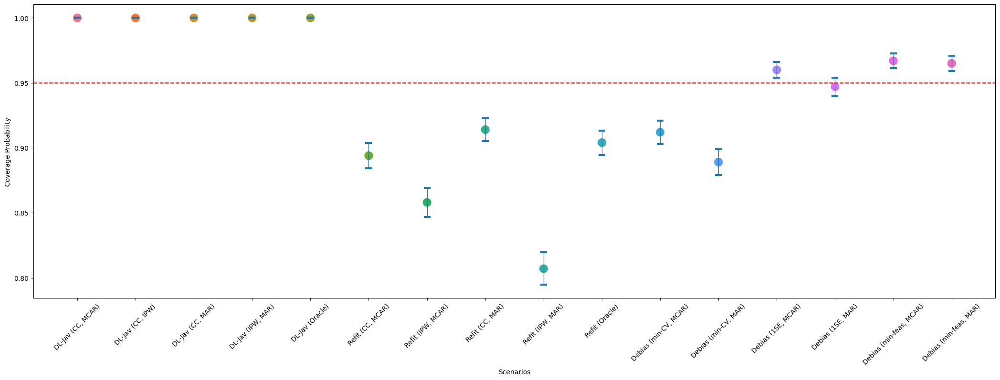

Scenario x4, beta2:



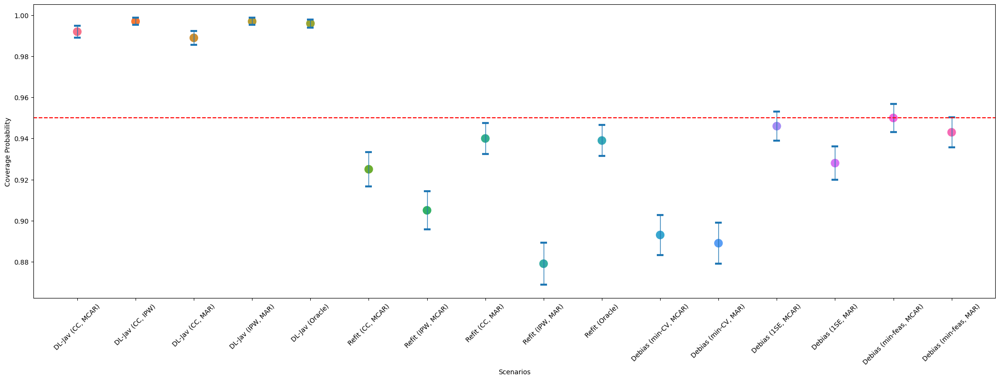

In [9]:
d = 1000
n= 900
B_repeat = 1000
for i in range(5):
    if i == 0:
        ## x0
        x = np.zeros((d,))
        x[0] = 1
    if i == 1:
        ## x1
        x = np.zeros((d,))
        x[0] = 1
        x[1] = 1/2
        x[2] = 1/4
        x[6] = 1/2
        x[7] = 1/8
    if i == 2:
        ## x2
        x = np.zeros((d,))
        x[99] = 1
    if i == 3:
        ## x3
        x = 1/np.linspace(1, d, d)
    if i == 4:
        ## x4
        x = 1/np.linspace(1, d, d)**2
    for k in range(3):
        if k == 0:
            s_beta = 5
            beta_0 = np.zeros((d,))
            beta_0[:s_beta] = np.sqrt(5)
        if k == 1:
            beta_0 = 1/np.sqrt(np.linspace(1, d, d))
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)
        if k == 2:
            beta_0 = 1/np.linspace(1, d, d)
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)

        # True regression function
        m_true = np.dot(x, beta_0)
        
        print('Scenario x'+str(i)+', beta'+str(k)+':\n')
        
        
        debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr.csv')
        refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr.csv')
        deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr_1se.csv')
        deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr_mincv.csv')
        deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr_minfeas.csv')
        if (i == 0) or (i == 2):
            rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr.csv')
        
        
        # Coverage Probability
        ## Debiased lasso (Javanmard and Montarani, 2014)
        cov_prob = (debl_res1['m_obs1'] + debl_res1['ci_len_obs1']/2 >= m_true) & \
        (debl_res1['m_obs1'] - debl_res1['ci_len_obs1']/2 <= m_true)
        Cov_prob1 = pd.DataFrame({'Scenarios': ['DL-Jav (CC, MCAR)'], 
                                  'Coverage Probability': [np.mean(cov_prob)], 
                                  'Std': [np.std(cov_prob)], 
                                  'StdErr': [np.std(cov_prob)/np.sqrt(1000)]})
        
        cov_prob = (debl_res1['m_ipw1'] + debl_res1['ci_len_ipw1']/2 >= m_true) & \
        (debl_res1['m_ipw1'] - debl_res1['ci_len_ipw1']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['DL-Jav (CC, IPW)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (debl_res1['m_obs2'] + debl_res1['ci_len_obs2']/2 >= m_true) & \
        (debl_res1['m_obs2'] - debl_res1['ci_len_obs2']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['DL-Jav (CC, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (debl_res1['m_ipw2'] + debl_res1['ci_len_ipw2']/2 >= m_true) & \
        (debl_res1['m_ipw2'] - debl_res1['ci_len_ipw2']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['DL-Jav (IPW, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (debl_res1['m_full'] + debl_res1['ci_len_full']/2 >= m_true) & \
        (debl_res1['m_full'] - debl_res1['ci_len_full']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['DL-Jav (Oracle)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        ## Ridge projection
        if (i == 0) or (i == 2):
            cov_prob = (rproj_res1['m_obs1'] + rproj_res1['ci_len_obs1']/2 >= m_true) & \
            (rproj_res1['m_obs1'] - rproj_res1['ci_len_obs1']/2 <= m_true)
            Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (CC, MCAR)', np.mean(cov_prob), 
                                                   np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
            
            cov_prob = (rproj_res1['m_ipw1'] + rproj_res1['ci_len_ipw1']/2 >= m_true) & \
            (rproj_res1['m_ipw1'] - rproj_res1['ci_len_ipw1']/2 <= m_true)
            Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (IPW, MCAR)', np.mean(cov_prob), 
                                                   np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
            
            cov_prob = (rproj_res1['m_obs2'] + rproj_res1['ci_len_obs2']/2 >= m_true) & \
            (rproj_res1['m_obs2'] - rproj_res1['ci_len_obs2']/2 <= m_true)
            Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (CC, MAR)', np.mean(cov_prob), 
                                                   np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
            
            cov_prob = (rproj_res1['m_ipw2'] + rproj_res1['ci_len_ipw2']/2 >= m_true) & \
            (rproj_res1['m_ipw2'] - rproj_res1['ci_len_ipw2']/2 <= m_true)
            Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (IPW, MAR)', np.mean(cov_prob), 
                                                   np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
            
            cov_prob = (rproj_res1['m_full'] + rproj_res1['ci_len_full']/2 >= m_true) & \
            (rproj_res1['m_full'] - rproj_res1['ci_len_full']/2 <= m_true)
            Cov_prob1.loc[len(Cov_prob1.index)] = ['R-Proj (Oracle)', np.mean(cov_prob), 
                                                   np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        ## Lasso refitting
        cov_prob = (refit_res1['m_obs1'] + refit_res1['ci_len_obs1']/2 >= m_true) & \
        (refit_res1['m_obs1'] - refit_res1['ci_len_obs1']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (CC, MCAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (refit_res1['m_ipw1'] + refit_res1['ci_len_ipw1']/2 >= m_true) & \
        (refit_res1['m_ipw1'] - refit_res1['ci_len_ipw1']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (IPW, MCAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (refit_res1['m_obs2'] + refit_res1['ci_len_obs2']/2 >= m_true) & \
        (refit_res1['m_obs2'] - refit_res1['ci_len_obs2']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (CC, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (refit_res1['m_ipw2'] + refit_res1['ci_len_ipw2']/2 >= m_true) & \
        (refit_res1['m_ipw2'] - refit_res1['ci_len_ipw2']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (IPW, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (refit_res1['m_full'] + refit_res1['ci_len_full']/2 >= m_true) & \
        (refit_res1['m_full'] - refit_res1['ci_len_full']/2 <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Refit (Oracle)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        # Proposed framework   
        cov_prob = (deb_est_mincv['m_deb1'] + deb_est_mincv['asym_se1']*deb_est_mincv['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_mincv['m_deb1'] - deb_est_mincv['asym_se1']*deb_est_mincv['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (min-CV, MCAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (deb_est_mincv['m_deb2'] + deb_est_mincv['asym_se2']*deb_est_mincv['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_mincv['m_deb2'] - deb_est_mincv['asym_se2']*deb_est_mincv['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (min-CV, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (deb_est_1se['m_deb1'] + deb_est_1se['asym_se1']*deb_est_1se['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_1se['m_deb1'] - deb_est_1se['asym_se1']*deb_est_1se['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (1SE, MCAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (deb_est_1se['m_deb2'] + deb_est_1se['asym_se2']*deb_est_1se['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_1se['m_deb2'] - deb_est_1se['asym_se2']*deb_est_1se['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (1SE, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (deb_est_minfeas['m_deb1'] + deb_est_minfeas['asym_se1']*deb_est_minfeas['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_minfeas['m_deb1'] - deb_est_minfeas['asym_se1']*deb_est_minfeas['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (min-feas, MCAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        cov_prob = (deb_est_minfeas['m_deb2'] + deb_est_minfeas['asym_se2']*deb_est_minfeas['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) >= m_true) & \
        (deb_est_minfeas['m_deb2'] - deb_est_minfeas['asym_se2']*deb_est_minfeas['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2) <= m_true)
        Cov_prob1.loc[len(Cov_prob1.index)] = ['Debias (min-feas, MAR)', np.mean(cov_prob), 
                                               np.std(cov_prob), np.std(cov_prob)/np.sqrt(1000)]
        
        plt.figure(figsize=(26,8))
        sns.scatterplot(x='Scenarios', y='Coverage Probability', data=Cov_prob1, hue='Scenarios', 
                        s=200, legend=False)
        # sns.pointplot(x='Scenarios', y='Coverage Probability', errorbar='sd', data=Cov_prob1, hue='Scenarios')
        # plt.scatter(Cov_prob1['Scenarios'], Cov_prob1['Coverage Probability'])
        plt.errorbar(Cov_prob1['Scenarios'], Cov_prob1['Coverage Probability'], 
                     yerr=Cov_prob1['StdErr'], ls='none', capsize=5, elinewidth=1, capthick=3)
        plt.axhline(y=0.95, color='red', linestyle='dashed')
        plt.xticks(rotation=45)
        plt.show()

### Lengths of Confidence Intervals (t-distributed noise)

Scenario x0, beta0:



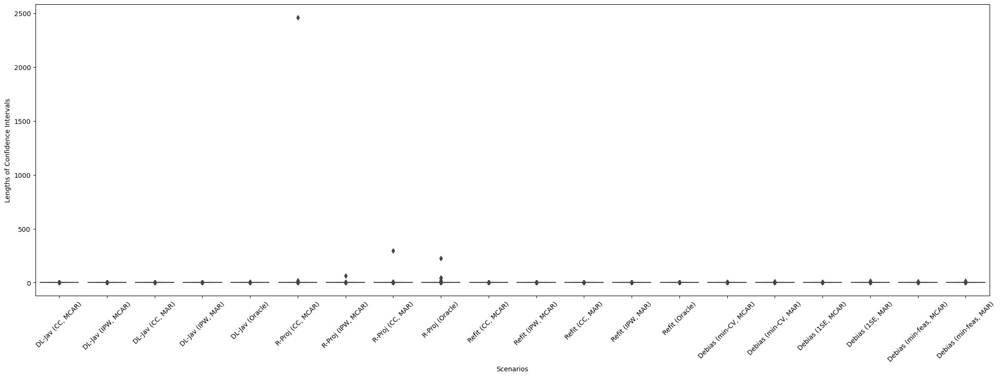

Scenario x0, beta1:



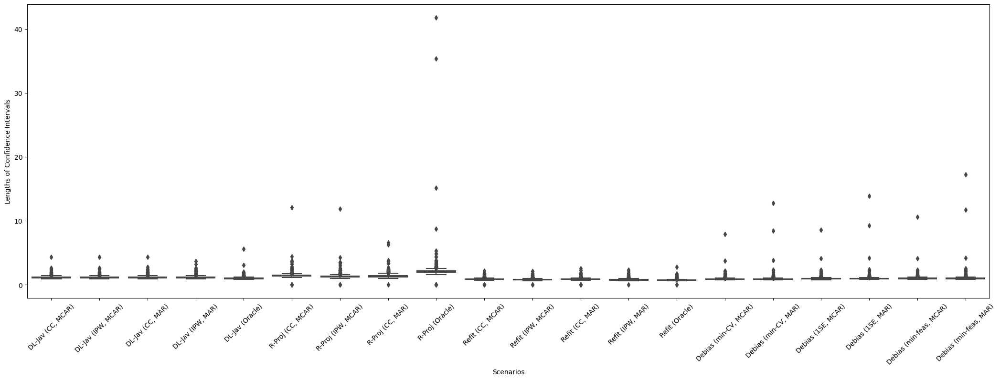

Scenario x0, beta2:



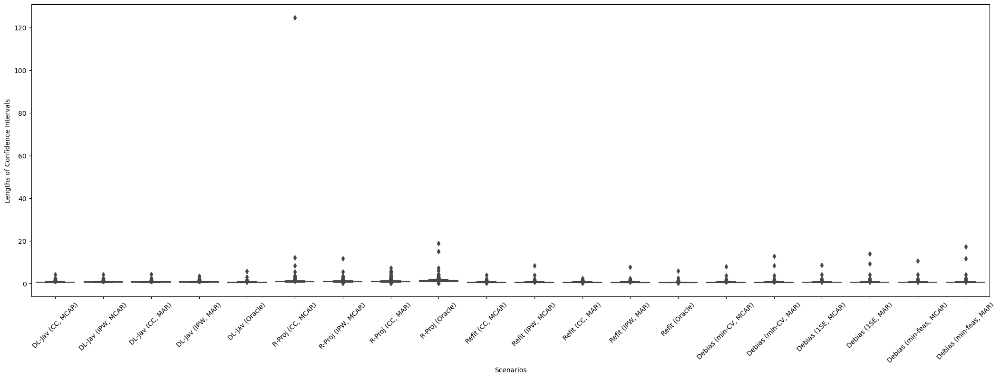

Scenario x1, beta0:



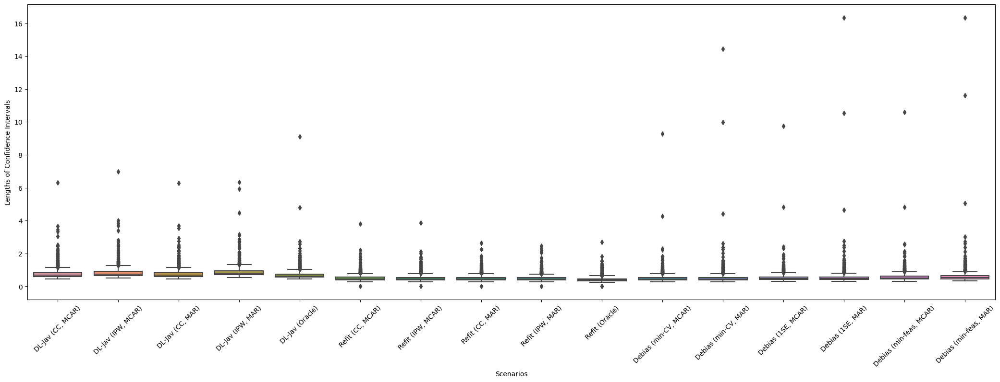

Scenario x1, beta1:



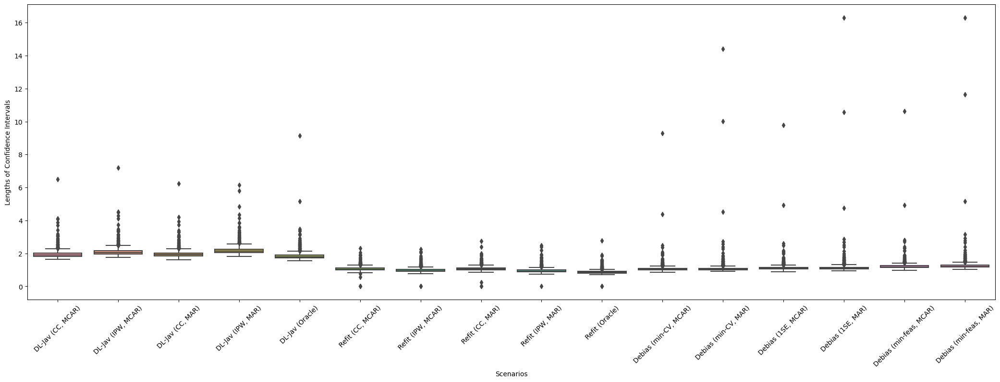

Scenario x1, beta2:



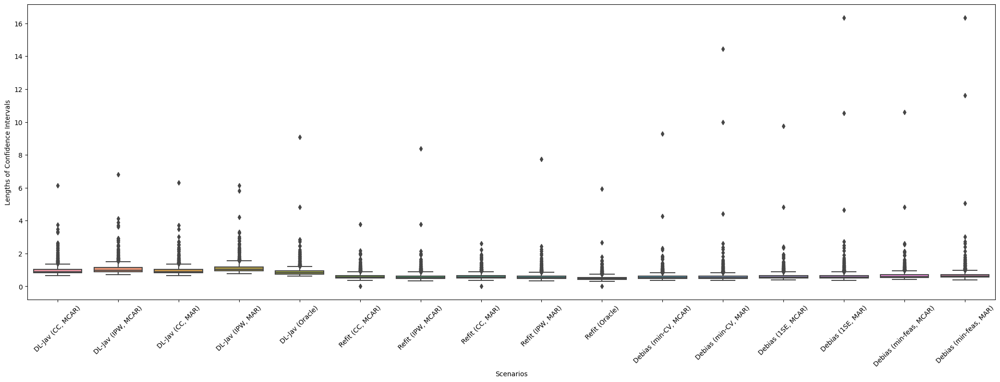

Scenario x2, beta0:



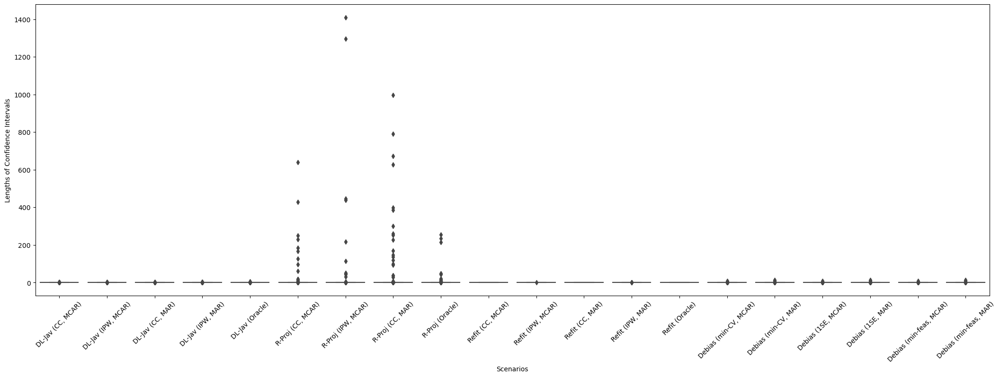

Scenario x2, beta1:



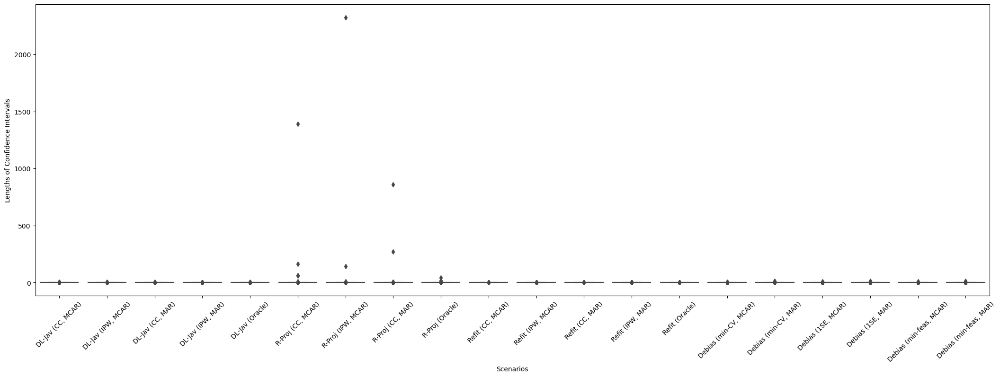

Scenario x2, beta2:



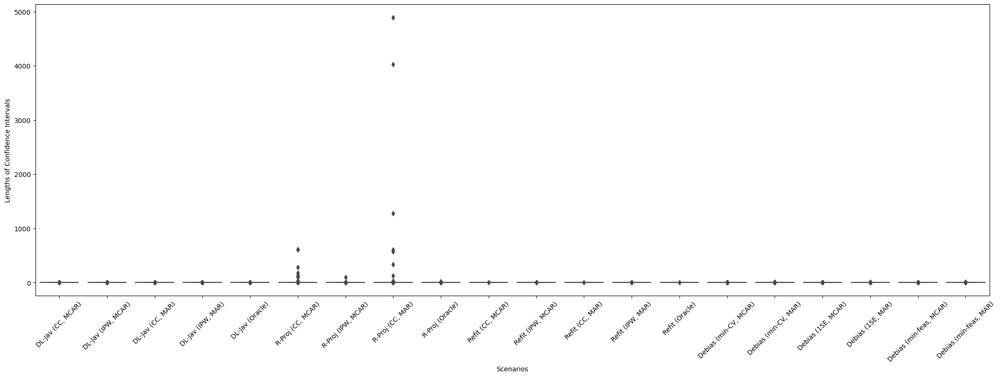

Scenario x3, beta0:



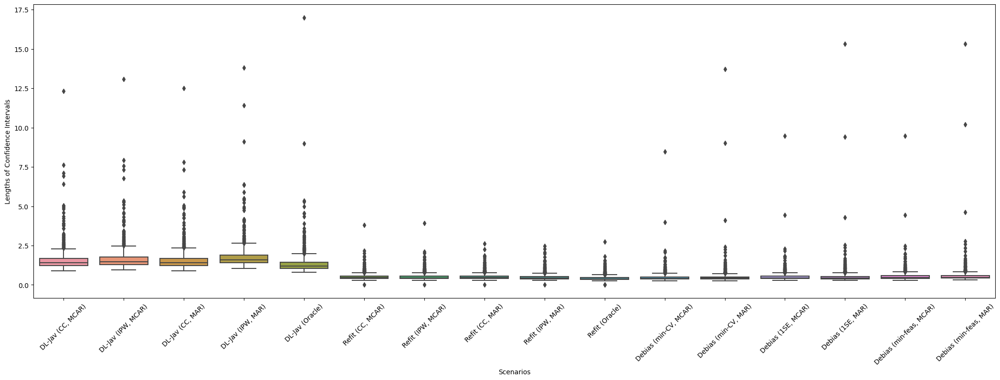

Scenario x3, beta1:



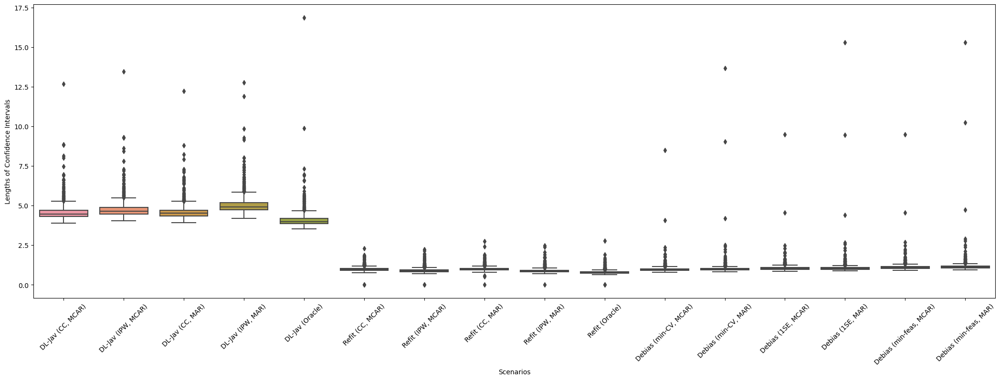

Scenario x3, beta2:



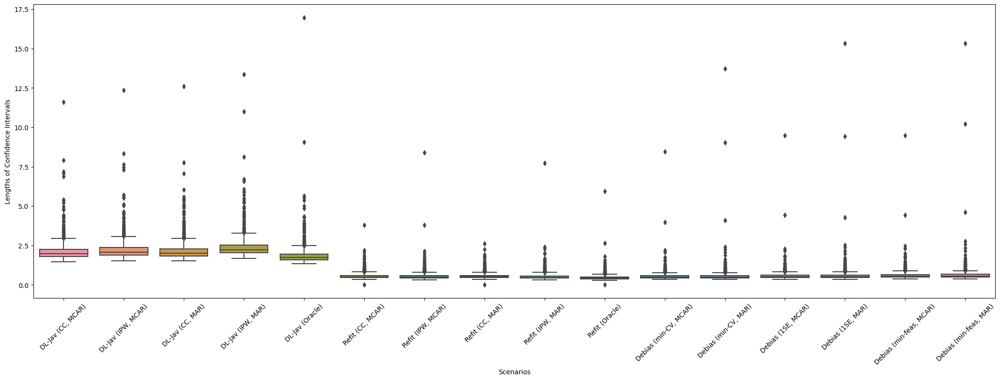

Scenario x4, beta0:



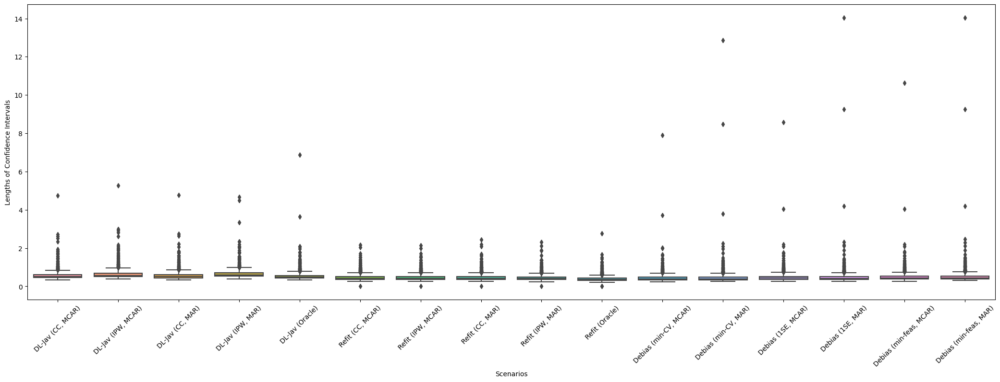

Scenario x4, beta1:



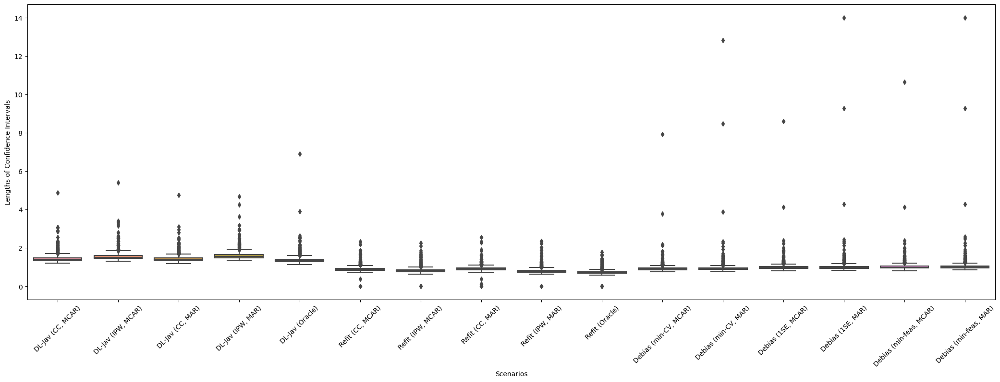

Scenario x4, beta2:



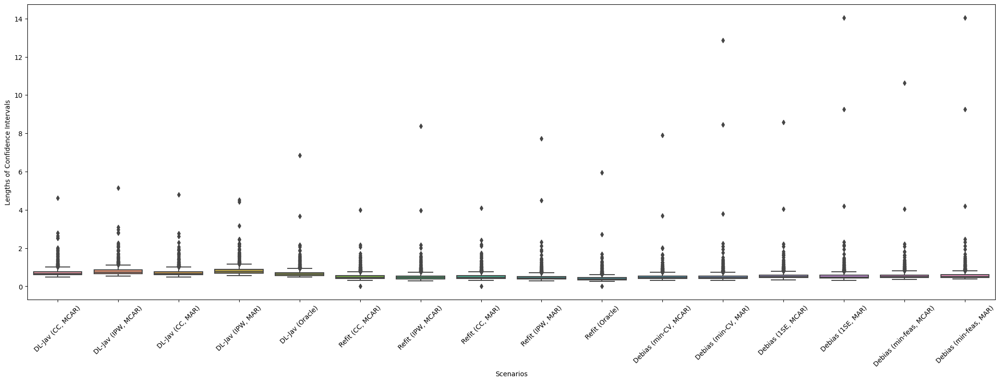

In [11]:
d = 1000
n= 900
B_repeat = 1000
for i in range(5):
    if i == 0:
        ## x0
        x = np.zeros((d,))
        x[0] = 1
    if i == 1:
        ## x1
        x = np.zeros((d,))
        x[0] = 1
        x[1] = 1/2
        x[2] = 1/4
        x[6] = 1/2
        x[7] = 1/8
    if i == 2:
        ## x2
        x = np.zeros((d,))
        x[99] = 1
    if i == 3:
        ## x3
        x = 1/np.linspace(1, d, d)
    if i == 4:
        ## x4
        x = 1/np.linspace(1, d, d)**2
    for k in range(3):
        if k == 0:
            s_beta = 5
            beta_0 = np.zeros((d,))
            beta_0[:s_beta] = np.sqrt(5)
        if k == 1:
            beta_0 = 1/np.sqrt(np.linspace(1, d, d))
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)
        if k == 2:
            beta_0 = 1/np.linspace(1, d, d)
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)

        # True regression function
        m_true = np.dot(x, beta_0)
        
        print('Scenario x'+str(i)+', beta'+str(k)+':\n')
        
        
        debl_res1 = pd.read_csv('./Results/debl_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr.csv')
        refit_res1 = pd.read_csv('./Results/refit_Cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr.csv')
        deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr_1se.csv')
        deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr_mincv.csv')
        deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr_minfeas.csv')
        if (i == 0) or (i == 2):
            rproj_res1 = pd.read_csv('./Results/rproj_cirsym_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr.csv')
        
        # Lengths of confidence intervals
        ## Debiased lasso (Javanmard and Montarani, 2014)
        CIlen_df = pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_obs1'], 
                                'Scenarios': np.repeat('DL-Jav (CC, MCAR)', B_repeat)})
        CIlen_df = pd.concat([CIlen_df, 
                             pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_ipw1'], 
                                           'Scenarios': np.repeat('DL-Jav (IPW, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                             pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_obs2'], 
                                           'Scenarios': np.repeat('DL-Jav (CC, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                             pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_ipw2'], 
                                           'Scenarios': np.repeat('DL-Jav (IPW, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                             pd.DataFrame({'Lengths of Confidence Intervals': debl_res1['ci_len_full'], 
                                           'Scenarios': np.repeat('DL-Jav (Oracle)', B_repeat)})], axis=0)
        
        ## Ridge projection
        if (i == 0) or (i == 2):
            CIlen_df = pd.concat([CIlen_df, 
                                  pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_obs1'], 
                                               'Scenarios': np.repeat('R-Proj (CC, MCAR)', B_repeat)})], axis=0)
            CIlen_df = pd.concat([CIlen_df, 
                                  pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_ipw1'], 
                                               'Scenarios': np.repeat('R-Proj (IPW, MCAR)', B_repeat)})], axis=0)
            CIlen_df = pd.concat([CIlen_df, 
                                  pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_obs2'], 
                                               'Scenarios': np.repeat('R-Proj (CC, MAR)', B_repeat)})], axis=0)
            CIlen_df = pd.concat([CIlen_df, 
                                  pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_ipw2'], 
                                               'Scenarios': np.repeat('R-Proj (CC, MAR)', B_repeat)})], axis=0)
            CIlen_df = pd.concat([CIlen_df, 
                                  pd.DataFrame({'Lengths of Confidence Intervals': rproj_res1['ci_len_full'], 
                                               'Scenarios': np.repeat('R-Proj (Oracle)', B_repeat)})], axis=0)
        
        ## Lasso refitting
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_obs1'], 
                                            'Scenarios': np.repeat('Refit (CC, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_ipw1'], 
                                            'Scenarios': np.repeat('Refit (IPW, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_obs2'], 
                                            'Scenarios': np.repeat('Refit (CC, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_ipw2'], 
                                            'Scenarios': np.repeat('Refit (IPW, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': refit_res1['ci_len_full'], 
                                            'Scenarios': np.repeat('Refit (Oracle)', B_repeat)})], axis=0)
        
        ## Proposed debiasing framework
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_mincv['asym_se1']*deb_est_mincv['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (min-CV, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_mincv['asym_se2']*deb_est_mincv['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (min-CV, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_1se['asym_se1']*deb_est_1se['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (1SE, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_1se['asym_se2']*deb_est_1se['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (1SE, MAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_minfeas['asym_se1']*deb_est_minfeas['sigma_hat1']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (min-feas, MCAR)', B_repeat)})], axis=0)
        CIlen_df = pd.concat([CIlen_df, 
                              pd.DataFrame({'Lengths of Confidence Intervals': 2*deb_est_minfeas['asym_se2']*deb_est_minfeas['sigma_hat2']*scipy.stats.norm.ppf(1-0.05/2), 
                                            'Scenarios': np.repeat('Debias (min-feas, MAR)', B_repeat)})], axis=0)
        
        plt.figure(figsize=(26, 8))
        sns.boxplot(y='Lengths of Confidence Intervals', x='Scenarios', data=CIlen_df)
        plt.xticks(rotation=45)
        plt.show()

### Asymptotic Normality of Our Debiased Estimator (t-distributed noise)

Scenario x0, beta0:



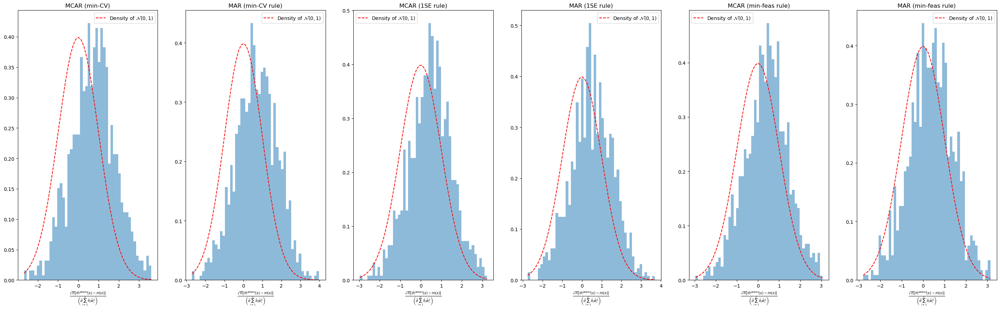

Scenario x0, beta1:



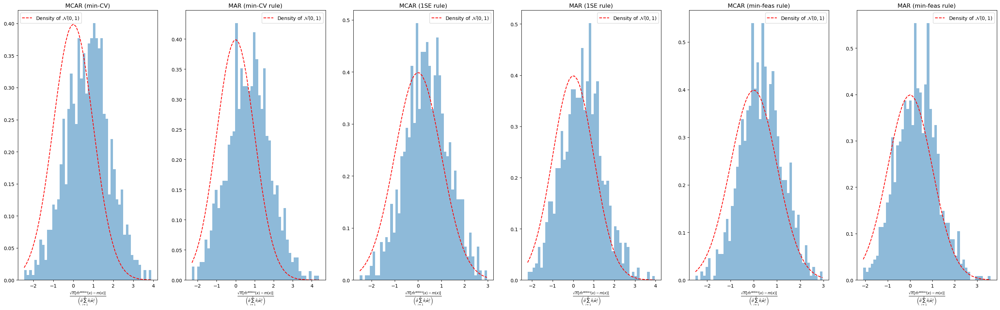

Scenario x0, beta2:



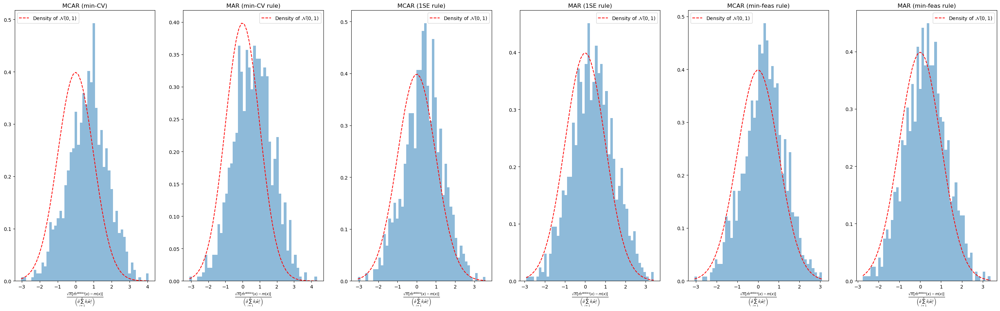

Scenario x1, beta0:



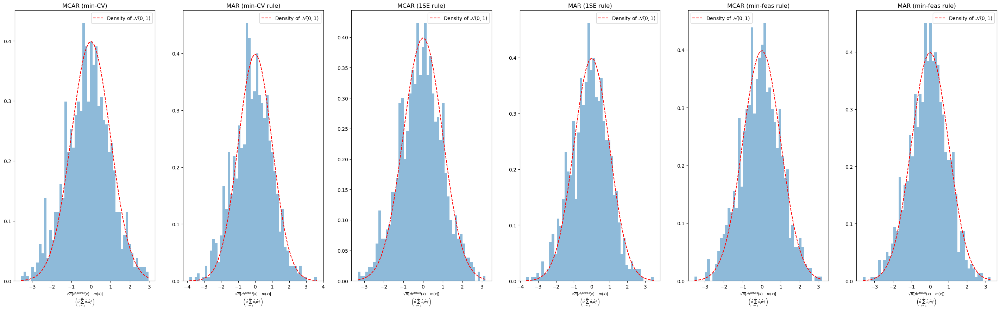

Scenario x1, beta1:



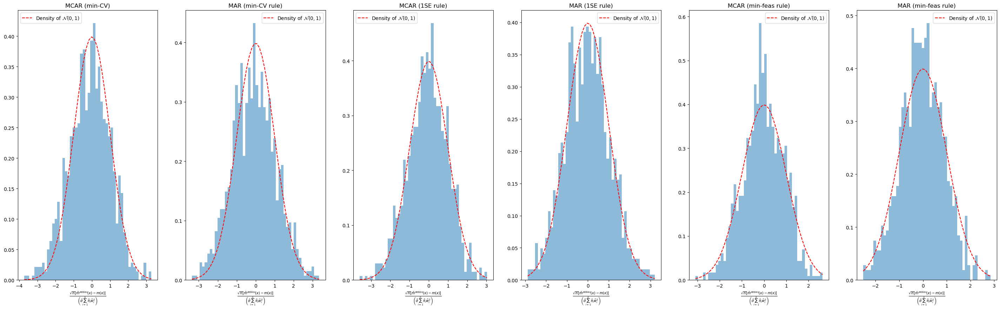

Scenario x1, beta2:



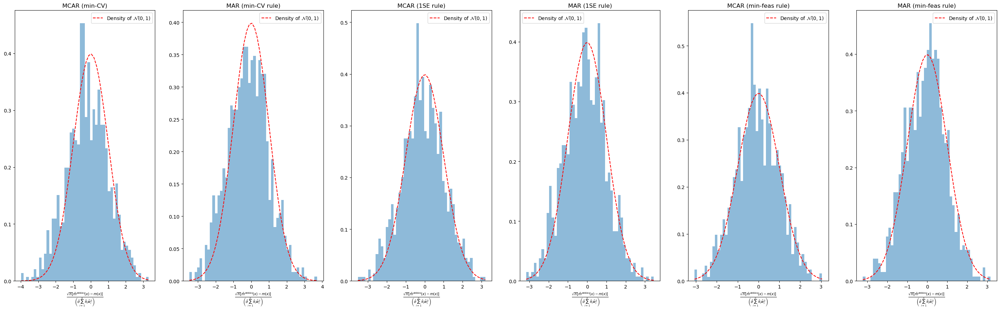

Scenario x2, beta0:



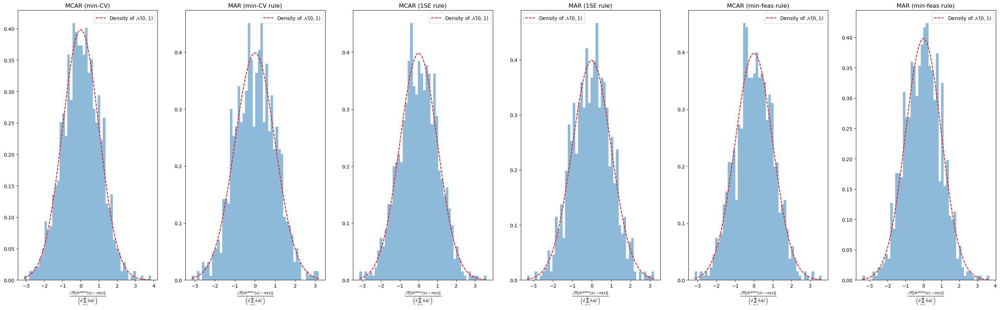

Scenario x2, beta1:



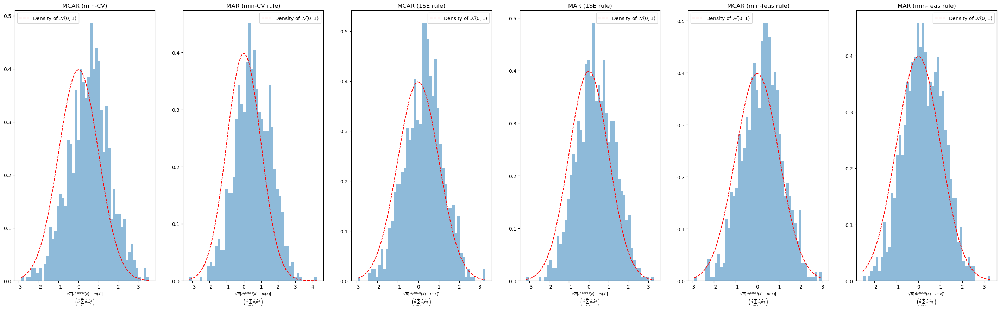

Scenario x2, beta2:



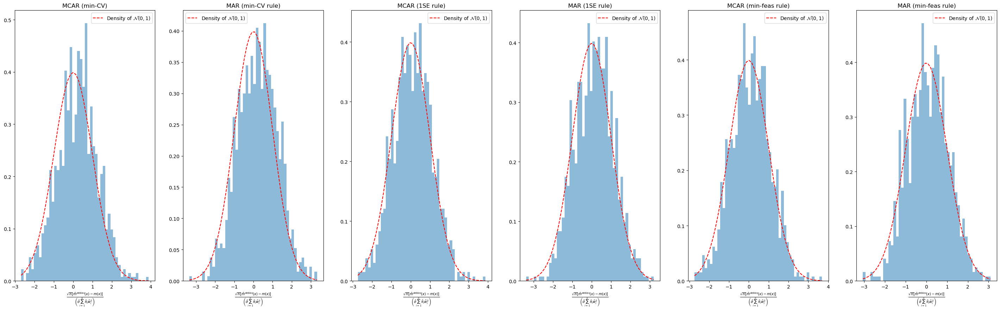

Scenario x3, beta0:



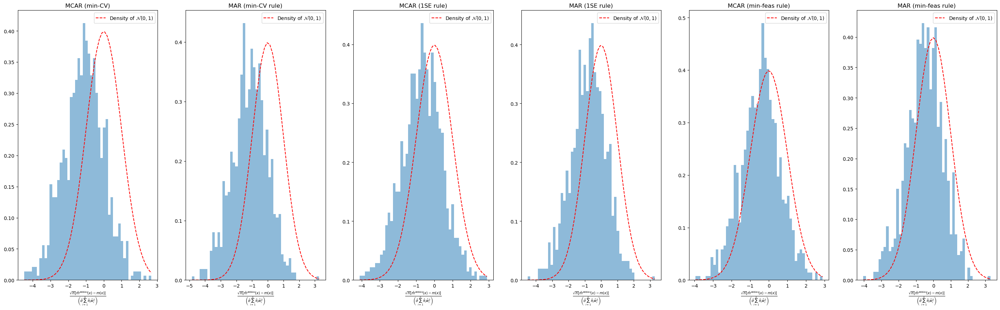

Scenario x3, beta1:



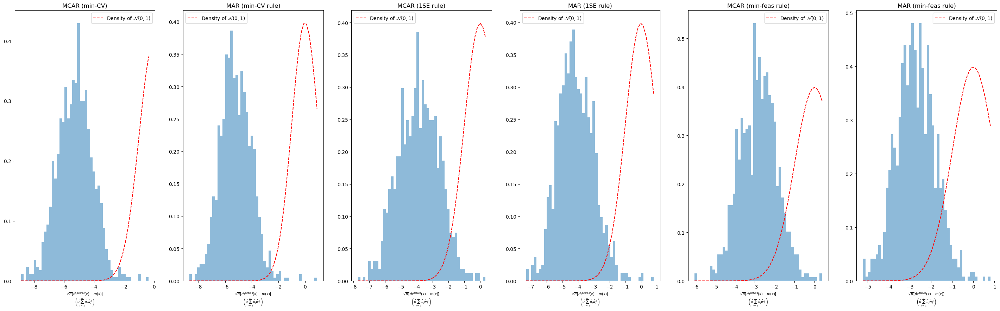

Scenario x3, beta2:



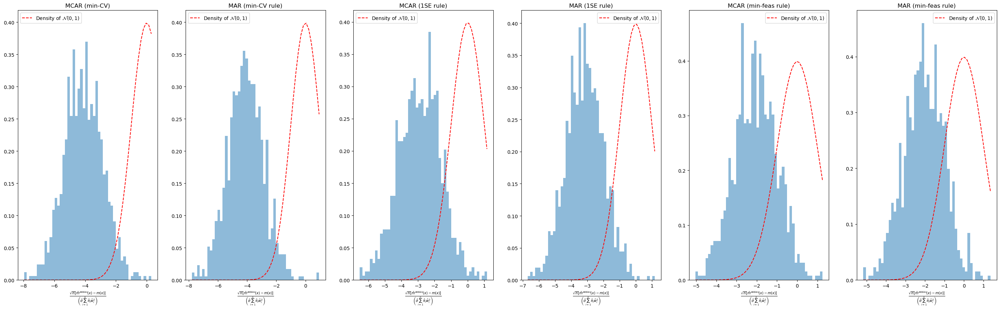

Scenario x4, beta0:



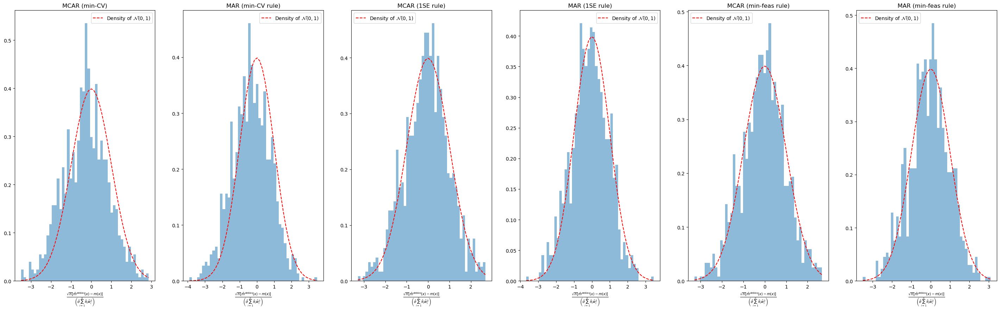

Scenario x4, beta1:



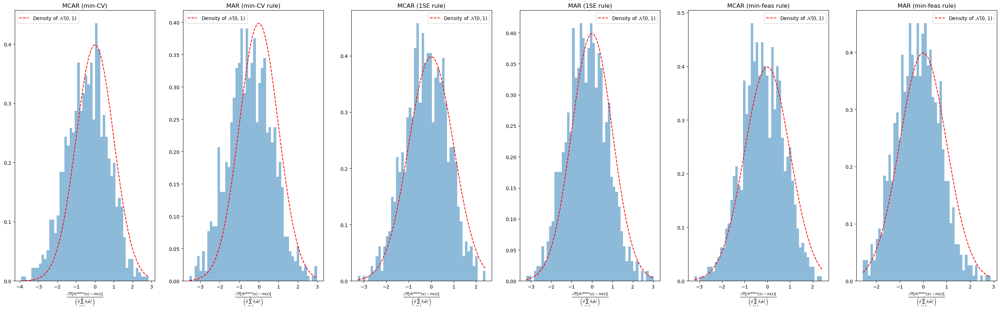

Scenario x4, beta2:



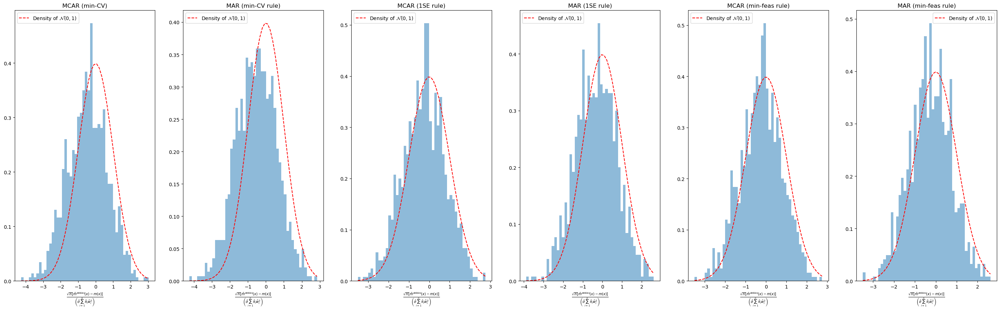

In [12]:
d = 1000
n= 900
for i in range(5):
    if i == 0:
        ## x0
        x = np.zeros((d,))
        x[0] = 1
    if i == 1:
        ## x1
        x = np.zeros((d,))
        x[0] = 1
        x[1] = 1/2
        x[2] = 1/4
        x[6] = 1/2
        x[7] = 1/8
    if i == 2:
        ## x2
        x = np.zeros((d,))
        x[99] = 1
    if i == 3:
        ## x3
        x = 1/np.linspace(1, d, d)
    if i == 4:
        ## x4
        x = 1/np.linspace(1, d, d)**2
    for k in range(3):
        if k == 0:
            s_beta = 5
            beta_0 = np.zeros((d,))
            beta_0[:s_beta] = np.sqrt(5)
        if k == 1:
            beta_0 = 1/np.sqrt(np.linspace(1, d, d))
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)
        if k == 2:
            beta_0 = 1/np.linspace(1, d, d)
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)

        # True regression function
        m_true = np.dot(x, beta_0)
        
        deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr_1se.csv')
        deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr_mincv.csv')
        deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr_minfeas.csv')
        
        print('Scenario x'+str(i)+', beta'+str(k)+':\n')
        
        plt.figure(figsize=(36,10))
        plt.subplot(161)
        plt.hist((deb_est_mincv['m_deb1'] - m_true)/(deb_est_mincv['asym_se1'] * deb_est_mincv['sigma_hat1']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_mincv['m_deb1'] - m_true)/(deb_est_mincv['asym_se1'] * deb_est_mincv['sigma_hat1'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MCAR (min-CV)')
        
        plt.subplot(162)
        plt.hist((deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MAR (min-CV rule)')
        
        plt.subplot(163)
        plt.hist((deb_est_1se['m_deb1'] - m_true)/(deb_est_1se['asym_se1'] * deb_est_1se['sigma_hat1']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_1se['m_deb1'] - m_true)/(deb_est_1se['asym_se1'] * deb_est_1se['sigma_hat1'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MCAR (1SE rule)')
        
        plt.subplot(164)
        plt.hist((deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MAR (1SE rule)')
        
        plt.subplot(165)
        plt.hist((deb_est_minfeas['m_deb1'] - m_true)/(deb_est_minfeas['asym_se1'] * deb_est_minfeas['sigma_hat1']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_minfeas['m_deb1'] - m_true)/(deb_est_minfeas['asym_se1'] * deb_est_minfeas['sigma_hat1'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MCAR (min-feas rule)')
        
        plt.subplot(166)
        plt.hist((deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2']), bins=50, 
                 density=True, alpha=0.5)
        pts = (deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2'])
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, scipy.stats.norm.pdf(x_range, 0, 1), color='red', linestyle='dashed', 
                 label='Density of $\mathcal{N}(0,1)$')
        plt.xlabel(r'$\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.legend()
        plt.title('MAR (min-feas rule)')
        plt.show()

Scenario x0, beta0:



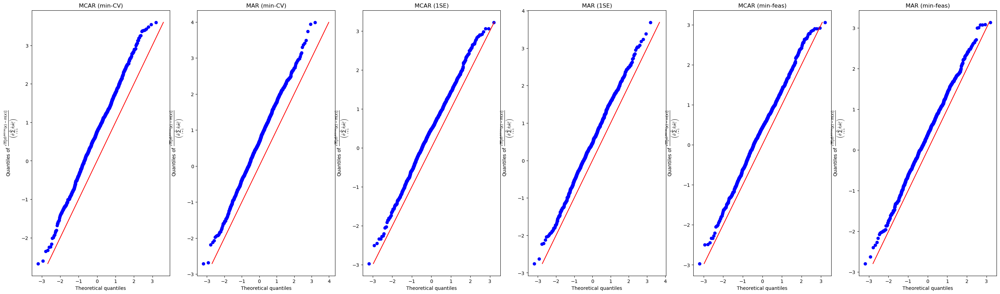

Scenario x0, beta1:



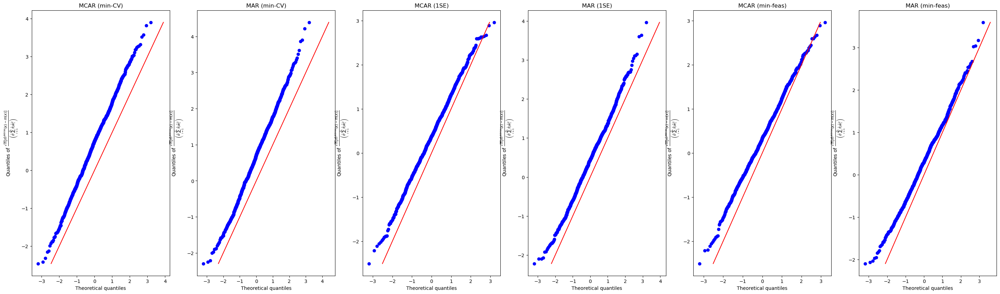

Scenario x0, beta2:



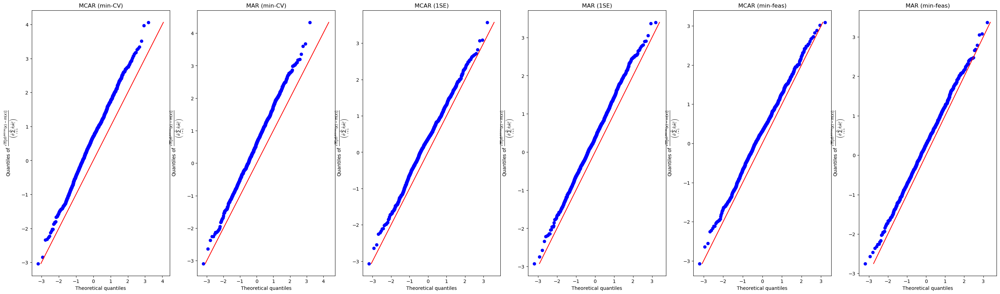

Scenario x1, beta0:



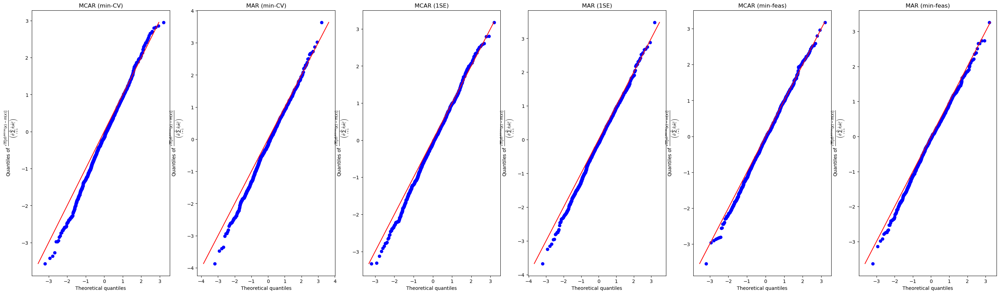

Scenario x1, beta1:



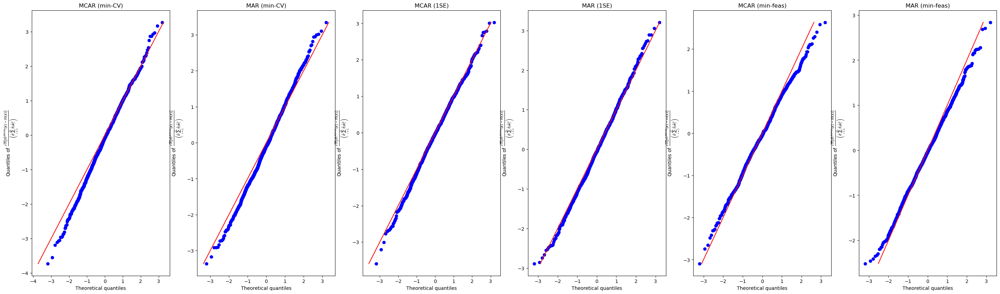

Scenario x1, beta2:



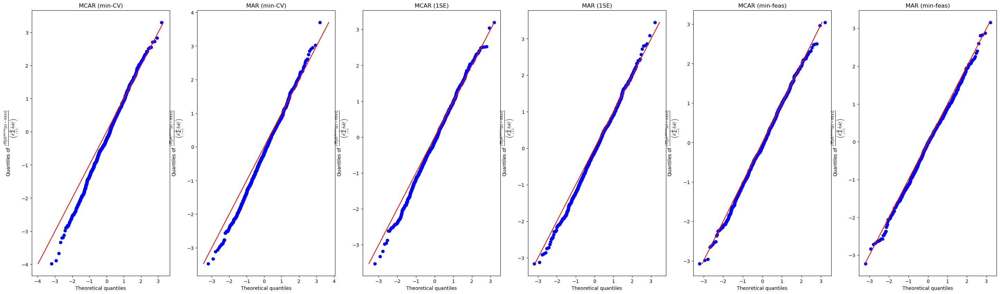

Scenario x2, beta0:



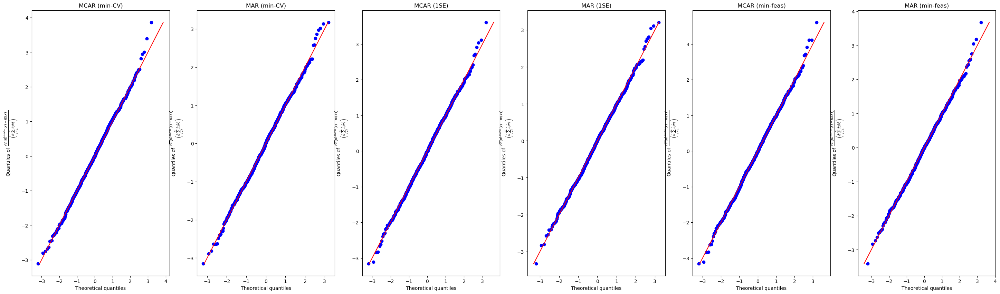

Scenario x2, beta1:



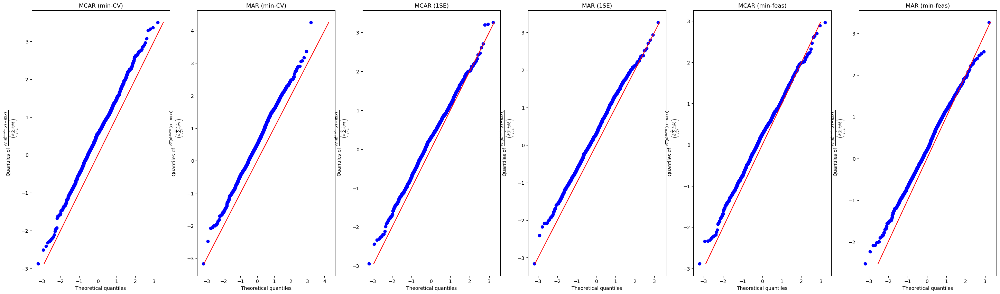

Scenario x2, beta2:



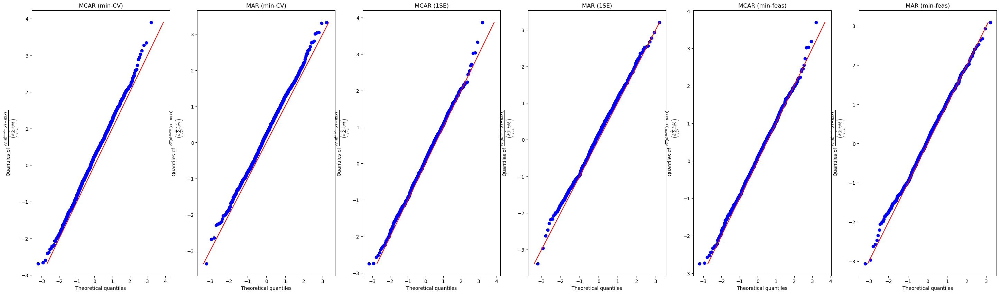

Scenario x3, beta0:



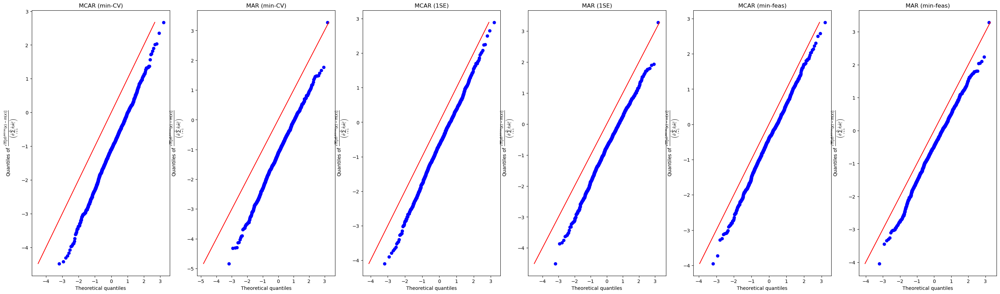

Scenario x3, beta1:



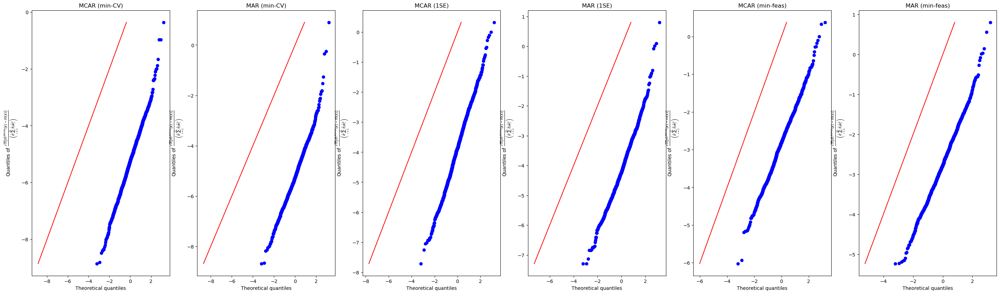

Scenario x3, beta2:



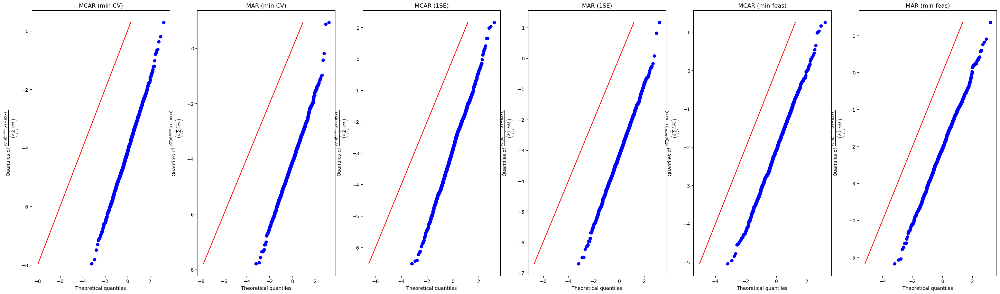

Scenario x4, beta0:



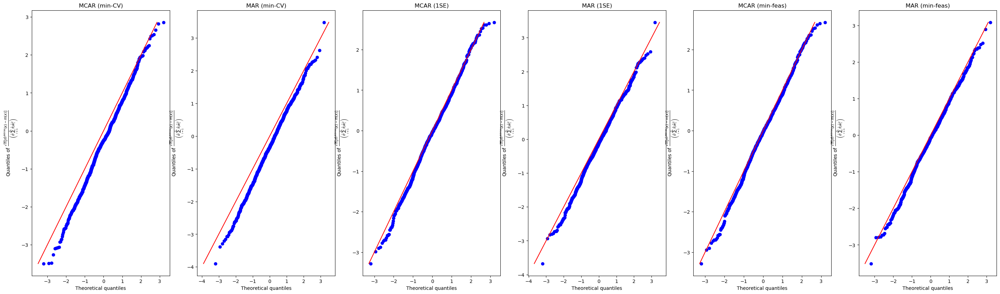

Scenario x4, beta1:



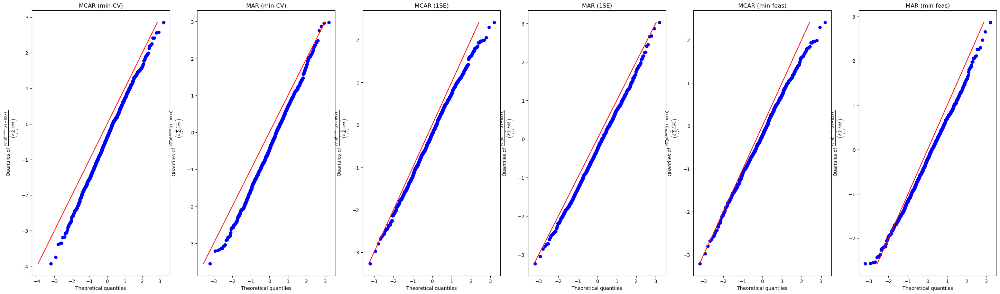

Scenario x4, beta2:



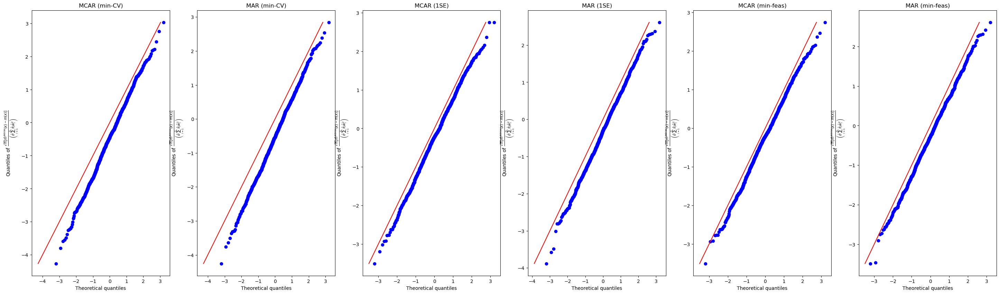

In [13]:
d = 1000
n= 900
for i in range(5):
    if i == 0:
        ## x0
        x = np.zeros((d,))
        x[0] = 1
    if i == 1:
        ## x1
        x = np.zeros((d,))
        x[0] = 1
        x[1] = 1/2
        x[2] = 1/4
        x[6] = 1/2
        x[7] = 1/8
    if i == 2:
        ## x2
        x = np.zeros((d,))
        x[99] = 1
    if i == 3:
        ## x3
        x = 1/np.linspace(1, d, d)
    if i == 4:
        ## x4
        x = 1/np.linspace(1, d, d)**2
    for k in range(3):
        if k == 0:
            s_beta = 5
            beta_0 = np.zeros((d,))
            beta_0[:s_beta] = np.sqrt(5)
        if k == 1:
            beta_0 = 1/np.sqrt(np.linspace(1, d, d))
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)
        if k == 2:
            beta_0 = 1/np.linspace(1, d, d)
            beta_0 = 5*beta_0/np.linalg.norm(beta_0)

        # True regression function
        m_true = np.dot(x, beta_0)
        
        deb_est_1se = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr_1se.csv')
        deb_est_mincv = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr_mincv.csv')
        deb_est_minfeas = pd.read_csv('./Results/DebiasProg_Cirsym_cov_homoerr_d'+str(d)+'_n'+str(n)+'_x'+str(i)+'_beta'+str(k)+'_terr_minfeas.csv')
        
        print('Scenario x'+str(i)+', beta'+str(k)+':\n')
        
        plt.figure(figsize=(36,10))
        plt.subplot(161)
        pts = (deb_est_mincv['m_deb1'] - m_true)/(deb_est_mincv['asym_se1'] * deb_est_mincv['sigma_hat1'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MCAR (min-CV)')
        
        plt.subplot(162)
        pts = (deb_est_mincv['m_deb2'] - m_true)/(deb_est_mincv['asym_se2'] * deb_est_mincv['sigma_hat2'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MAR (min-CV)')
        
        plt.subplot(163)
        pts = (deb_est_1se['m_deb1'] - m_true)/(deb_est_1se['asym_se1'] * deb_est_1se['sigma_hat1'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MCAR (1SE)')
        
        plt.subplot(164)
        pts = (deb_est_1se['m_deb2'] - m_true)/(deb_est_1se['asym_se2'] * deb_est_1se['sigma_hat2'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MAR (1SE)')
        
        plt.subplot(165)
        pts = (deb_est_minfeas['m_deb1'] - m_true)/(deb_est_minfeas['asym_se1'] * deb_est_minfeas['sigma_hat1'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MCAR (min-feas)')
        
        plt.subplot(166)
        pts = (deb_est_minfeas['m_deb2'] - m_true)/(deb_est_minfeas['asym_se2'] * deb_est_minfeas['sigma_hat2'])
        # sm.qqplot(pts, line='45')
        scipy.stats.probplot(pts, dist="norm", fit=False, plot=plt)
        x_range = np.linspace(np.min(pts), np.max(pts), 50)
        plt.plot(x_range, x_range, color='red')
        plt.ylabel(r'Quantiles of $\frac{\sqrt{n}\left[\hat{m}^{debias}(x) - m(x) \right]}{\left(\hat{\sigma} \sum_{i=1}^n \hat{\pi}_i \hat{w}_i^2\right)}$')
        plt.title('MAR (min-feas)')
        plt.show()

In [45]:
d = 1000
n = 900

Sigma = np.zeros((d,d)) + np.eye(d)
rho = 0.1
for i in range(d):
    for j in range(i+1, d):
        if (j < i+6) or (j > i+d-6):
            Sigma[i,j] = rho
            Sigma[j,i] = rho


a = np.linalg.inv(Sigma)

In [48]:
a[0,:]

array([ 1.07245534e+00, -5.20004434e-02, -6.41040744e-02, -7.45165742e-02,
       -8.28518576e-02, -8.88037424e-02,  3.12982935e-02,  2.60808218e-02,
        1.91959240e-02,  1.09134758e-02,  1.56652000e-03, -8.46298474e-03,
       -5.04319809e-03, -2.13999436e-03,  2.54596345e-05,  1.27074478e-03,
        1.46180026e-03,  5.20213687e-04, -4.80117421e-05, -2.93161958e-04,
       -2.94090492e-04, -1.52979325e-04,  1.12944299e-05,  7.08307676e-05,
        6.63575793e-05,  3.38164364e-05,  7.44280685e-07, -1.66635326e-05,
       -1.56133529e-05, -7.75304727e-06, -2.91671879e-07,  3.55890964e-06,
        3.69099492e-06,  1.84281200e-06,  8.80171725e-08, -7.94799222e-07,
       -8.38797277e-07, -4.44486818e-07, -2.98863815e-08,  1.79800567e-07,
        1.92300282e-07,  1.04310619e-07,  1.01155012e-08, -4.04090094e-08,
       -4.43705387e-08, -2.44802632e-08, -2.89225068e-09,  8.95878130e-09,
        1.02337772e-08,  5.76738236e-09,  7.88087759e-10, -1.99183050e-09,
       -2.34866906e-09, -